In [1]:
import csv
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os
import math
import numpy as np
import numpy.linalg as la
from PIL import Image

def perc_high(a):
    return np.percentile(a,q=90)

def perc_low(a):
    return np.percentile(a,q=10)

def load_fitness(filename):
    ids = []
    fits = []
    parents = []
    with open(filename) as file :
        csv_data = csv.reader(file,delimiter=',')
        for row in csv_data:
            ids.append(float(row[0]))
            fits.append(float(row[-2]))
            parents.append(int(row[1]))
    return ids, fits, parents

def find_index(_id,ids):
    for i in range(len(ids)):
        if(ids[i] == _id):
            return i

def compute_gen_rec(par_id,ids,parents):
    if(par_id == -1):
        return 0
    for i, id in zip(range(len(ids)),ids):
        if(par_id == id):
            return compute_gen_rec(parents[i],ids,parents) + 1

def compute_generation(ids,parents):
    generation = [0 for _ in range(len(ids))]
    for i in range(len(ids)):
        generation[i] = compute_gen_rec(parents[i],ids,parents)
    return generation

def load_descriptor(filename) :
    '''
    Load a list of descriptor from a file
    Trait descriptor: <width,depth,height,voxels,wheels,sensor,joint,caster>
    '''
    with open(filename) as file :
        csv_data = csv.reader(file,delimiter=',')
        descriptors = []
        for row in csv_data :
            desc = []
            for i in range(len(row)-1) :
                desc.append(float(row[i]))
            descriptors.append(desc)
        return descriptors
    
def load_controller_archive(filename):
    lines = []
    with open(filename) as file :
        csv_data = csv.reader(file,delimiter=',')
        coord = [0]*3
        state = 0
        nbr_param = 0
        i=0
        for row in csv_data:
            if(len(row) == 3):
                coord[0] = int(row[0])
                coord[1] = int(row[1])
                coord[2] = int(row[2])
                state = 1
                i=0
            elif(len(row[0].split(" "))==4):
                continue
            elif(state == 1):
                nbr_param = int(row[0])
                state = 2
            elif(state == 2):
                nbr_param += int(row[0])
                state = 3
            elif(state == 3 and i < nbr_param):
                i+=1
            elif(state == 3 and i >= nbr_param):
                if(coord[1] == 0):
                    lines.append([coord[0],coord[2],float(row[0])])
    return pd.DataFrame(data=lines,columns=["number of wheels","number of sensors","fitness"])

def compute_lineage_rec(ids,par_id,parents):
    if(par_id == -1):
        return []
    for i, _id in zip(range(len(ids)),ids):
        if(par_id == _id):
            return [_id] + compute_lineage_rec(ids,parents[i],parents)
def compute_lineage(ids,parents):
    lineages = dict()
    for i, _id in zip(range(len(ids)),ids):
        lineages[_id] = compute_lineage_rec(ids,parents[i],parents)
    return lineages

def load_trajectory(filename):
    traj = []
    with open(filename) as file :
        csv_data = csv.reader(file,delimiter=';')
        t = 0
        for row in csv_data:
            position = row[0].split(',')
            pos = [float(elt) for elt in position]
            traj.append([t] + pos)
            t+=1
    return traj

def compute_exploration_fitness(desc):
    _sum = 0
    for d in desc:
        _sum += d[1]

    max_sum = 0
    for i in range(8):
        for j in range(8):
            max_sum += math.floor(math.sqrt((i - 3)*(i - 3) + (j - 3)*(j - 3)))
    return float(_sum)/float(max_sum)

def load_grid_descriptor(filename):
    with open(filename) as file:
        state = 0
        descs = dict()    
        _id = 0
        i = 0
        for line in file.readlines():
            if(state == 0):
                _id = int(line)
                state = 1
                descs[_id] = []
                i = 0
            elif(state == 1):
                if(int(line) > 0):
                    descs[_id].append((i,int(line)))
                i+=1
                if(i == 64):
                    state = 0
        return descs
    
def compute_runtime(filename,nbr_eval):
    with open(filename) as file :
        csv_data = csv.reader(file,delimiter=',')
        i = 0
        start_time = 0
        end_time = 0
        for row in csv_data:
            if(i==0):
                start_time = float(row[1])
            if(row[0] == "overhead"):
                continue
            if(i==nbr_eval):
                end_time = float(row[2])
            i+=1
    return end_time - start_time

def read_parameters(filename):
    '''
    Read a parameter and return a dictionnary
    '''
    parameters = dict()
    with open(filename) as file :
        csv_data = csv.reader(file,delimiter=',')
        for row in csv_data:
            parameters[row[0]] = row[2]
    return parameters

# O Scaling

[[4, 1566.415176], [8, 1059.557215], [8, 1110.644832], [12, 893.511172], [16, 709.616475], [20, 799.782103], [24, 673.464994], [28, 638.915461], [32, 547.066162]]


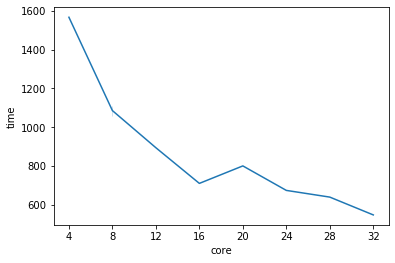

In [49]:
exp_folder = "/home/leni/are-logs/mnipes_v2_scaling/"
times = []

for folder in os.listdir(exp_folder):
    time = compute_runtime(exp_folder + "/" + folder + "/times.csv",250)/(1000000)
    core = int(read_parameters(exp_folder + "/" + folder + "/parameters.csv")["#numberOfSimulators"])
    times.append([core,time])

def sort_dist(e):
    return e[0]
times.sort(key=sort_dist)
print(times)
data = pd.DataFrame(data=times,columns=["core","time"]) 
ax = sns.lineplot(data=data,x="core",y="time")
ax.set_xticks(range(4,36,4))

# I Empty Arena
## I.1 Quality

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 51.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 38.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 19.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 9.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 5.3% 

Text(0.5, 1.0, 'exploraton - arena')

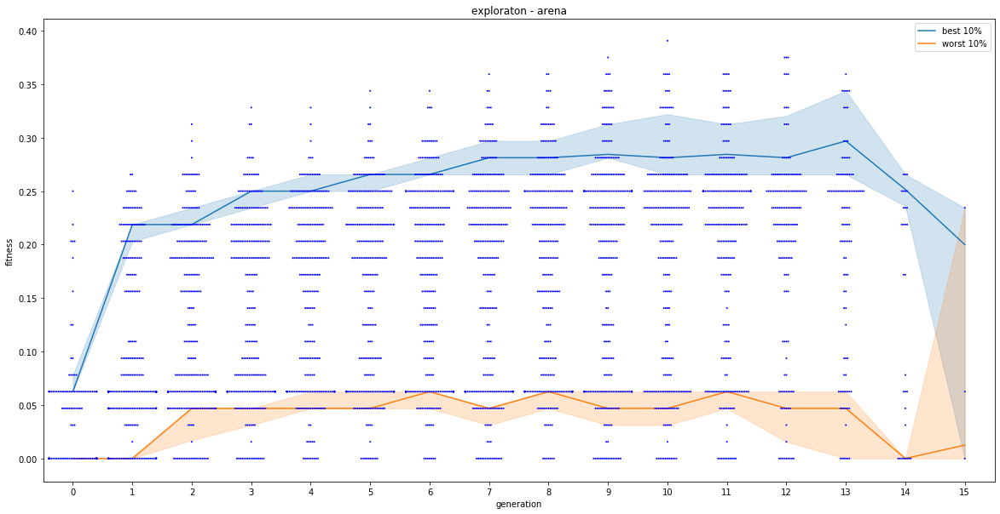

In [64]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/async/"
lines = []
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([_id,fit,gen])

data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("exploraton - arena")

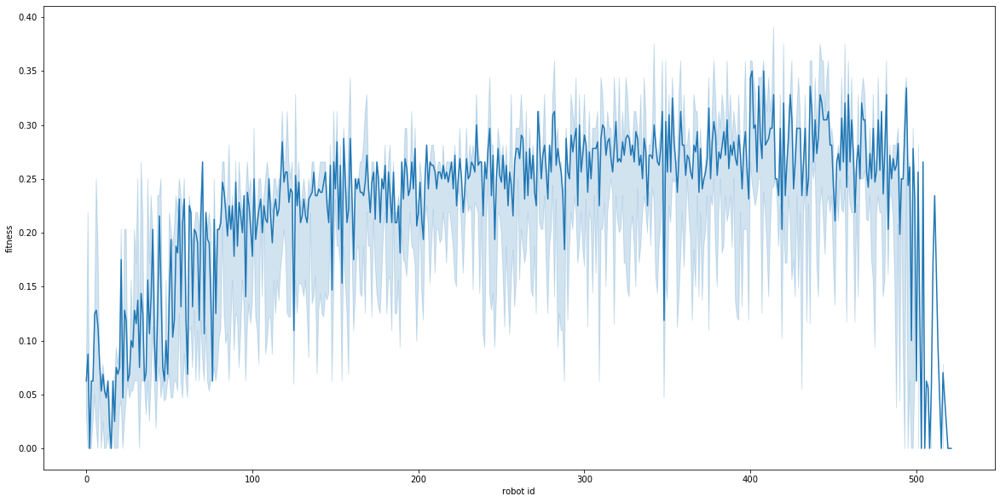

In [128]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc_high)

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 64.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 29.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 17.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 16.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 15.9

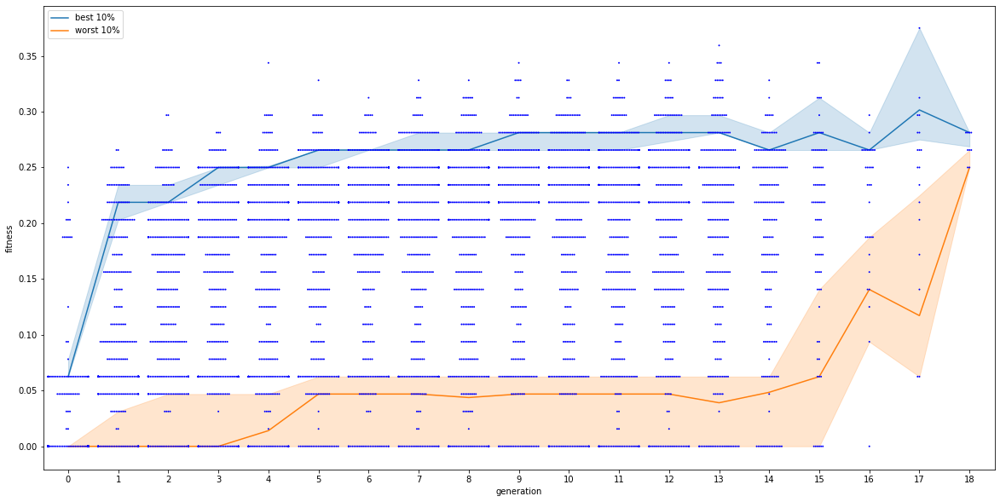

In [133]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/synch/"
lines = []
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    
    for id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([id,fit,gen])
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("exploration - arena")

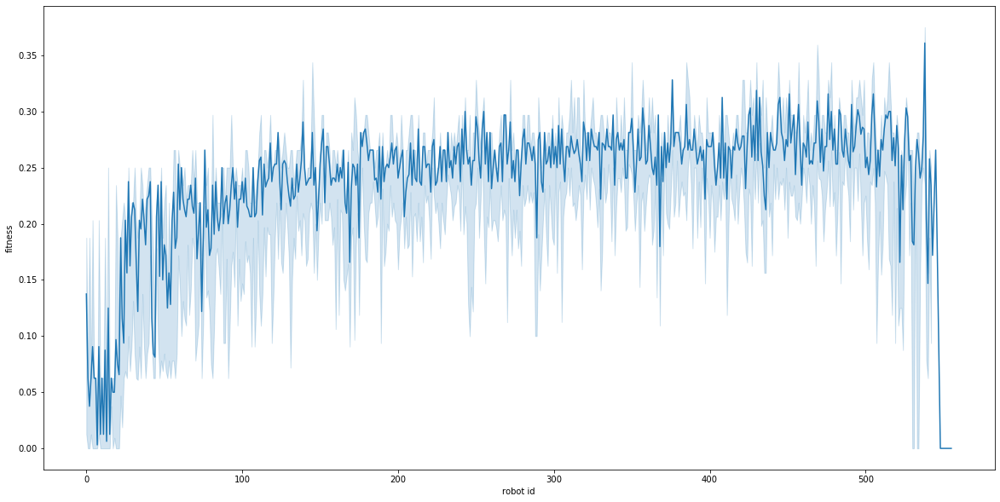

In [130]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc)

## I.2 Diversity

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 20.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 23.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 23.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 27.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 32.0

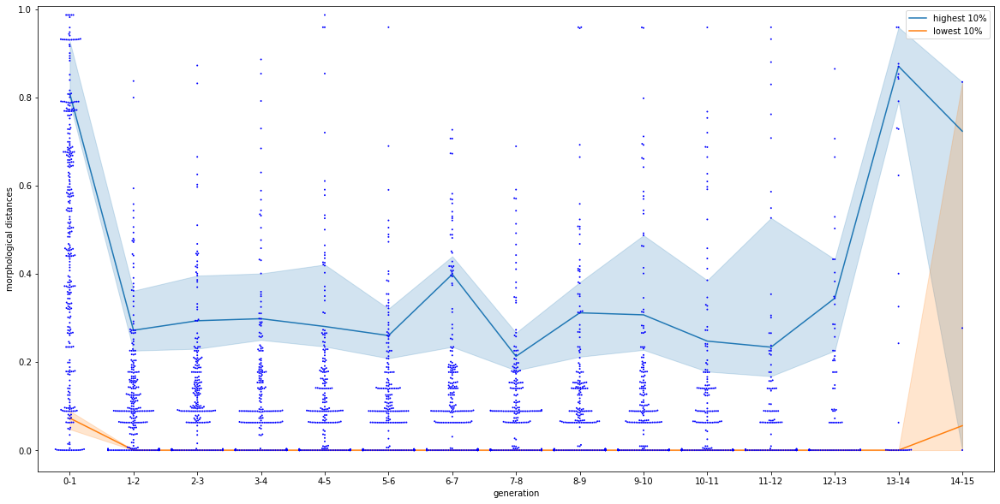

In [66]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/async/"
lines = []

for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 20.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 34.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 15.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 16.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 13.9

Text(0.5, 1.0, 'exploration - arena')

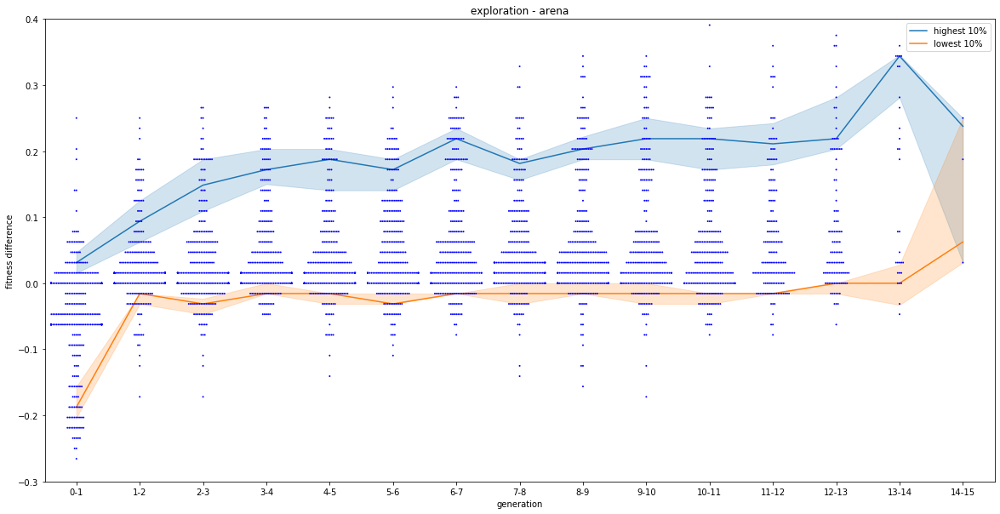

In [67]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.3,0.4])
ax.set_title("exploration - arena")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 29.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 35.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 36.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 41.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 43.3

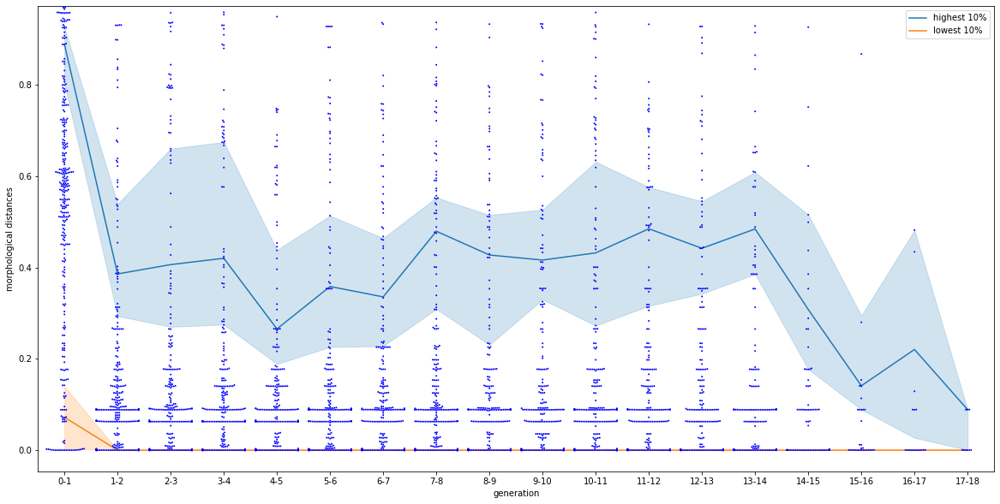

In [136]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/synch/"
lines = []

for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 25.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 25.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 24.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 20.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 22.9

(-0.3, 0.4)

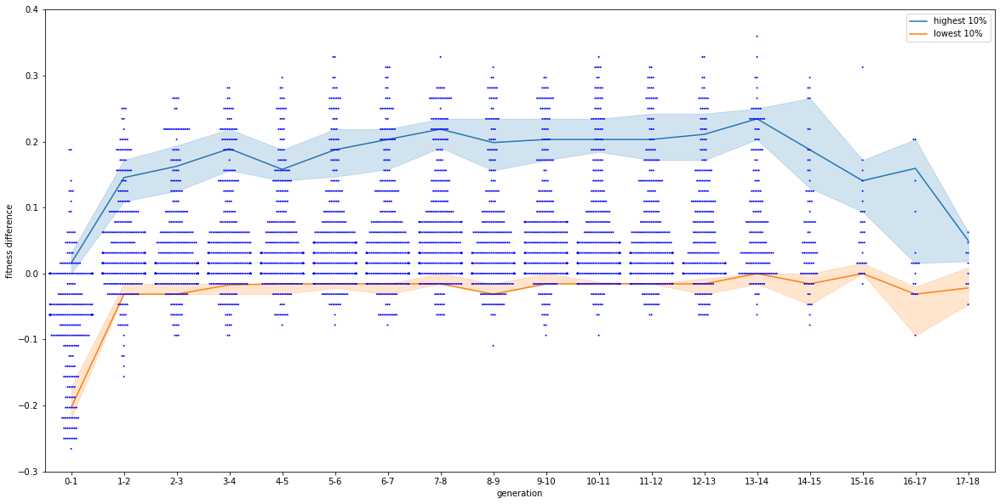

In [137]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.3,0.4])

## I.3 Efficiency

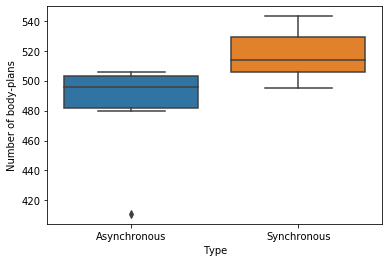

In [145]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/async/"
lines = []
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lines.append([len(ids),"Asynchronous"])

exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/synch/"
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lines.append([len(ids),"Synchronous"])

data = pd.DataFrame(data=lines,columns=["Number of body-plans","Type"])
sns.boxplot(data=data,x="Type",y="Number of body-plans")

## I.4 Behaviours

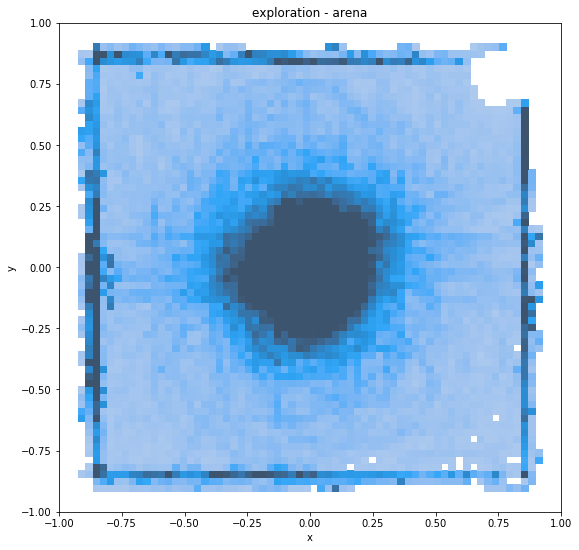

In [68]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/async/"
trajectory = []
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        trajectory += load_trajectory(exp_folder + "/" + folder + "/" + file)

data = pd.DataFrame(data=trajectory,columns=["t","x","y","z"])
fig = plt.gcf()
fig.set_size_inches(9, 9)
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.3)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
ax.set_title("exploration - arena")
plt.show()

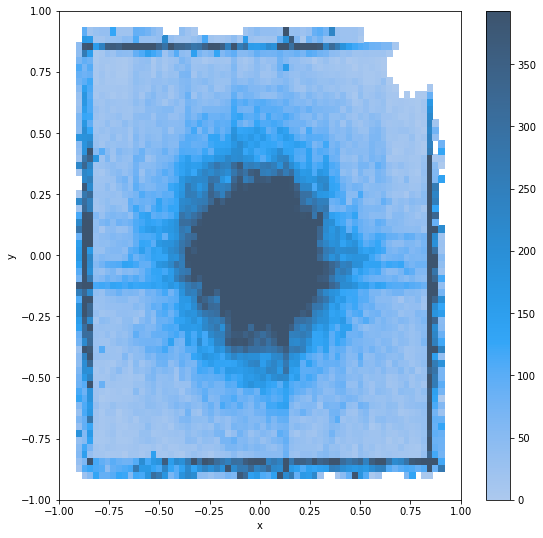

In [42]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/synch/"
trajectory = []
for folder in os.listdir(exp_folder):
    i = 0
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        trajectory += load_trajectory(exp_folder + "/" + folder + "/" + file)
        i+=1
data = pd.DataFrame(data=trajectory,columns=["t","x","y","z"]) 
fig = plt.gcf()
fig.set_size_inches(9, 9)
ax = sns.histplot(data=data,x="x",y="y",bins=64,cbar=True,legend=False,pmax=0.3)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

# II Obstacles
## II.1 Quality

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 49.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 38.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 23.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 22.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 28.9

Text(0.5, 1.0, 'exploration - obstacles')

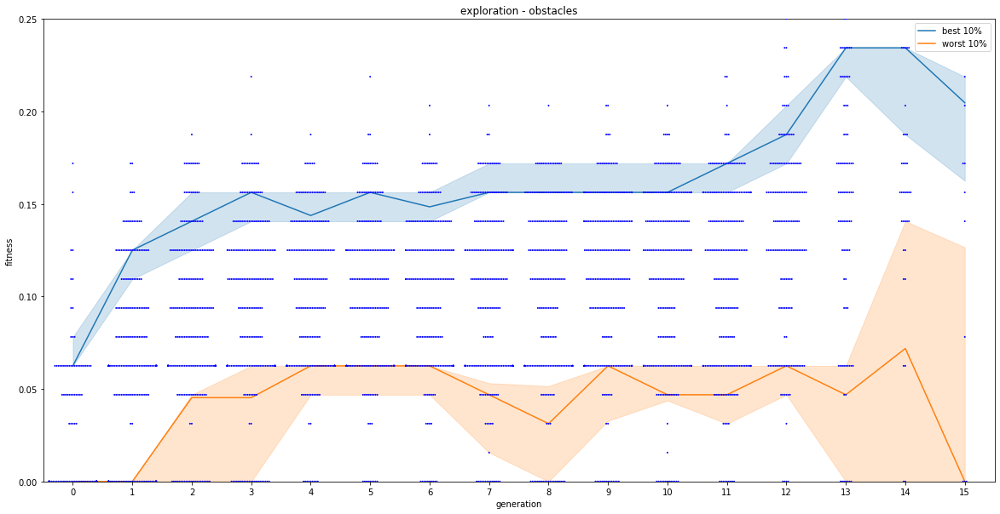

In [70]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/"
lines = []
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([_id,fit,gen])

data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_ylim([0,0.25])
ax.set_title("exploration - obstacles")

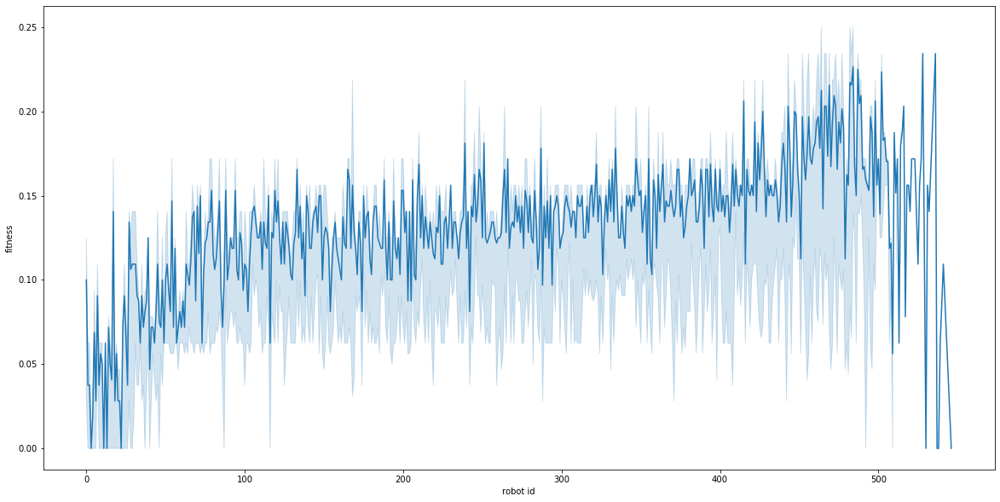

In [3]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc_high)

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 52.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 20.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 12.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 11.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 17.3

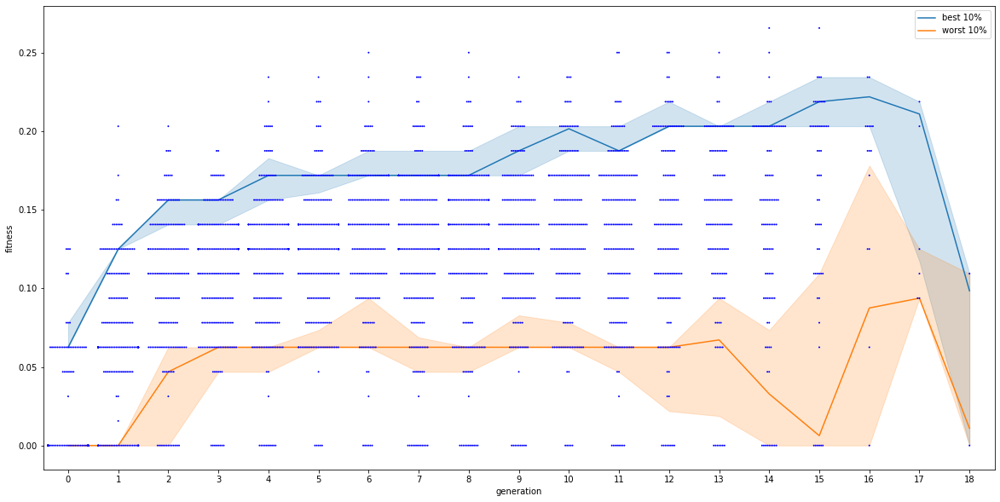

In [4]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/synch/"
lines = []
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    
    for id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([id,fit,gen])
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")

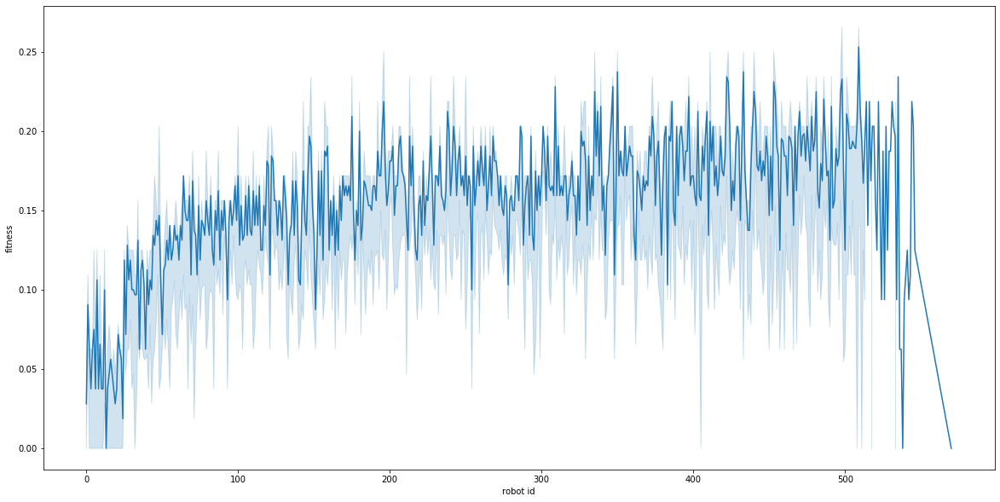

In [5]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc)

## II.2 Diversity

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 20.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 22.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 22.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 27.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 24.6

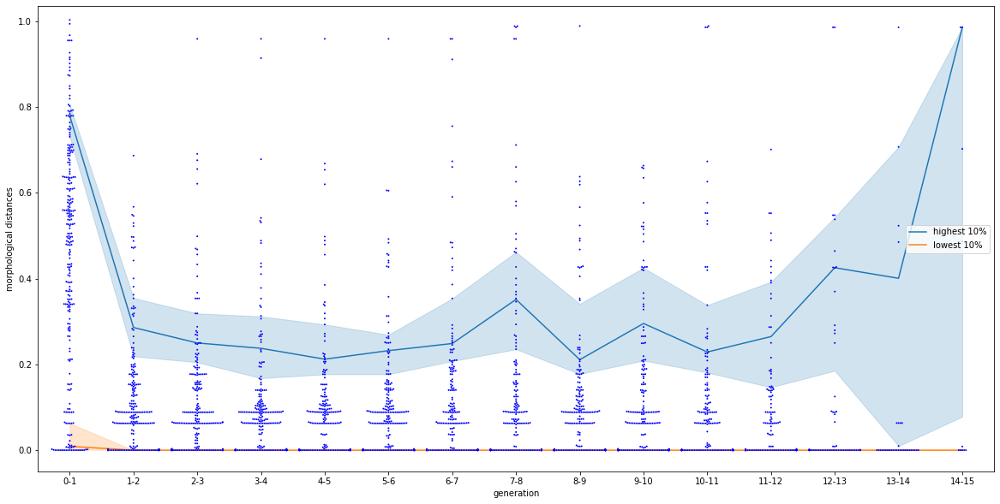

In [71]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/"
lines = []

for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 31.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 39.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 30.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 32.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 27.9

Text(0.5, 1.0, 'exploration - obstacles')

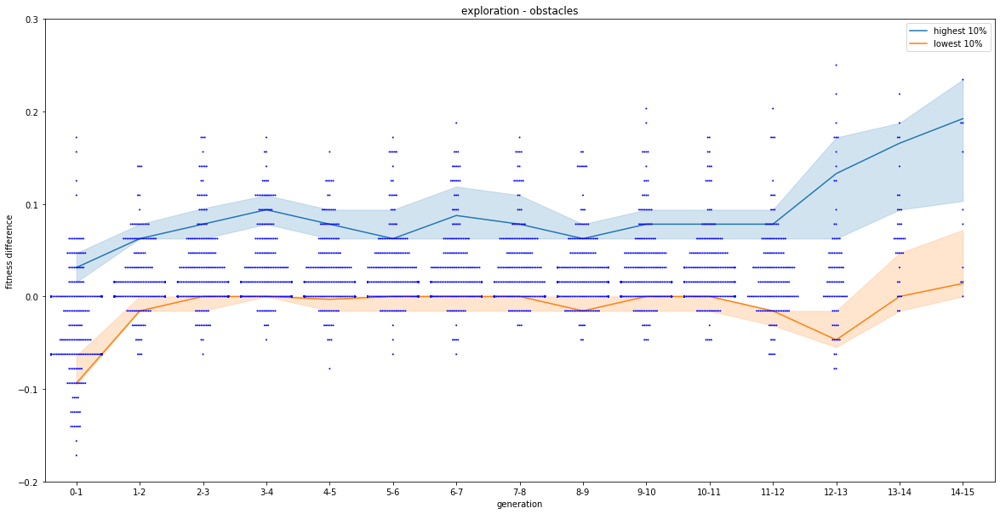

In [73]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.2,0.3])
ax.set_title("exploration - obstacles")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 28.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 16.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 22.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 36.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 34.3

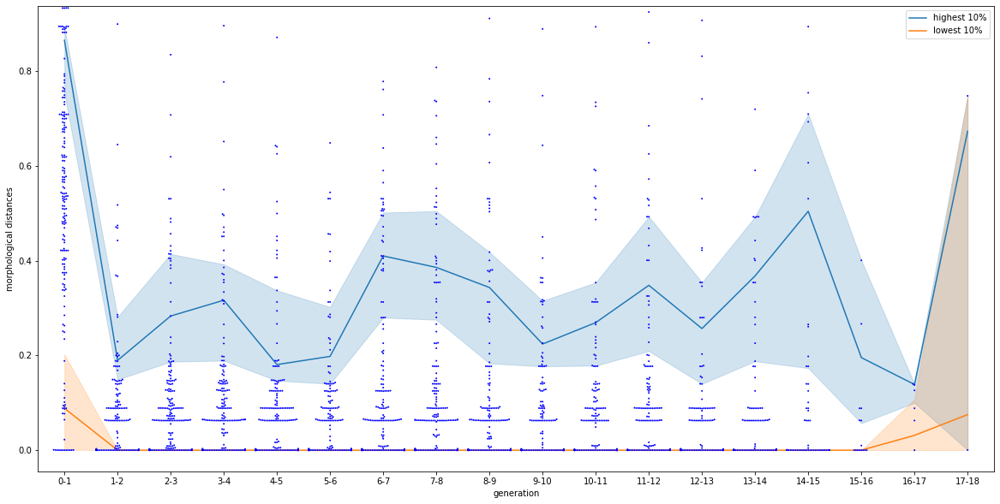

In [8]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/synch/"
lines = []

for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 19.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 15.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 14.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 7.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 15.9%

(-0.2, 0.3)

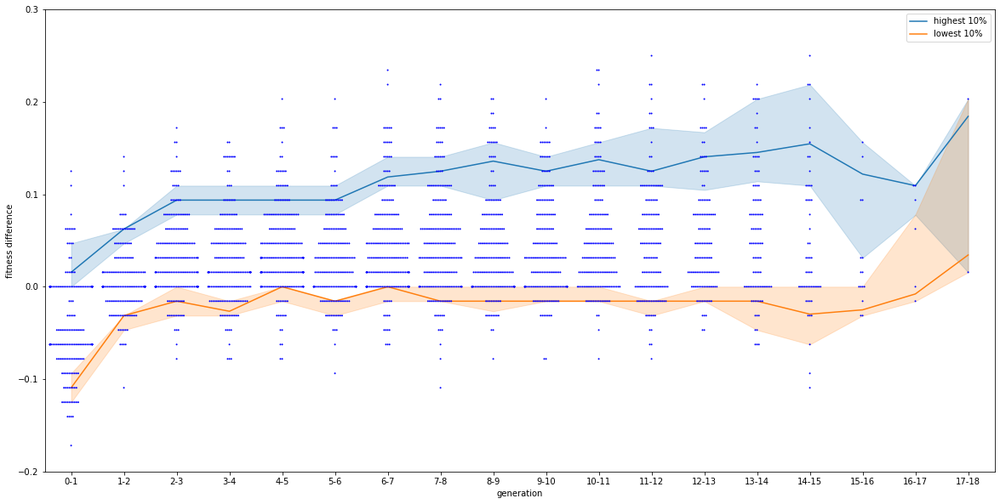

In [9]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.2,0.3])

In [15]:
desc_lines = []
organ_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/""
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100
z

for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","obstacles"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","obstacles"])

IndexError: list index out of range

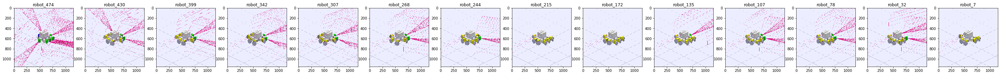

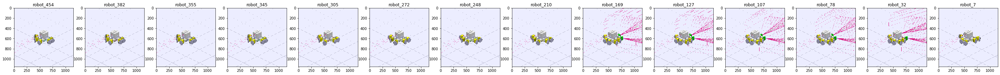

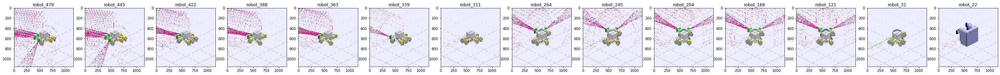

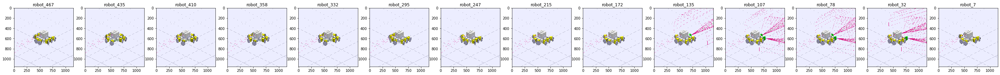

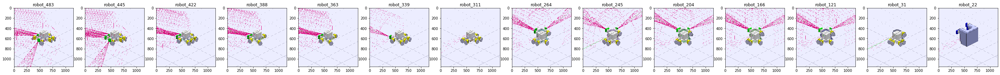

...

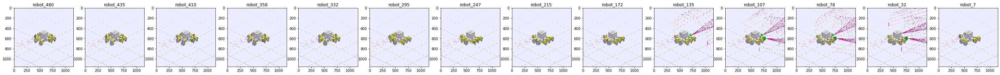

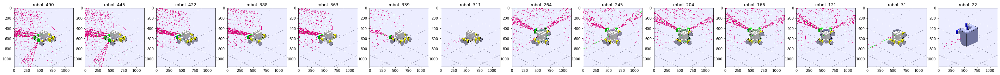

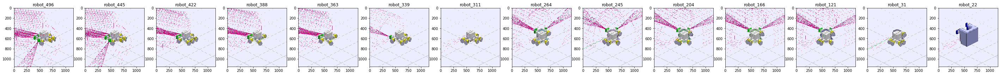

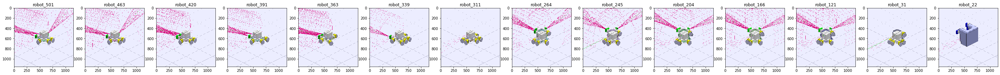

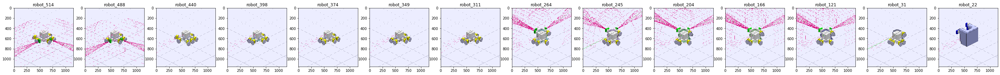

In [6]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/mnipes2_20_2_20-4-30-148-568210181/"

ids, fitnesses, parents = load_fitness(exp_folder + "/fitnesses.csv")
lineages = compute_lineage(ids,parents)    
for k,lin in lineages.items():
    if(len(lin)>12):
        images = []
        image_name = "robot_" + str(int(k)) + "_3.png"
        img = Image.open(exp_folder + "/images/" + image_name)
        images.append(img)
        for l in lin:
            image_name = "robot_" + str(int(l)) + "_3.png"
            img = Image.open(exp_folder + "/images/" + image_name)
            images.append(img)
        columns = len(images)
        height = len(images) * 50
        plt.figure(figsize=(50, height))
        lin =  [k] + lin
        for (i, image), l in zip(enumerate(images), lin):
            plt.subplot(int(len(images) / columns + 1), columns, i + 1)
            plt.title("robot_" + str(int(l)))
            plt.imshow(image)

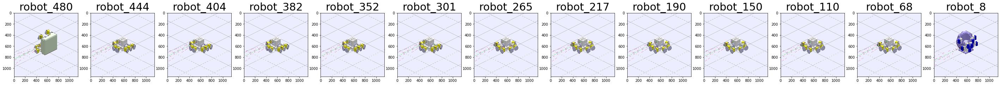

In [18]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/mnipes2_21_2_5-14-37-7578-1650340505///"

ids, fitnesses, parents = load_fitness(exp_folder + "/fitnesses.csv")
lineages = compute_lineage(ids,parents)    

k=480
images = []
image_name = "robot_" + str(int(k)) + "_3.png"
img = Image.open(exp_folder + "/images/" + image_name)
images.append(img)
for l in lineages[k]:
    image_name = "robot_" + str(int(l)) + "_3.png"
    img = Image.open(exp_folder + "/images/" + image_name)
    images.append(img)
columns = len(images)
height = len(images) * 50
plt.figure(figsize=(50, height))
lineages[k] =  [k] + lineages[k]
for (i, image), l in zip(enumerate(images), lineages[k]):
    plt.subplot(int(len(images) / columns + 1), columns, i + 1)
    plt.title("robot_" + str(int(l)),fontsize=30)
    plt.imshow(image)

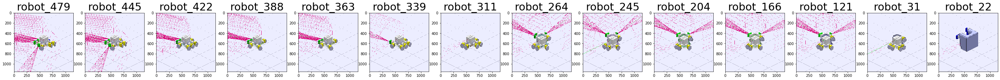

In [19]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/mnipes2_20_2_20-4-30-148-568210181/"

ids, fitnesses, parents = load_fitness(exp_folder + "/fitnesses.csv")
lineages = compute_lineage(ids,parents)    

k=479
images = []
image_name = "robot_" + str(int(k)) + "_3.png"
img = Image.open(exp_folder + "/images/" + image_name)
images.append(img)
for l in lineages[k]:
    image_name = "robot_" + str(int(l)) + "_3.png"
    img = Image.open(exp_folder + "/images/" + image_name)
    images.append(img)
columns = len(images)
height = len(images) * 50
plt.figure(figsize=(50, height))
lineages[k] =  [k] + lineages[k]
for (i, image), l in zip(enumerate(images), lineages[k]):
    plt.subplot(int(len(images) / columns + 1), columns, i + 1)
    plt.title("robot_" + str(int(l)),fontsize=30)
    plt.imshow(image)

## II.3 Efficiency

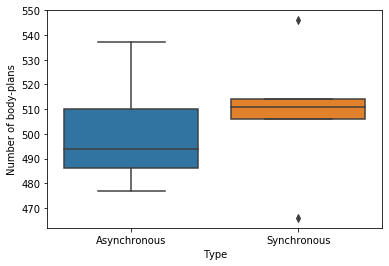

In [15]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/"
lines = []
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lines.append([len(ids),"Asynchronous"])

exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/synch/"
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lines.append([len(ids),"Synchronous"])

data = pd.DataFrame(data=lines,columns=["Number of body-plans","Type"])
sns.boxplot(data=data,x="Type",y="Number of body-plans")

## II.4 Behaviours

         id    t         x         y         z
0       243    0  0.000000  0.000000  0.120000
1       243    1 -0.002420 -0.000274  0.075175
2       243    2  0.001830 -0.002030  0.075889
3       243    3  0.008015 -0.002851  0.075890
4       243    4  0.014737 -0.004097  0.075901
...     ...  ...       ...       ...       ...
603453  392  298 -0.174468 -0.008530  0.119067
603454  392  299 -0.174437 -0.008498  0.119072
603455  392  300 -0.174376 -0.008587  0.119084
603456  392  301 -0.174356 -0.008572  0.119085
603457  392  302 -0.174347 -0.008528  0.119093

[603458 rows x 5 columns]


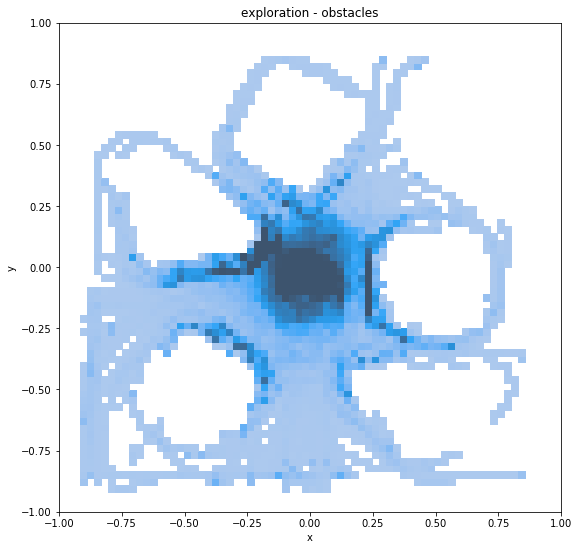

In [78]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        j = find_index(_id,ids)
        if(j == None):
            continue
        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        traj = [[_id] + t for t in traj]
        trajectory += traj

data = pd.DataFrame(data=trajectory,columns=["id","t","x","y","z"]) 
print(data)
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.5)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
ax.set_title("exploration - obstacles")
plt.show()

0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25
0.25


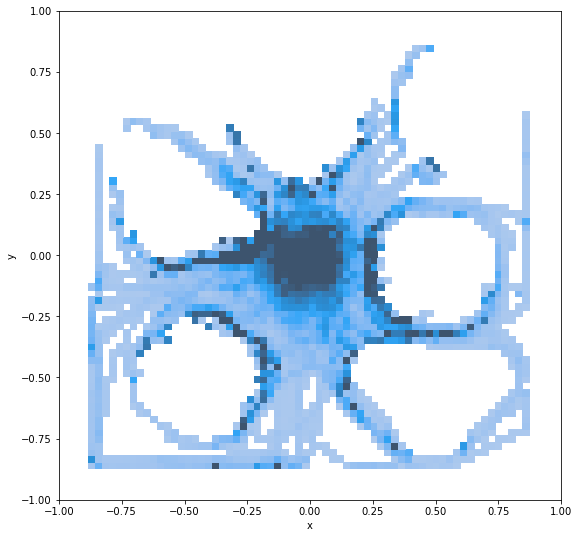

In [46]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/synch/"
trajectory = []
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        j = find_index(_id,ids)
        if(j == None):
            continue
        if(fitnesses[j] < 0.25):
            continue
        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        traj = [[_id] + t for t in traj]
        trajectory += traj

data = pd.DataFrame(data=trajectory,columns=["id","t","x","y","z"]) 
fig = plt.gcf()
fig.set_size_inches(9, 9)
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.5)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

# III Hard
## III.1 Quality

mnipes2_25_2_12-32-10-219-3542445294
mnipes2_25_2_9-53-37-7416-3382565406
mnipes2_25_2_9-29-18-8857-4077036900
mnipes2_25_2_9-20-12-2720-2242264572
mnipes2_25_2_9-9-15-5689-2909488388


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 48.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 22.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 13.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 7.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 5.6% 

Text(0.5, 1.0, 'exploration - hard')

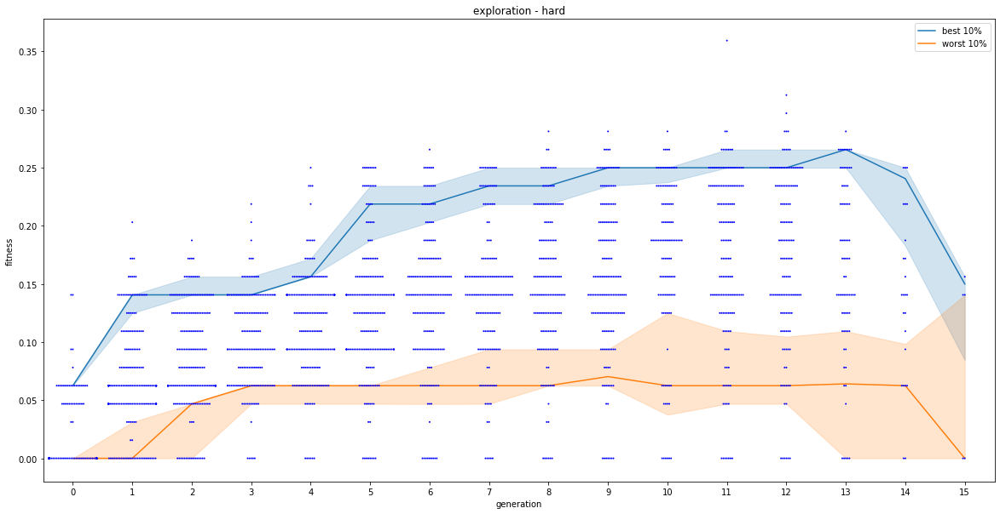

In [80]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/async/"
lines = []
for folder in os.listdir(exp_folder):
    print(folder)
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([_id,fit,gen])

data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("exploration - hard")

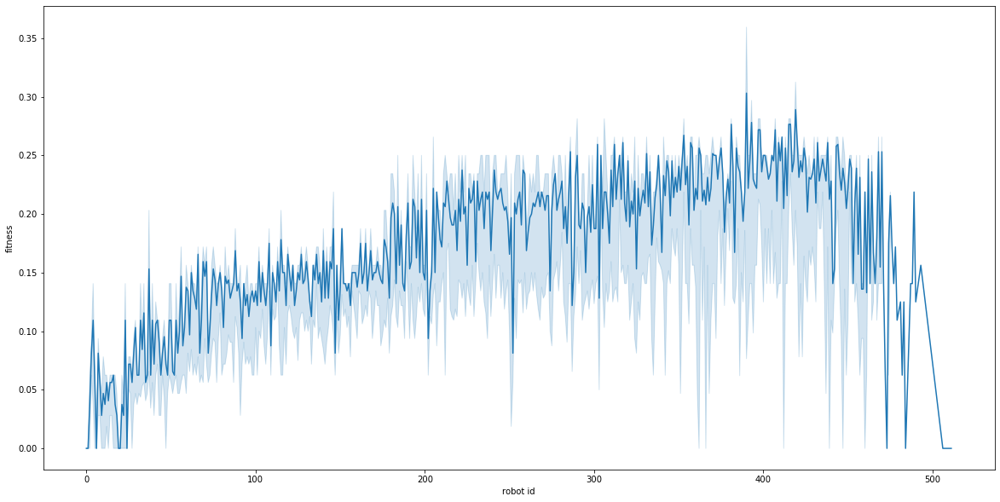

In [22]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc_high)

mnipes2_25_2_9-53-49-9057-455185757
mnipes2_25_2_9-53-37-7419-1389924245
mnipes2_25_2_12-32-10-220-1498034763
mnipes2_25_2_9-53-44-4462-392053518


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 49.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 21.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 9.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 5.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 6.2% o

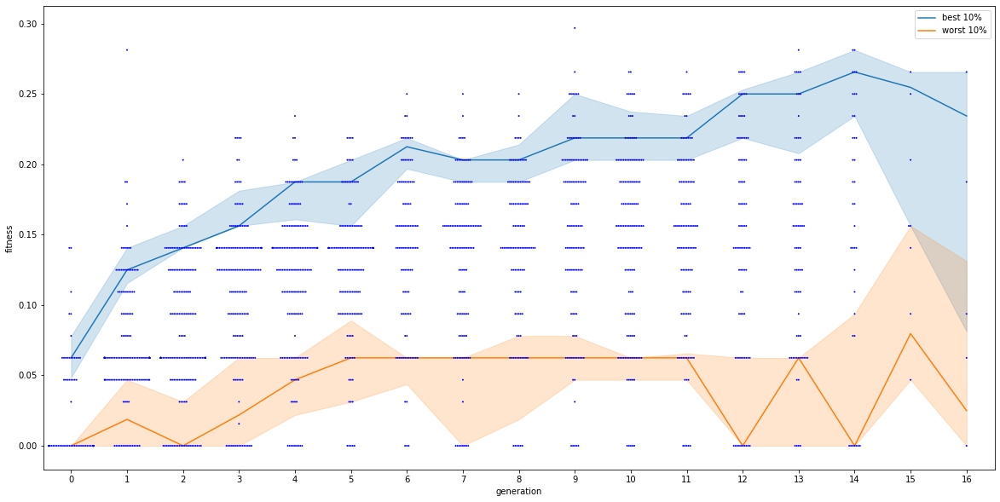

In [26]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/synch/"
lines = []
for folder in os.listdir(exp_folder):
    print(folder)
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    
    for id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([id,fit,gen])
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")

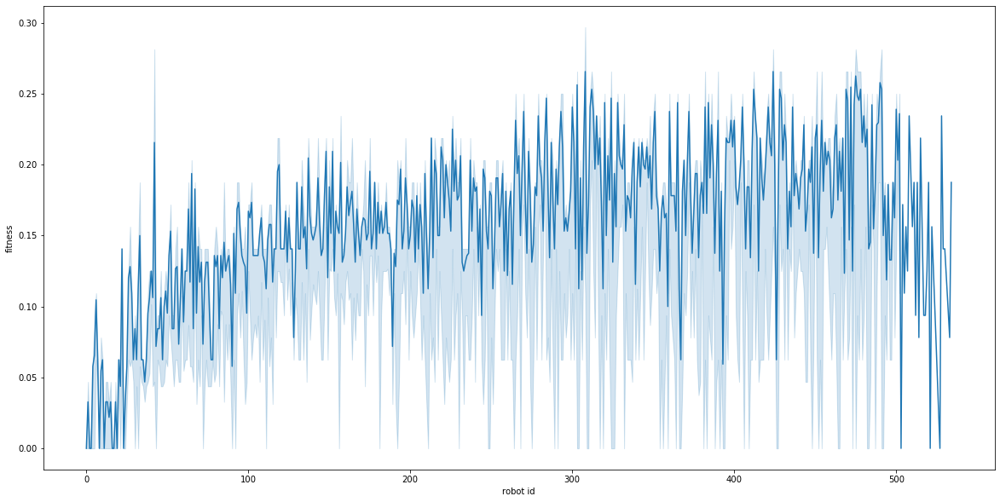

In [24]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc)

## III.2 Diversity

mnipes2_25_2_12-32-10-219-3542445294
mnipes2_25_2_9-53-37-7416-3382565406
mnipes2_25_2_9-29-18-8857-4077036900
mnipes2_25_2_9-20-12-2720-2242264572
mnipes2_25_2_9-9-15-5689-2909488388


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 24.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 21.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 36.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 36.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 40.7

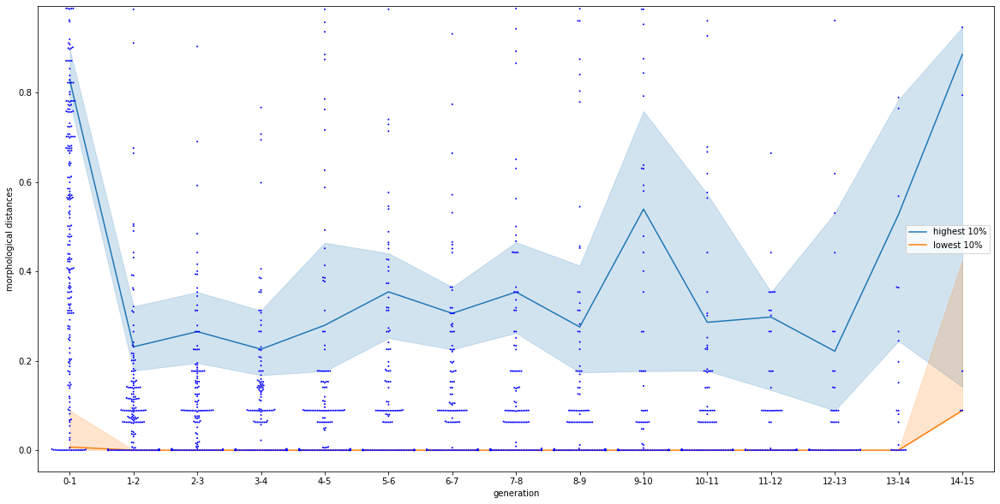

In [91]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/async/"
lines = []

for folder in os.listdir(exp_folder):
    print(folder)
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        if(j >= len(descriptors)):
            continue
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            if(j >= len(descriptors)):
                continue
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 13.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 24.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 5.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 7.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 5.1% o

Text(0.5, 1.0, 'exploration - hard')

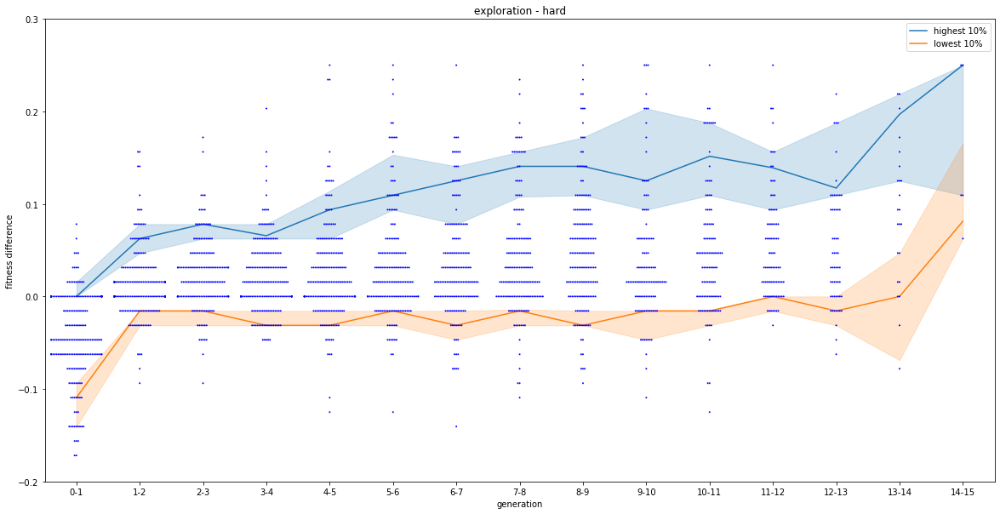

In [92]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.2,0.3])
ax.set_title("exploration - hard")

mnipes2_25_2_9-53-49-9057-455185757
mnipes2_25_2_9-53-37-7419-1389924245
mnipes2_25_2_12-32-10-220-1498034763
mnipes2_25_2_9-53-44-4462-392053518


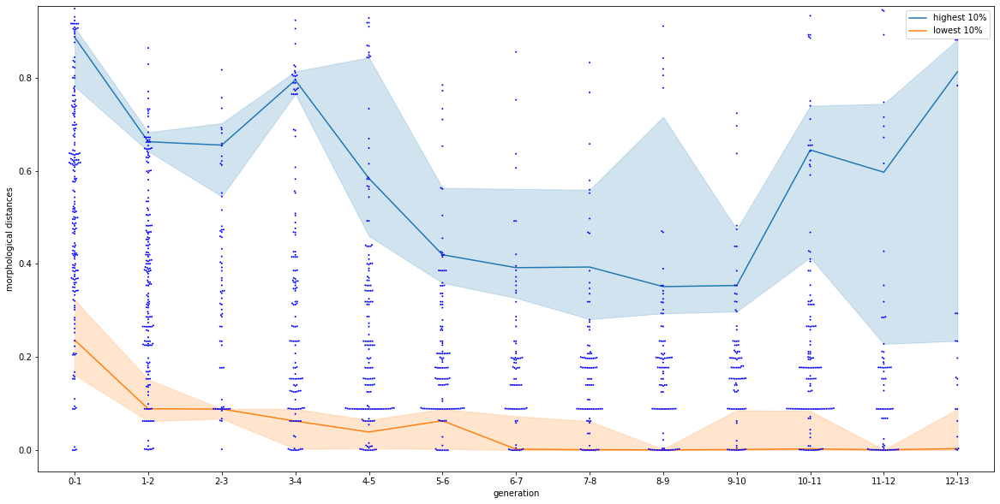

In [11]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/synch/"
lines = []

for folder in os.listdir(exp_folder):
    print(folder)
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        if(j >= len(descriptors)):
            continue
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            if(j >= len(descriptors)):
                continue
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 12.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 9.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 7.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


(-0.2, 0.3)

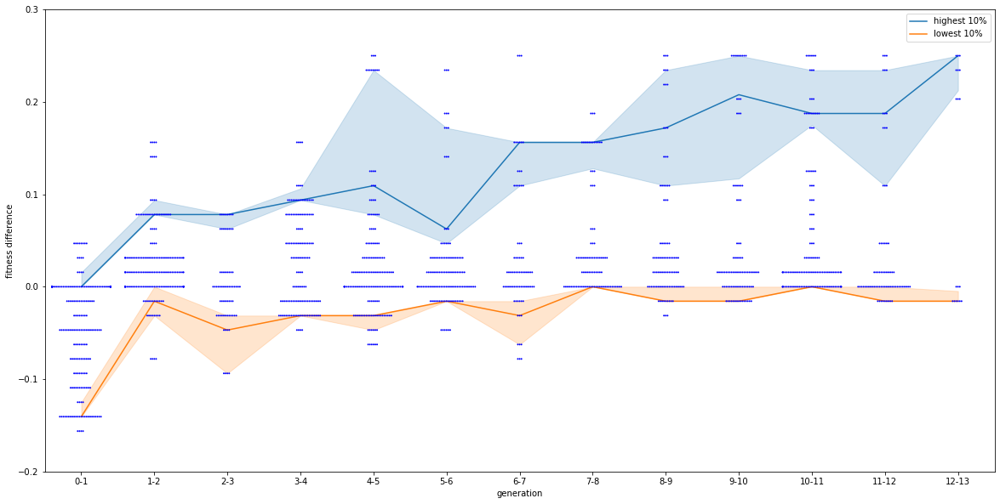

In [12]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.2,0.3])

In [15]:
desc_lines = []
organ_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/async/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","asynch"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","asynch"])

## III.3 Efficiency

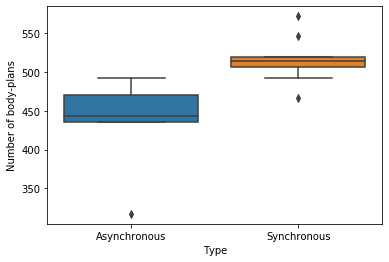

In [42]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/async/"
lines = []
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lines.append([len(ids),"Asynchronous"])

exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/synch/"
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lines.append([len(ids),"Synchronous"])

data = pd.DataFrame(data=lines,columns=["Number of body-plans","Type"])
sns.boxplot(data=data,x="Type",y="Number of body-plans")

## III.4 Behaviours

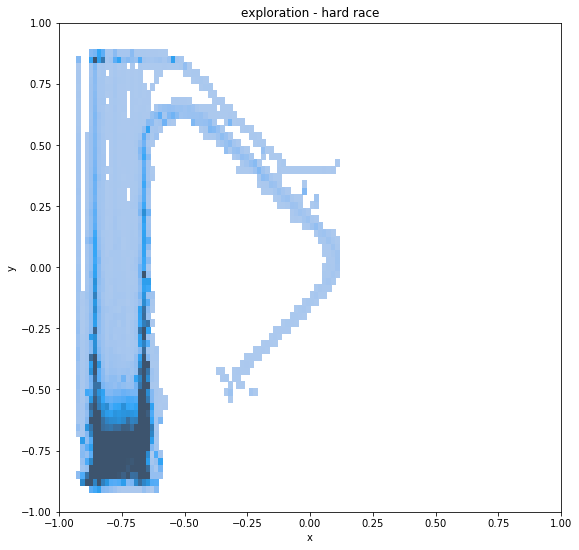

In [97]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/async/"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        j = find_index(_id,ids)
        if(j == None):
            continue
        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        if(len(traj)==0):
            continue
        traj = [[_id] + t for t in traj]
        #print(folder,fitnesses[j],traj[-1])
        trajectory += traj

data = pd.DataFrame(data=trajectory,columns=["id","t","x","y","z"]) 
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.3)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
ax.set_title("exploration - hard race")
plt.show()

mnipes2_25_2_9-53-49-9057-455185757 0.25 [438, 303, -0.654836, -0.321177, 0.0825167]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [397, 303, -0.666483, -0.804991, 0.0812144]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [409, 303, -0.649085, -0.487028, 0.0815193]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [405, 303, -0.827258, -0.813455, 0.0815192]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [220, 303, -0.860868, -0.607549, 0.082225]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [224, 51, -0.76232, -0.732658, 0.085133]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [410, 51, -0.738175, -0.671651, 0.0845381]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [371, 303, -0.730628, 0.435732, 0.05608]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [437, 303, -0.684198, -0.269272, 0.0811986]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [280, 303, -0.864174, 0.863474, 0.0813381]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [420, 303, -0.784455, -0.809289, 0.069971]
mnipes2_25_2_9-53-49-9057-455185757 0.25 [448, 303, -0.849138, 0.6001, 0.08

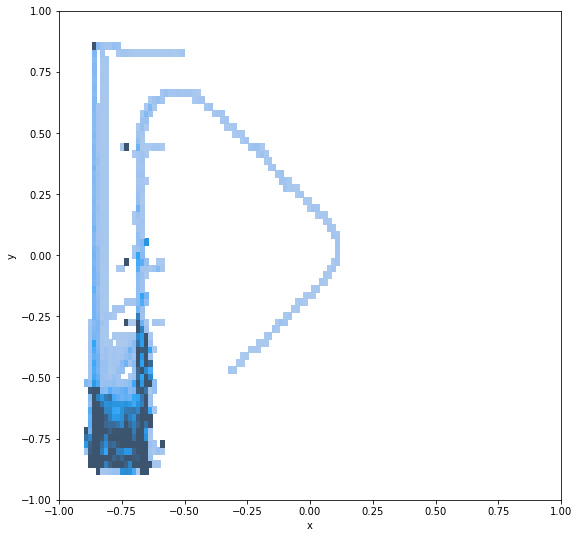

In [67]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/synch/"
trajectory = []
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        j = find_index(_id,ids)
        if(j == None):
            continue
        if(fitnesses[j] < 0.25):
            continue
        
        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        traj = [[_id] + t for t in traj]
        print(folder,fitnesses[j],traj[-1])
        trajectory += traj

fig = plt.gcf()
fig.set_size_inches(9, 9)
data = pd.DataFrame(data=trajectory,columns=["id","t","x","y","z"]) 
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.3)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

# IV Multi Target Arena
## IV.1 Quality

mnipes2_29_2_10-16-4-4033-130419731
mnipes2_30_2_12-9-35-5687-3864990738
mnipes2_30_2_11-46-18-8137-992242247
mnipes2_30_2_7-57-32-2315-3110557862
mnipes2_30_2_11-44-40-302-3943454504
mnipes2_29_2_10-16-4-4011-3773043271
mnipes2_30_2_12-9-14-4560-3033080034
mnipes2_29_2_10-15-58-8356-724435427


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 57.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 15.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


Text(0.5, 1.0, 'phototaxis - arena')

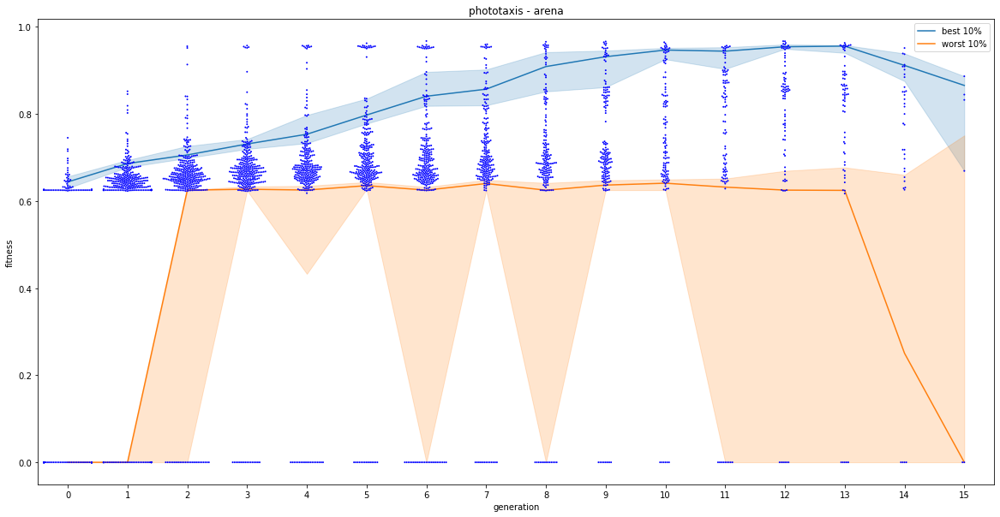

In [99]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/multi_arena/async/"
lines = []
for folder in os.listdir(exp_folder):
    print(folder)
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    
    for id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([id,fit,gen])
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("phototaxis - arena")

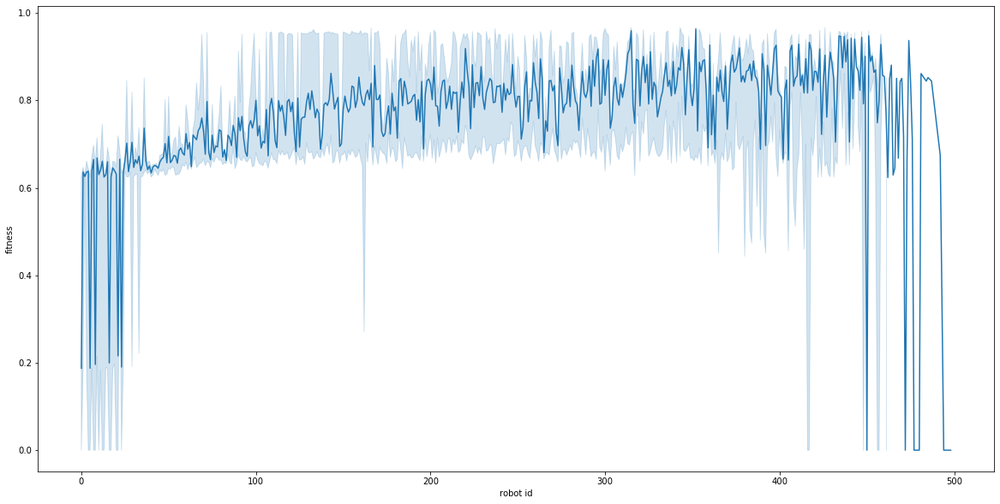

In [6]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc_high)

## IV.2 Diversity

mnipes2_29_2_10-16-4-4033-130419731
mnipes2_30_2_12-9-35-5687-3864990738
mnipes2_30_2_11-46-18-8137-992242247
mnipes2_30_2_7-57-32-2315-3110557862
mnipes2_30_2_11-44-40-302-3943454504
mnipes2_29_2_10-16-4-4011-3773043271
mnipes2_30_2_12-9-14-4560-3033080034
mnipes2_29_2_10-15-58-8356-724435427


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 32.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 37.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 40.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 48.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 39.9

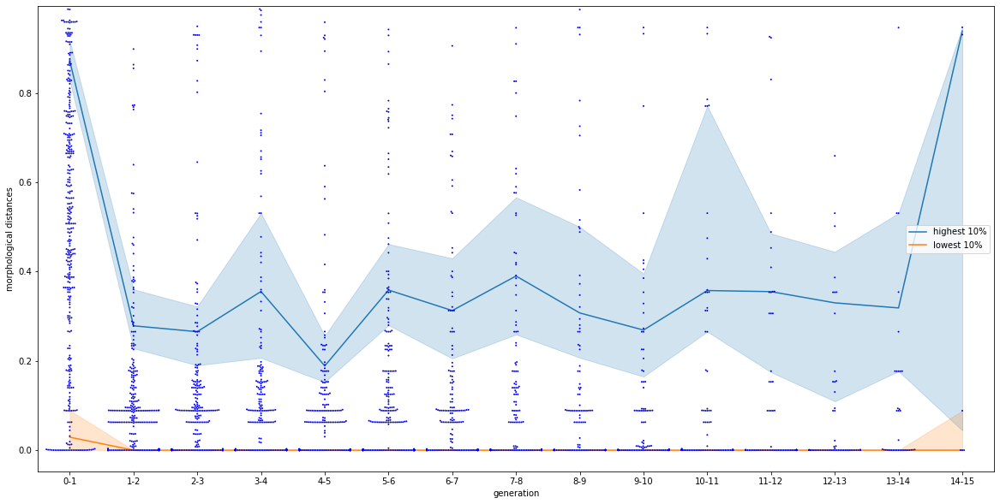

In [101]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/multi_arena/async/"
lines = []

for folder in os.listdir(exp_folder):
    print(folder)
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 14.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 15.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 5.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


Text(0.5, 1.0, 'phototaxis - arena')

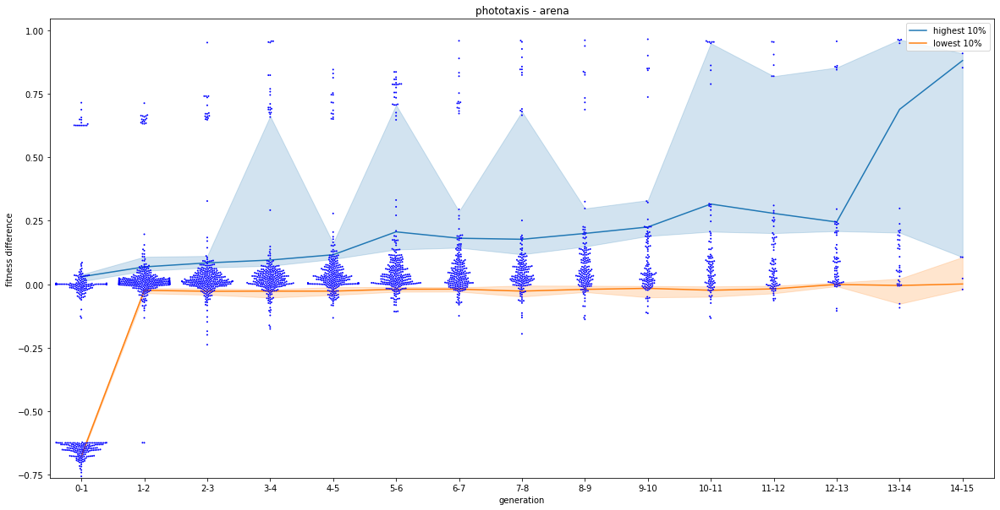

In [102]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
#ax.set_ylim([-0.2,0.3])
ax.set_title("phototaxis - arena")

In [12]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/synch/"
lines = []

for folder in os.listdir(exp_folder):
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

IndexError: list index out of range

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 14.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 15.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 5.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


(-0.2, 0.3)

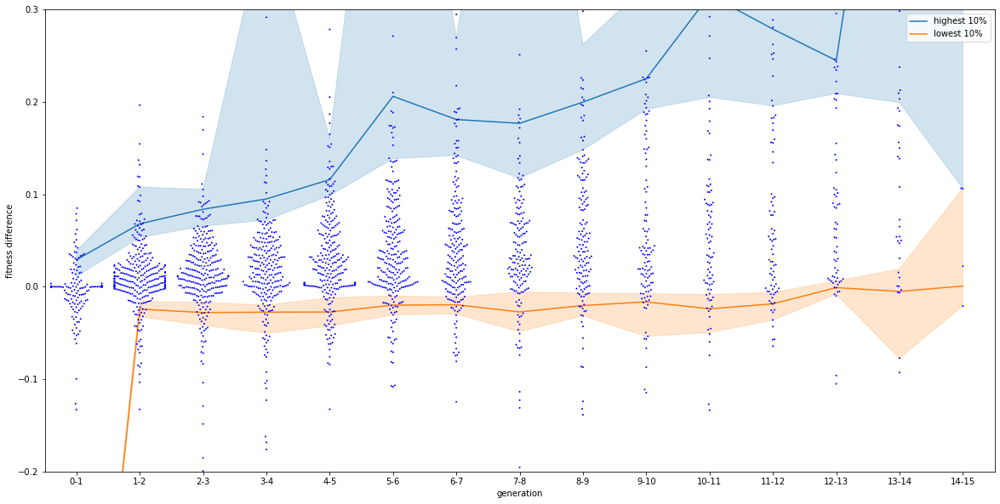

In [9]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.2,0.3])

In [16]:
desc_lines = []
organ_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/multi_arena/async/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","async"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","async"])

<Figure size 360x360 with 0 Axes>

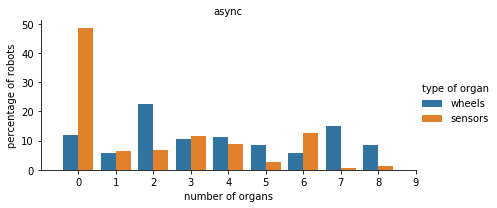

In [17]:
fig = plt.gcf()
fig.set_size_inches(5, 5)
organs_data = pd.DataFrame(data=organ_lines,columns=["number of organs","percentage of robots","type of organ","variant"])
g=sns.catplot(data=organs_data,x="number of organs",y="percentage of robots",hue="type of organ",col="variant",kind='bar',col_wrap=1,aspect=2,height=3)
(g.set_titles("{col_name}")
  .set(xlim=(-1, 9))) 

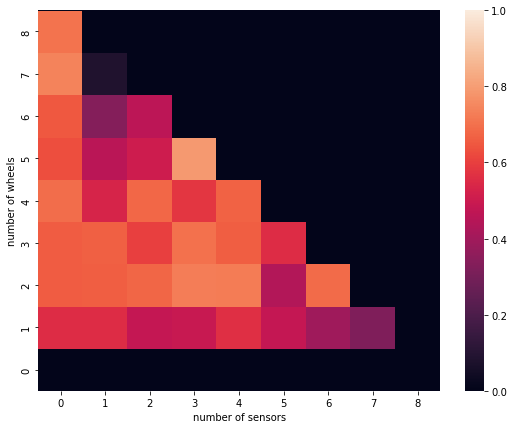

In [19]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/multi_arena/async/"
list_data = []
for folder in os.listdir(exp_folder):
    list_data.append(load_controller_archive(exp_folder + "/" + folder + "/controller_archive"))

data = pd.concat(list_data,ignore_index=True)
data = data.groupby(["number of wheels","number of sensors"]).mean().squeeze().unstack()
#data = data.pivot(index="number of wheels",columns="number of sensors",values="fitness")
fig = plt.gcf()
fig.set_size_inches(9, 7)
ax = sns.heatmap(data,vmin=0,vmax=1.0)
ax.set_ylim([0,9])
ax.set_xlim([0,9])
plt.show()

## IV.4 Behaviours

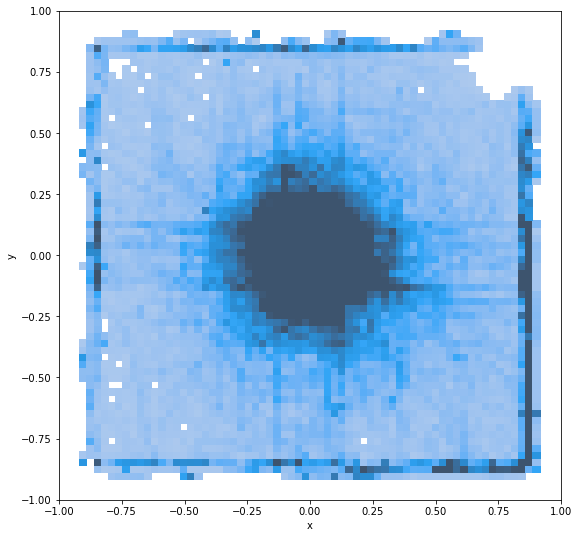

In [20]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/multi_arena/async/"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        trajectory += load_trajectory(exp_folder + "/" + folder + "/" + file)

data = pd.DataFrame(data=trajectory,columns=["t","x","y","z"]) 
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.3)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

# Organs Distribution

In [33]:
desc_lines = []
organ_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/async/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","exploration - arena"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","exploration - arena"])

In [34]:
desc_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/"
for folder in os.listdir(exp_folder):
    print(folder)
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","exploration - obstacles"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","exploration - obstacles"])

mnipes2_26_2_11-2-6-6185-1523971368
mnipes2_21_2_5-14-37-7578-1650340505
mnipes2_20_2_20-4-30-148-568210181
mnipes2_20_2_20-4-29-9409-3641839778
mnipes2_21_2_3-26-32-2313-1041593258
mnipes2_21_2_5-14-37-7586-1937819688


In [35]:
desc_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/async/"
for folder in os.listdir(exp_folder):
    print(folder)
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","exploration - hard race"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","exploration - hard race"])

mnipes2_25_2_12-32-10-219-3542445294
mnipes2_25_2_9-53-37-7416-3382565406
mnipes2_25_2_9-29-18-8857-4077036900
mnipes2_25_2_9-20-12-2720-2242264572
mnipes2_25_2_9-9-15-5689-2909488388


In [36]:
desc_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/multi_arena/async/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","phototaxis - arena"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","phototaxis - arena"])

<Figure size 360x360 with 0 Axes>

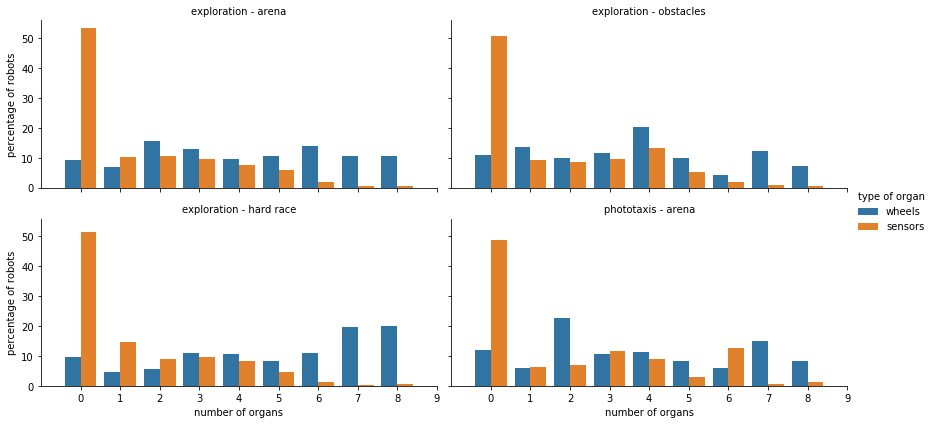

In [37]:
fig = plt.gcf()
fig.set_size_inches(5, 5)
organs_data = pd.DataFrame(data=organ_lines,columns=["number of organs","percentage of robots","type of organ","variant"])
g=sns.catplot(data=organs_data,x="number of organs",y="percentage of robots",hue="type of organ",col="variant",kind='bar',col_wrap=2,aspect=2,height=3)
(g.set_titles("{col_name}")
  .set(xlim=(-1, 9)))

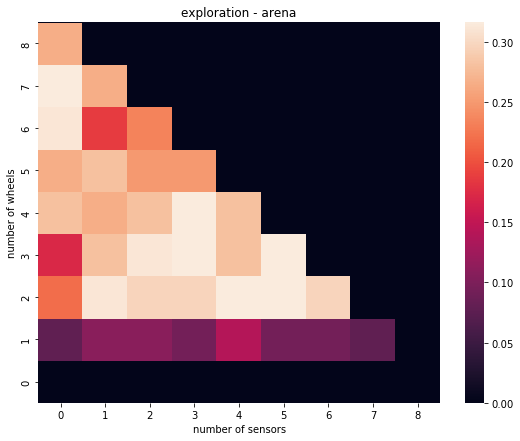

In [58]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/arena/async/"
list_data = []
for folder in os.listdir(exp_folder):
    list_data.append(load_controller_archive(exp_folder + "/" + folder + "/controller_archive"))

data = pd.concat(list_data,ignore_index=True)
data = data.groupby(["number of wheels","number of sensors"]).max().squeeze().unstack()
#data = data.pivot(index="number of wheels",columns="number of sensors",values="fitness")
fig = plt.gcf()
fig.set_size_inches(9, 7)
ax = sns.heatmap(data,robust=True)#,vmin=0,vmax=0.2)
ax.set_ylim([0,9])
ax.set_xlim([0,9])
ax.set_title("exploration - arena")
plt.show()

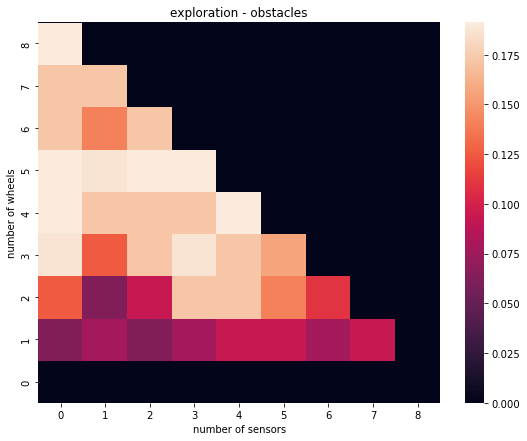

In [59]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/"
list_data = []
for folder in os.listdir(exp_folder):
    list_data.append(load_controller_archive(exp_folder + "/" + folder + "/controller_archive"))
    
data = pd.concat(list_data,ignore_index=True)
data = data.groupby(["number of wheels","number of sensors"]).max().squeeze().unstack()
#data = data.pivot(index="number of wheels",columns="number of sensors",values="fitness")
fig = plt.gcf()
fig.set_size_inches(9, 7)
ax = sns.heatmap(data,robust=True)#,vmin=0,vmax=0.2)
ax.set_ylim([0,9])
ax.set_xlim([0,9])
ax.set_title("exploration - obstacles")
plt.show()

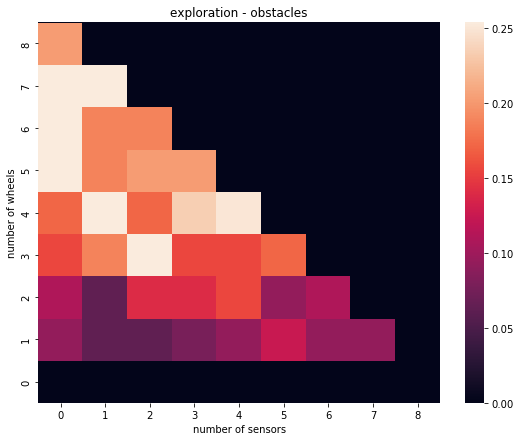

In [60]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/hard/async/"
list_data = []
for folder in os.listdir(exp_folder):
    list_data.append(load_controller_archive(exp_folder + "/" + folder + "/controller_archive"))
    
data = pd.concat(list_data,ignore_index=True)
data = data.groupby(["number of wheels","number of sensors"]).max().squeeze().unstack()
#data = data.pivot(index="number of wheels",columns="number of sensors",values="fitness")
fig = plt.gcf()
fig.set_size_inches(9, 7)
ax = sns.heatmap(data,robust=True)#,vmin=0,vmax=0.2)
ax.set_ylim([0,9])
ax.set_xlim([0,9])
ax.set_title("exploration - obstacles")
plt.show()

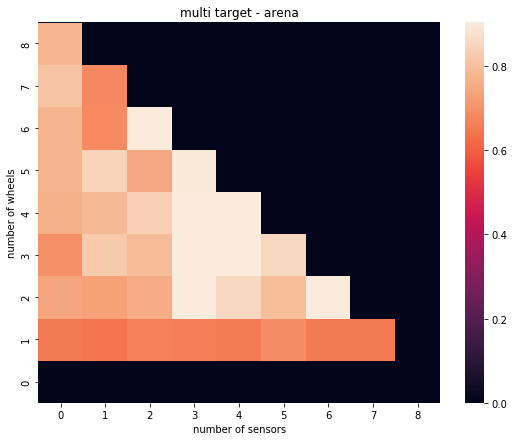

In [63]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/multi_arena/async/"
list_data = []
for folder in os.listdir(exp_folder):
    list_data.append(load_controller_archive(exp_folder + "/" + folder + "/controller_archive"))

data = pd.concat(list_data,ignore_index=True)
data = data.groupby(["number of wheels","number of sensors"]).max().squeeze().unstack()
#data = data.pivot(index="number of wheels",columns="number of sensors",values="fitness")
fig = plt.gcf()
fig.set_size_inches(9, 7)
ax = sns.heatmap(data,robust=True)#,vmin=0,vmax=1)
ax.set_ylim([0,9])
ax.set_xlim([0,9])
ax.set_title("multi target - arena")
plt.show()

# V Exploration II
## V.1 Quality

mnipes2_19_3_9-36-52-2998-3380361465
mnipes2_19_3_9-36-50-43-1995006737
mnipes2_19_3_9-37-19-9212-619682419
mnipes2_19_3_9-37-0-418-3264777717
mnipes2_19_3_9-36-57-7415-439208534
mnipes2_19_3_9-37-22-2108-3723835591
mnipes2_19_3_9-37-5-5736-2140378590


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 48.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 13.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


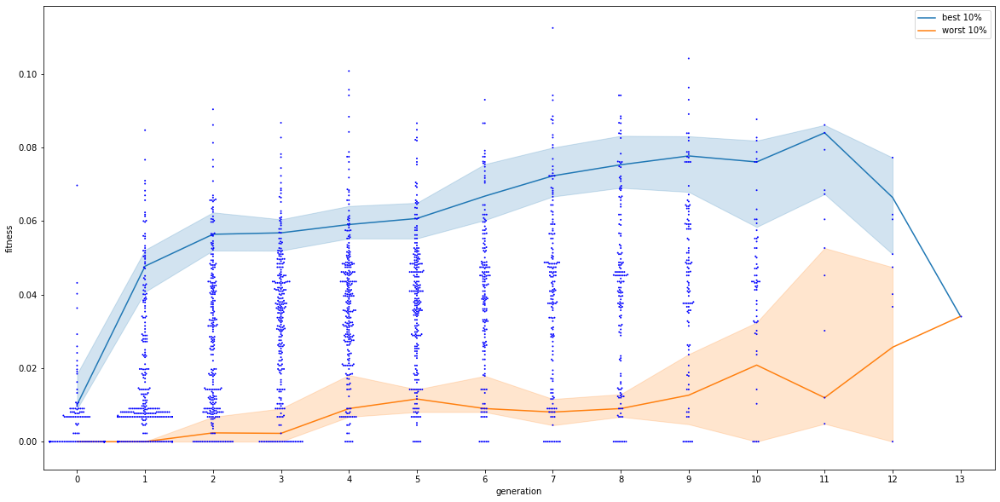

In [3]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/baseline/"
lines = []
for folder in os.listdir(exp_folder):
    print(folder)
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    
    for id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([id,fit,gen])
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")

mnipes2_19_3_9-37-53-3240-733799511
mnipes2_19_3_9-37-52-2226-2843342729
mnipes2_19_3_9-36-24-4947-3365042904
mnipes2_19_3_9-37-52-2252-589314692
mnipes2_19_3_9-36-22-2108-1189049642
mnipes2_19_3_9-37-52-2228-2922610258


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 53.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 25.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


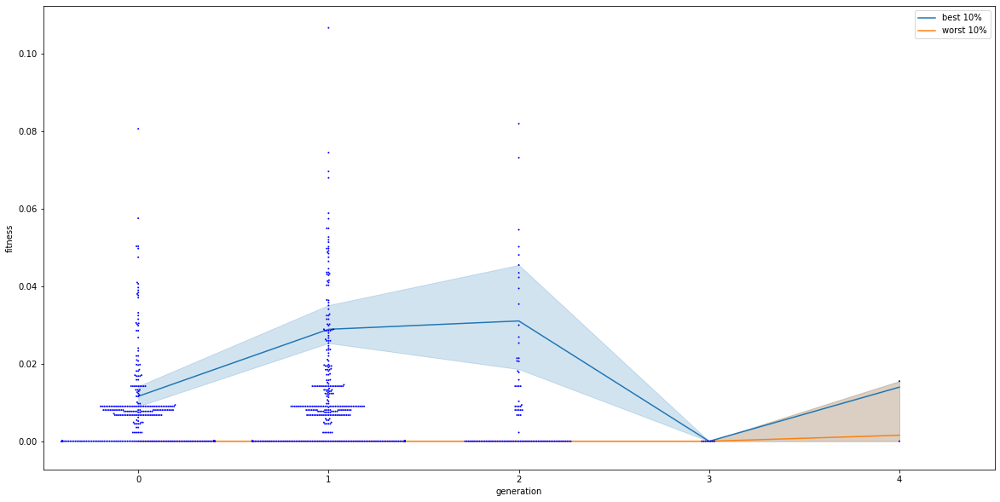

In [4]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/large_pop/"
lines = []
for folder in os.listdir(exp_folder):
    print(folder)
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    
    for id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([id,fit,gen])
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")

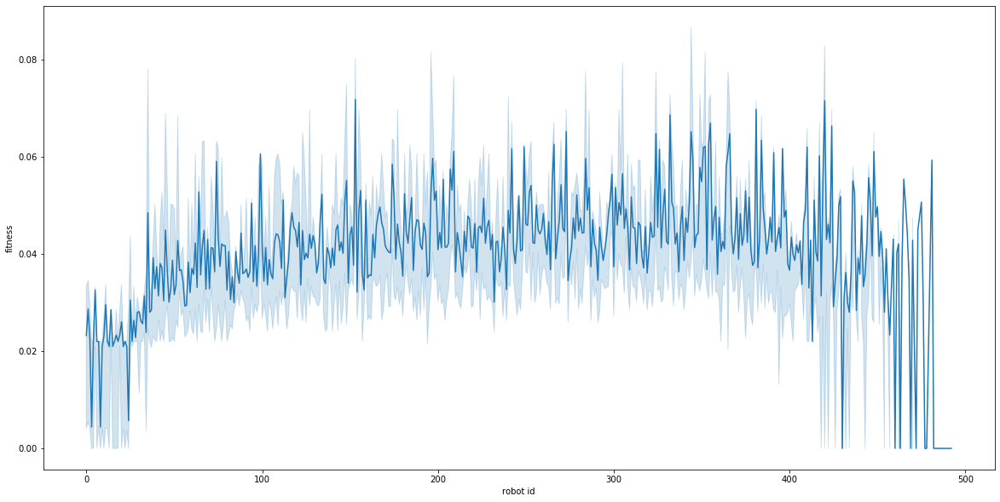

In [22]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc_high)

## V.2 Diversity

mnipes2_19_3_9-36-52-2998-3380361465
mnipes2_19_3_9-36-50-43-1995006737
mnipes2_19_3_9-37-19-9212-619682419
mnipes2_19_3_9-37-0-418-3264777717
mnipes2_19_3_9-36-57-7415-439208534
mnipes2_19_3_9-37-22-2108-3723835591
mnipes2_19_3_9-37-5-5736-2140378590


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 27.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 31.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 36.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 32.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 31.1

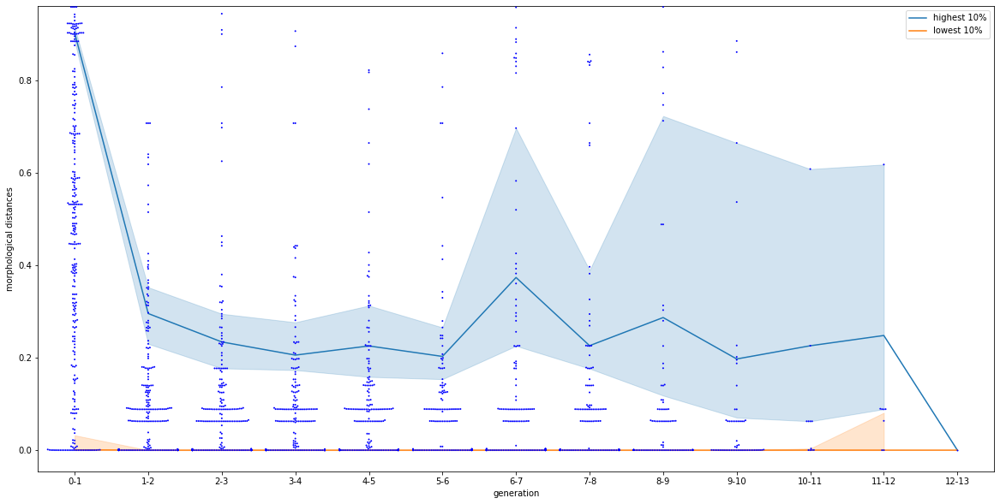

In [5]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/baseline/"
lines = []

for folder in os.listdir(exp_folder):
    print(folder)
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 9.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


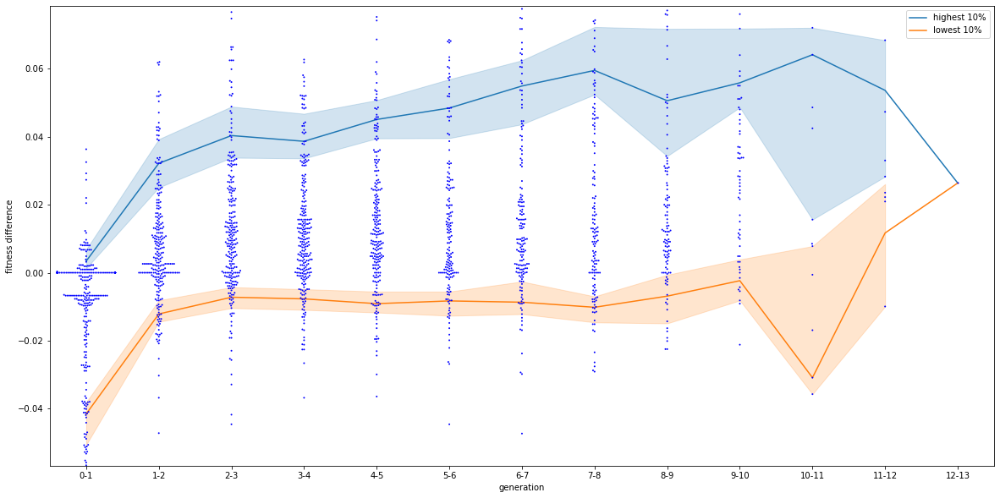

In [6]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
#ax.set_ylim([-0.2,0.3])

<ipython-input-10-fcea53c441df>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(50, height))


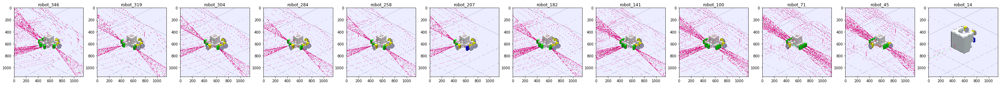

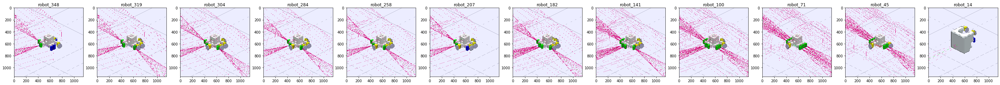

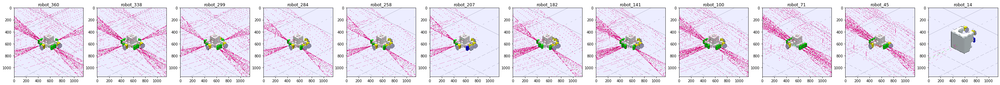

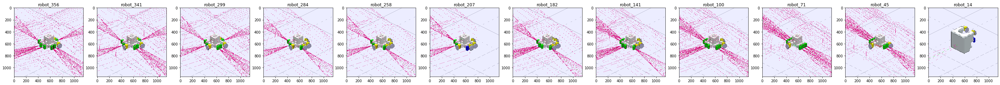

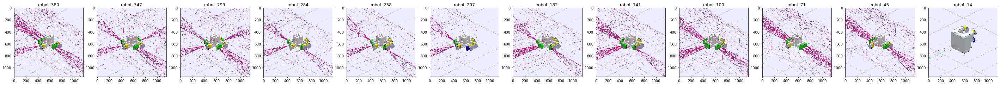

...

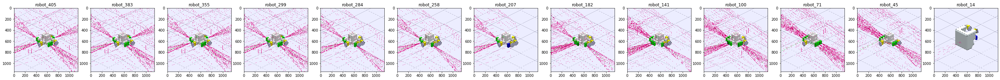

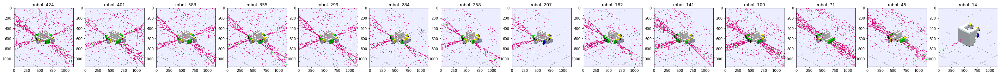

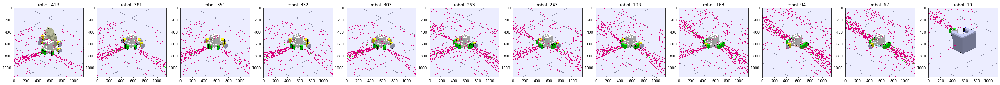

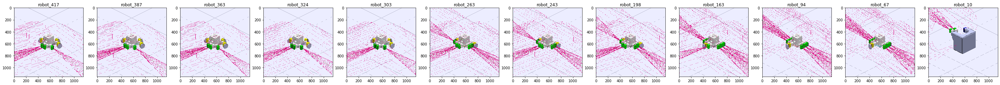

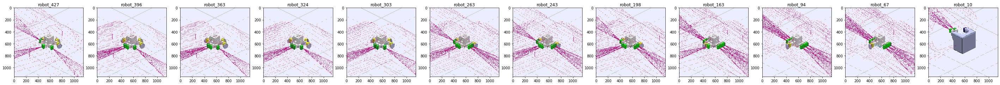

In [10]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/explo2/mnipes2_1_3_9-45-59-9592-4165327509/"

ids, fitnesses, parents = load_fitness(exp_folder + "/fitnesses.csv")
lineages = compute_lineage(ids,parents)    

for k,lin in lineages.items():
    if(len(lin)>10):
        images = []
        image_name = "robot_" + str(int(k)) + "_3.png"
        img = Image.open(exp_folder + "/images/" + image_name)
        images.append(img)
        for l in lin:
            image_name = "robot_" + str(int(l)) + "_3.png"
            img = Image.open(exp_folder + "/images/" + image_name)
            images.append(img)
        columns = len(images)
        height = len(images) * 50
        plt.figure(figsize=(50, height))
        lin =  [k] + lin
        for (i, image), l in zip(enumerate(images), lin):
            plt.subplot(int(len(images) / columns + 1), columns, i + 1)
            plt.title("robot_" + str(int(l)))
            plt.imshow(image)

<ipython-input-16-82fa0f02b27a>:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(50, height))


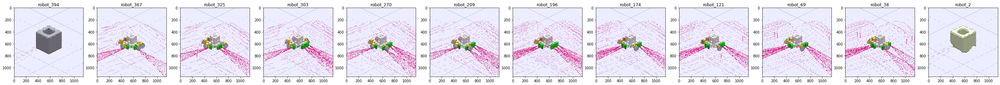

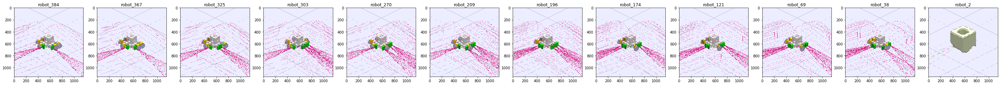

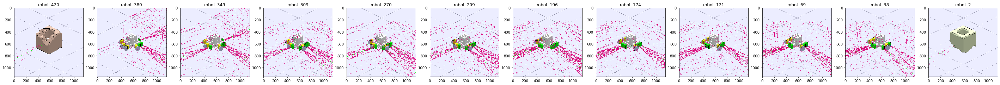

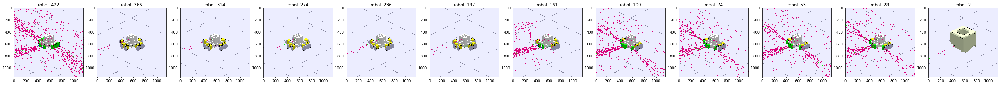

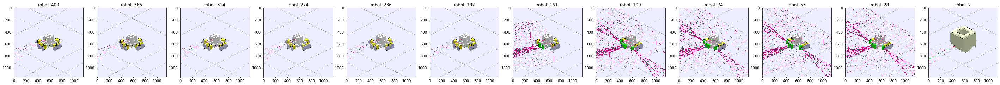

...

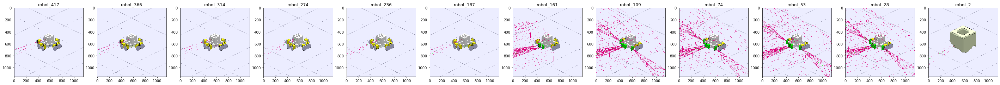

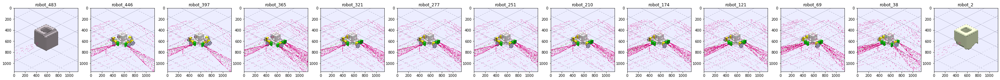

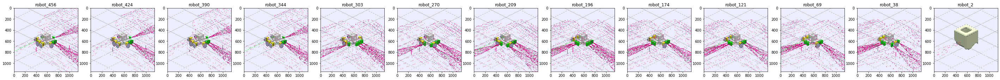

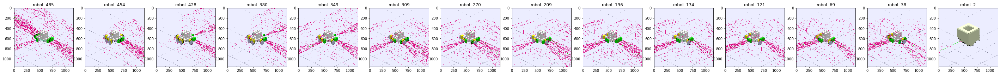

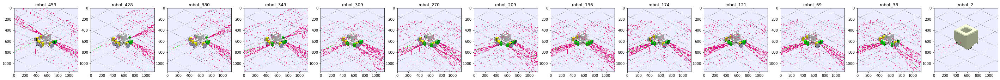

In [16]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/explo2/mnipes2_30_2_15-20-31-1383-507170923/"

ids, fitnesses, parents = load_fitness(exp_folder + "/fitnesses.csv")
lineages = compute_lineage(ids,parents)    
for k,lin in lineages.items():
    if(len(lin)>10):
        images = []
        image_name = "robot_" + str(int(k)) + "_3.png"
        img = Image.open(exp_folder + "/images/" + image_name)
        images.append(img)
        for l in lin:
            image_name = "robot_" + str(int(l)) + "_3.png"
            img = Image.open(exp_folder + "/images/" + image_name)
            images.append(img)
        columns = len(images)
        height = len(images) * 50
        plt.figure(figsize=(50, height))
        lin =  [k] + lin
        for (i, image), l in zip(enumerate(images), lin):
            plt.subplot(int(len(images) / columns + 1), columns, i + 1)
            plt.title("robot_" + str(int(l)))
            plt.imshow(image)

In [7]:
desc_lines = []
organ_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/baseline/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","baseline"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","baseline"])

In [8]:
desc_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/large_pop/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","large_pop"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","large_pop"])

<Figure size 360x360 with 0 Axes>

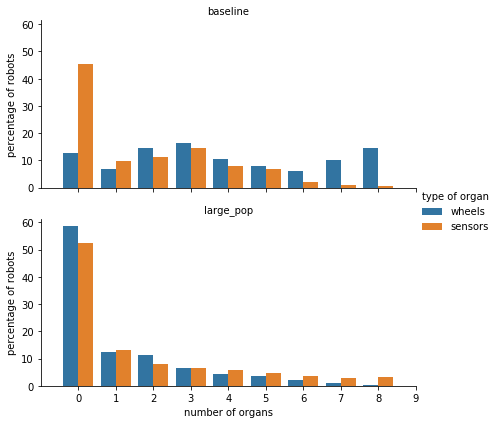

In [9]:
fig = plt.gcf()
fig.set_size_inches(5, 5)
organs_data = pd.DataFrame(data=organ_lines,columns=["number of organs","percentage of robots","type of organ","variant"])
g=sns.catplot(data=organs_data,x="number of organs",y="percentage of robots",hue="type of organ",col="variant",kind='bar',col_wrap=1,aspect=2,height=3)
(g.set_titles("{col_name}")
  .set(xlim=(-1, 9))) 

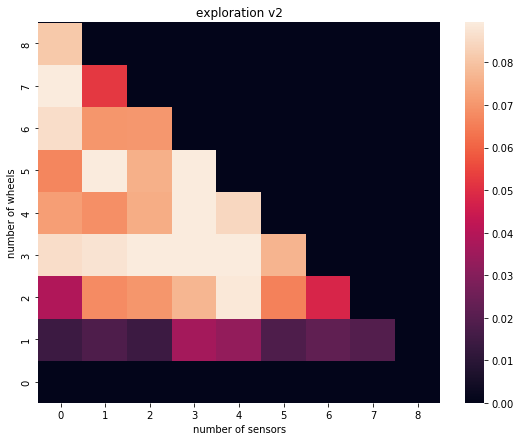

In [12]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/baseline/"
list_data = []
for folder in os.listdir(exp_folder):
    list_data.append(load_controller_archive(exp_folder + "/" + folder + "/controller_archive"))
    
data = pd.concat(list_data,ignore_index=True)
data = data.groupby(["number of wheels","number of sensors"]).max().squeeze().unstack()
#data = data.pivot(index="number of wheels",columns="number of sensors",values="fitness")
fig = plt.gcf()
fig.set_size_inches(9, 7)
ax = sns.heatmap(data,robust=True)#,vmin=0,vmax=0.2)
ax.set_ylim([0,9])
ax.set_xlim([0,9])
ax.set_title("exploration v2")
plt.show()

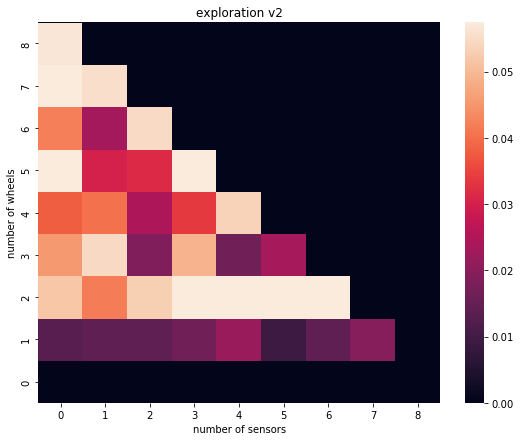

In [13]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/large_pop/"
list_data = []
for folder in os.listdir(exp_folder):
    list_data.append(load_controller_archive(exp_folder + "/" + folder + "/controller_archive"))
    
data = pd.concat(list_data,ignore_index=True)
data = data.groupby(["number of wheels","number of sensors"]).max().squeeze().unstack()
#data = data.pivot(index="number of wheels",columns="number of sensors",values="fitness")
fig = plt.gcf()
fig.set_size_inches(9, 7)
ax = sns.heatmap(data,robust=True)#,vmin=0,vmax=0.2)
ax.set_ylim([0,9])
ax.set_xlim([0,9])
ax.set_title("exploration v2")
plt.show()

## V.4 Behaviours

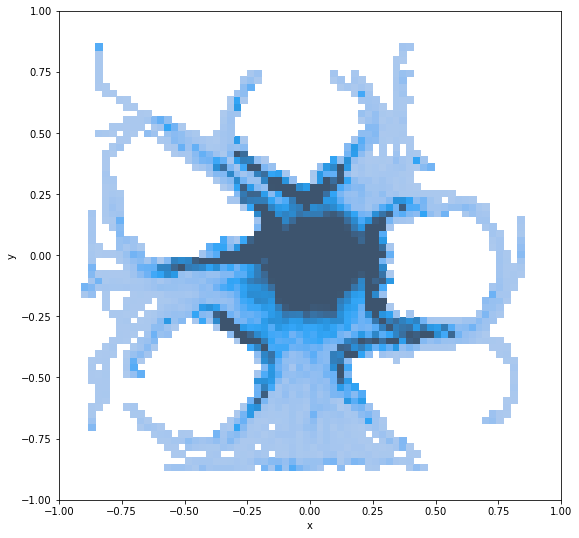

In [17]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/baseline/"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] == "traj" and file.split("_")[2] == "0"):
            trajectory += load_trajectory(exp_folder + "/" + folder + "/" + file)

data = pd.DataFrame(data=trajectory,columns=["t","x","y","z"]) 
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.3)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

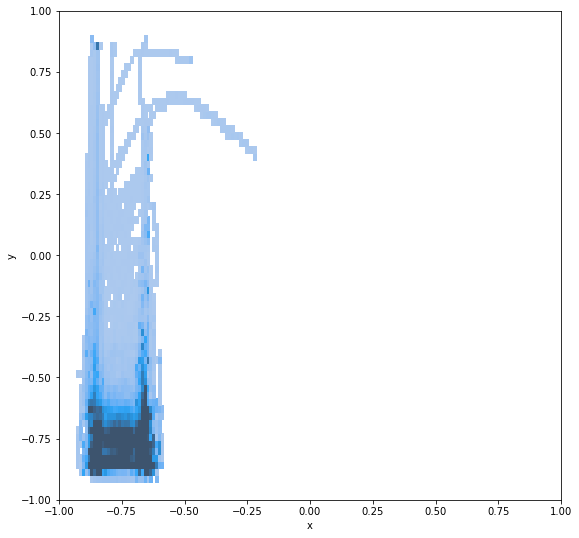

In [18]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/baseline/"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] == "traj" and file.split("_")[2] == "1"):
            trajectory += load_trajectory(exp_folder + "/" + folder + "/" + file)

data = pd.DataFrame(data=trajectory,columns=["t","x","y","z"]) 
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.3)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

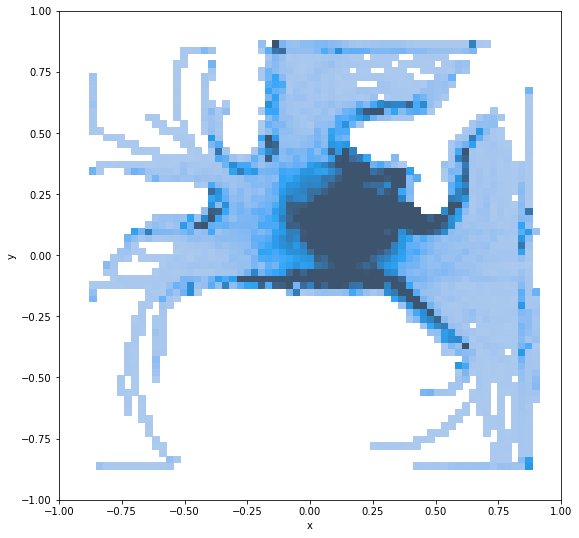

In [19]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/multi_explo/baseline/"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] == "traj" and file.split("_")[2] == "2"):
            trajectory += load_trajectory(exp_folder + "/" + folder + "/" + file)

data = pd.DataFrame(data=trajectory,columns=["t","x","y","z"]) 
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.3)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

# II Obstacles
## II.1 Quality

9


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 55.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 34.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 8.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


Text(0.5, 1.0, 'exploration - obstacles')

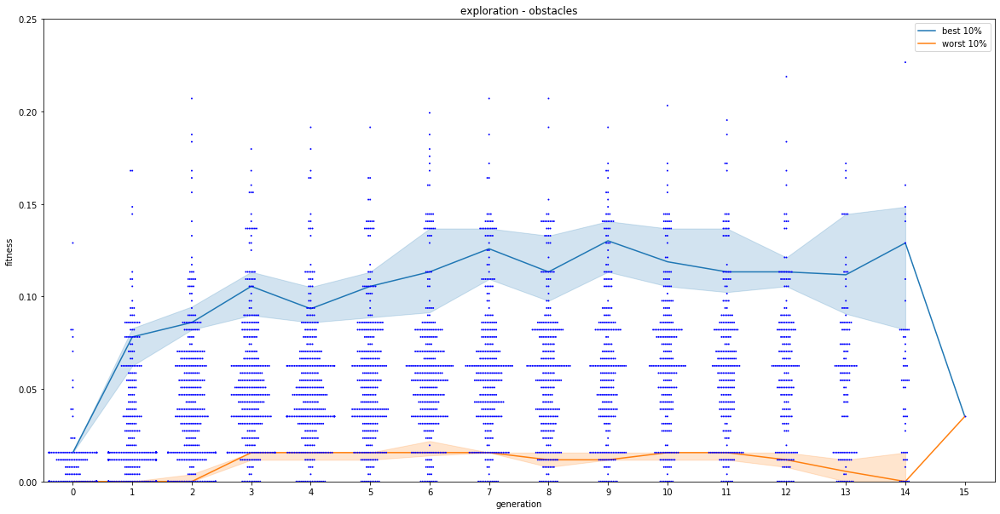

In [2]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/baseline/"
lines = []
i = 0
for folder in os.listdir(exp_folder):
    i+=1
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([_id,fit,gen])
print(i)
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_ylim([0,0.25])
ax.set_title("exploration - obstacles")

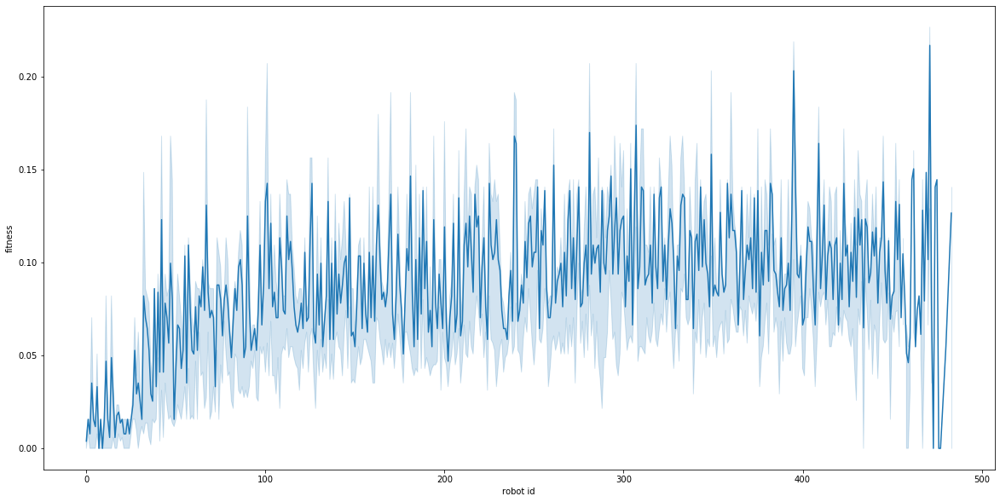

In [3]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc_high)

4


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 53.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 42.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 21.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


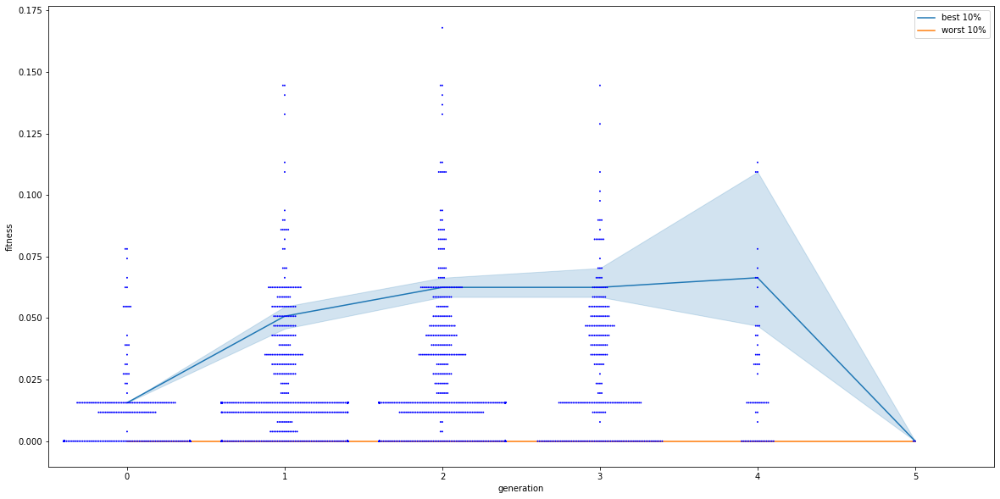

In [3]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/largepop/"
lines = []
i=0
for folder in os.listdir(exp_folder):
    i+=1
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    
    for id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([id,fit,gen])
print(i)
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")

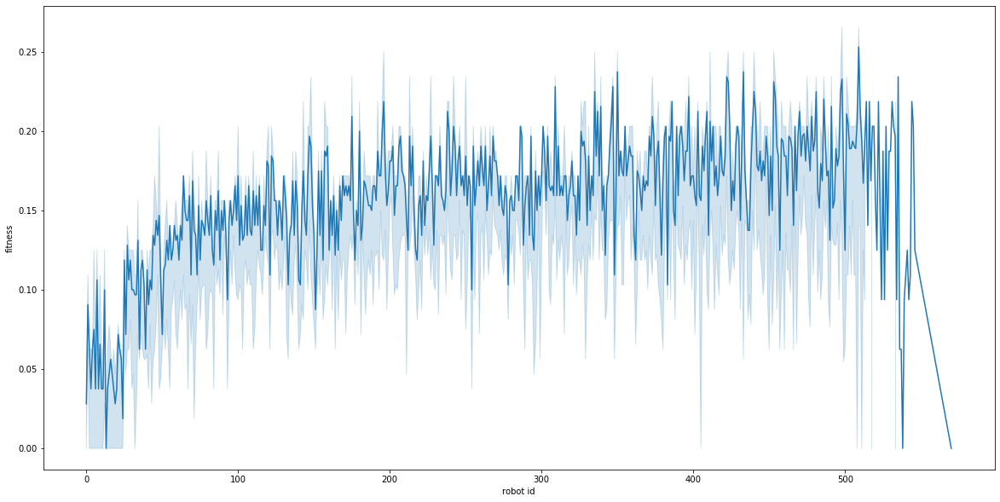

In [5]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc)

6


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 47.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 47.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 34.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 24.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 10.7

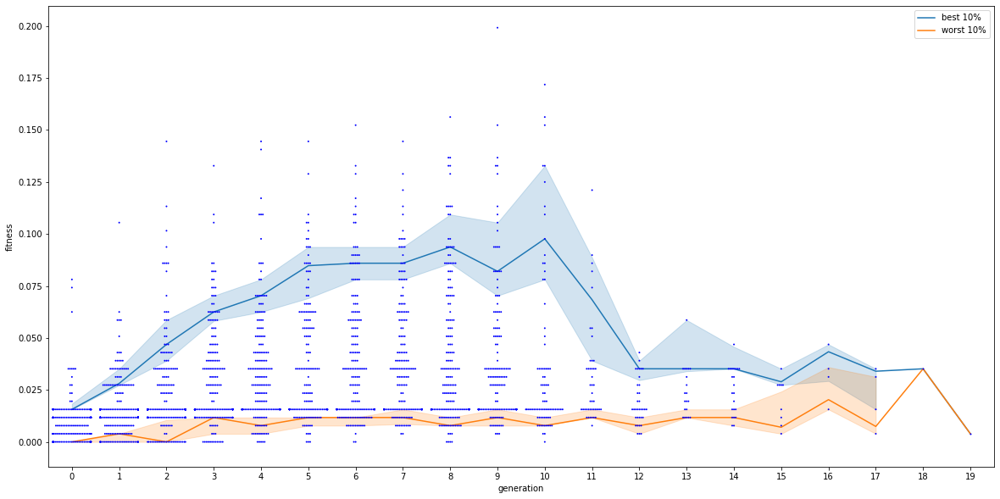

In [4]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/crossover/"
lines = []
i=0
for folder in os.listdir(exp_folder):
    i+=1
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    
    for id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([id,fit,gen])
print(i)
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")

1


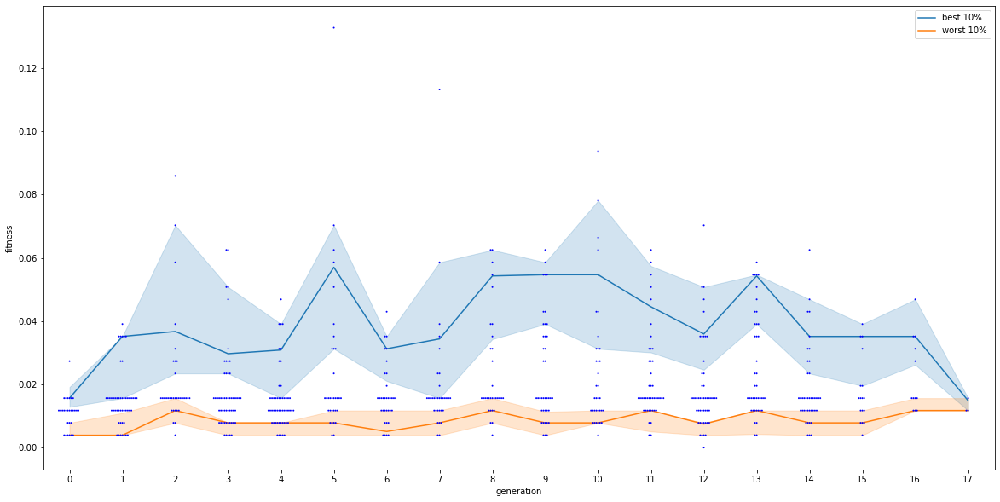

In [5]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/learning/"
lines = []
i=0
for folder in os.listdir(exp_folder):
    i+=1
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    
    for id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([id,fit,gen])
print(i)
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")

## II.2 Diversity

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 34.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 37.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 39.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 36.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 38.5

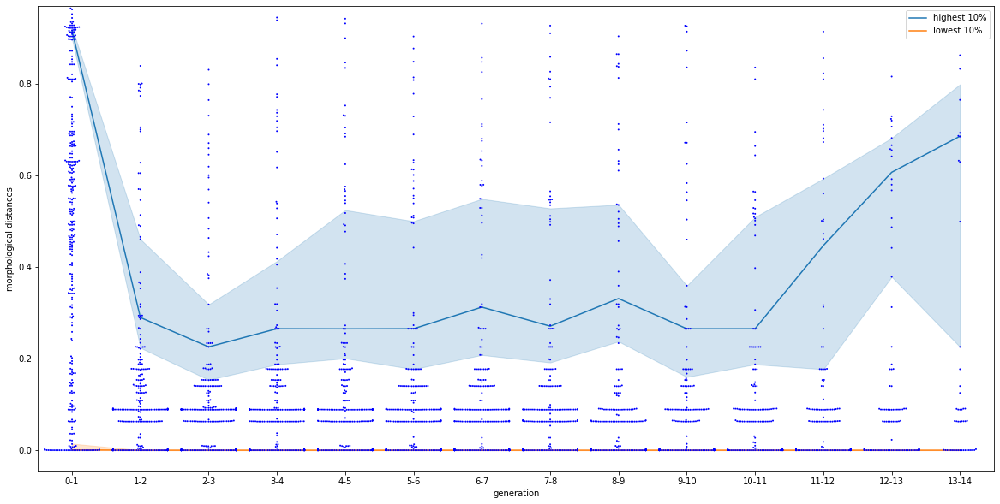

In [10]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/baseline/"
lines = []

for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)
    
    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 22.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 11.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


Text(0.5, 1.0, 'exploration - obstacles')

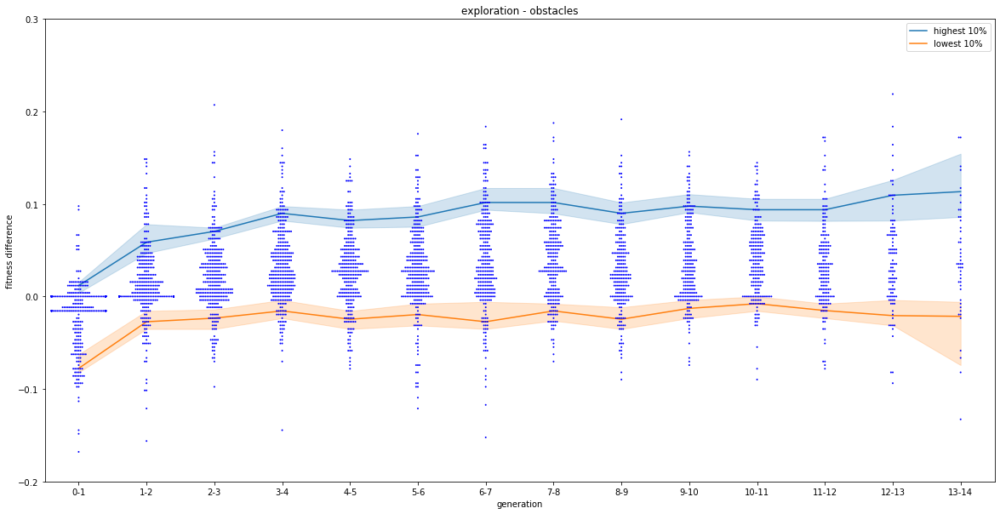

In [11]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.2,0.3])
ax.set_title("exploration - obstacles")

{48.0: [], 97.0: [], 87.0: [], 18.0: [], 25.0: [], 11.0: [], 56.0: [], 80.0: [], 61.0: [], 68.0: [], 83.0: [], 53.0: [], 82.0: [], 62.0: [], 65.0: [], 90.0: [], 64.0: [], 26.0: [], 32.0: [], 84.0: [], 91.0: [], 69.0: [], 99.0: [], 67.0: [], 31.0: [], 54.0: [], 40.0: [], 37.0: [], 73.0: [], 29.0: [], 4.0: [], 81.0: [], 30.0: [], 58.0: [], 39.0: [], 86.0: [], 79.0: [], 33.0: [], 8.0: [], 59.0: [], 43.0: [], 28.0: [], 93.0: [], 34.0: [], 24.0: [], 75.0: [], 23.0: [], 77.0: [], 17.0: [], 16.0: [], 21.0: [], 20.0: [], 13.0: [], 78.0: [], 44.0: [], 3.0: [], 94.0: [], 45.0: [], 27.0: [], 14.0: [], 9.0: [], 42.0: [], 10.0: [], 70.0: [], 5.0: [], 74.0: [], 76.0: [], 19.0: [], 89.0: [], 66.0: [], 52.0: [], 60.0: [], 88.0: [], 7.0: [], 12.0: [], 41.0: [], 96.0: [], 1.0: [], 71.0: [], 50.0: [], 49.0: [], 15.0: [], 36.0: [], 95.0: [], 46.0: [], 57.0: [], 35.0: [], 38.0: [], 92.0: [], 6.0: [], 63.0: [], 2.0: [], 72.0: [], 0.0: [], 85.0: [], 98.0: [], 51.0: [], 47.0: [], 55.0: [], 22.0: [], 108.0: [4

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 19.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 11.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


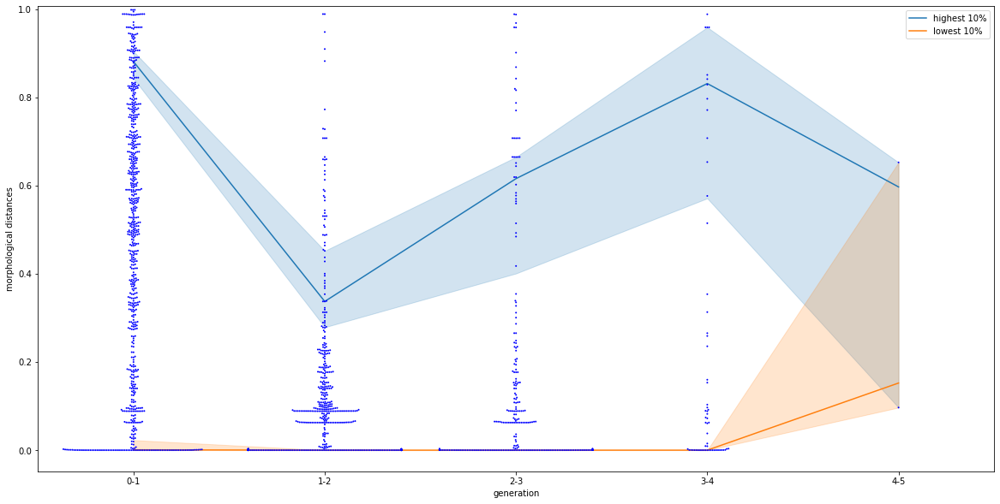

In [31]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/largepop/"
lines = []

for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)
    print(lineages)
    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 27.7% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 21.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


(-0.2, 0.3)

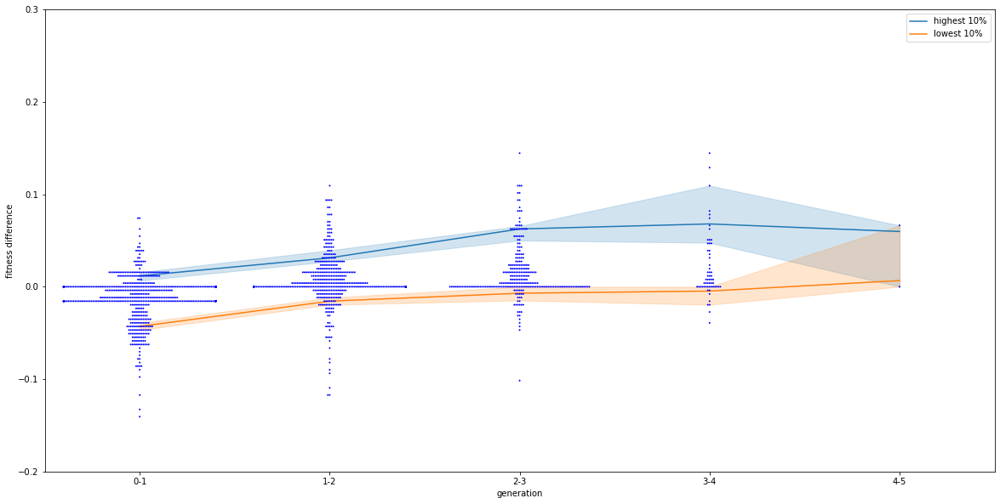

In [14]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.2,0.3])

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 8.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 16.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 15.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 19.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 22.2%

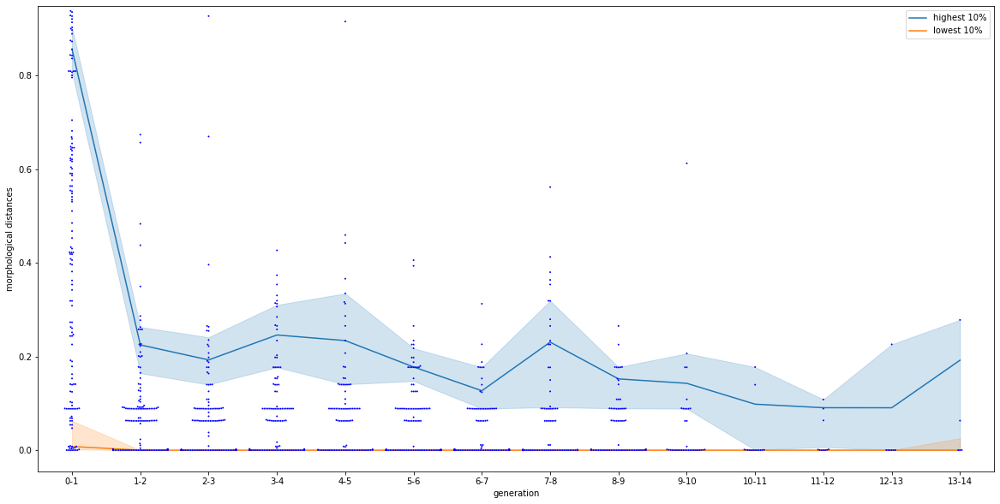

In [15]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/crossover/"
lines = []

for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 7.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 15.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


(-0.2, 0.3)

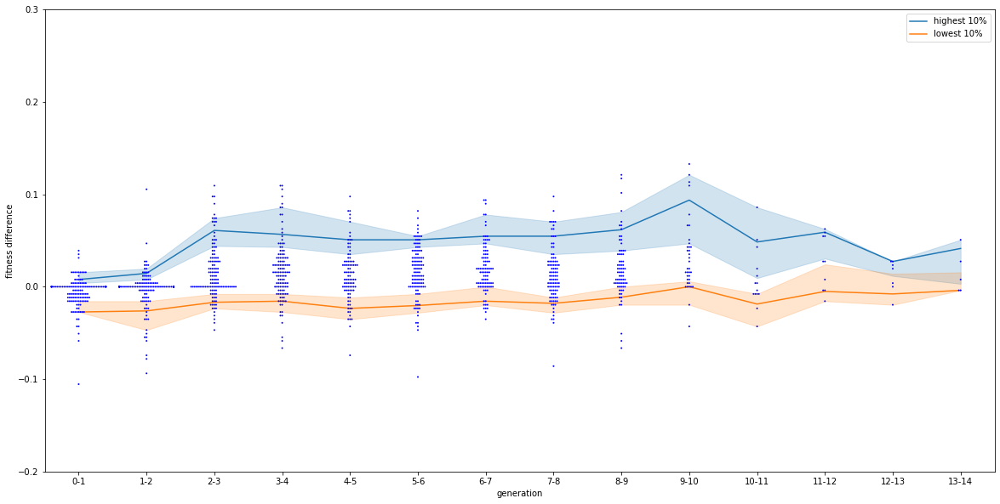

In [16]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.2,0.3])

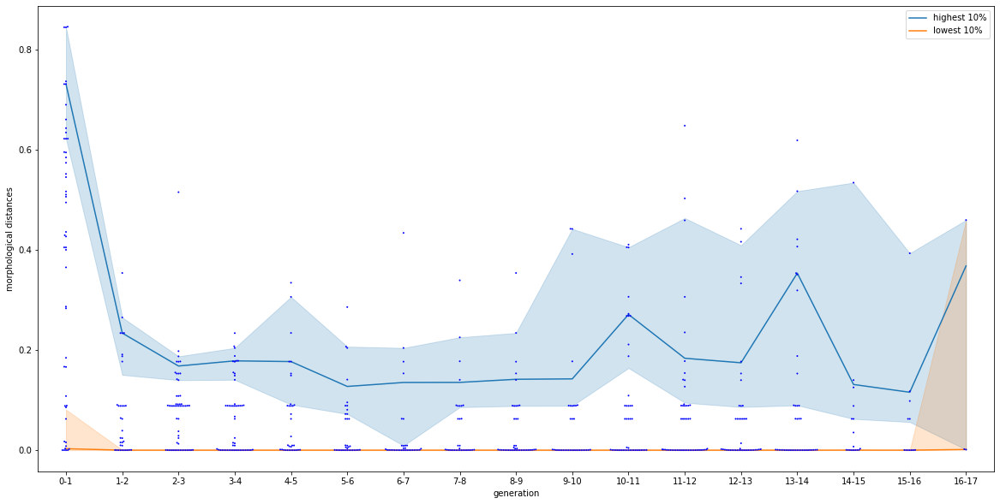

In [17]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/learning/"
lines = []

for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)

    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

(-0.2, 0.3)

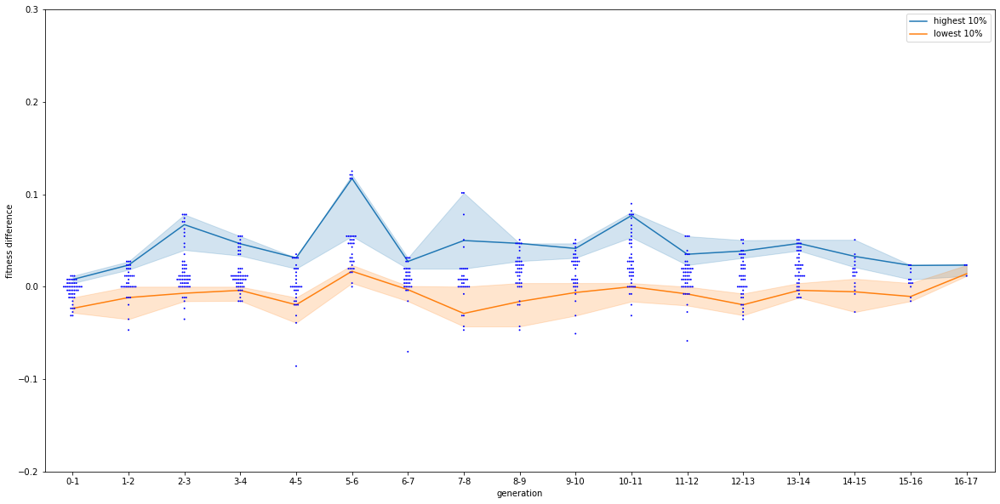

In [18]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_ylim([-0.2,0.3])

In [22]:
desc_lines = []
organ_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/baseline/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","baseline"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","baseline"])

In [23]:
desc_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/largepop/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","largepop"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","largepop"])

In [24]:
desc_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/crossover/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","crossover"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","crossover"])

In [25]:
desc_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/learning/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","learning"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","learning"])

<Figure size 360x360 with 0 Axes>

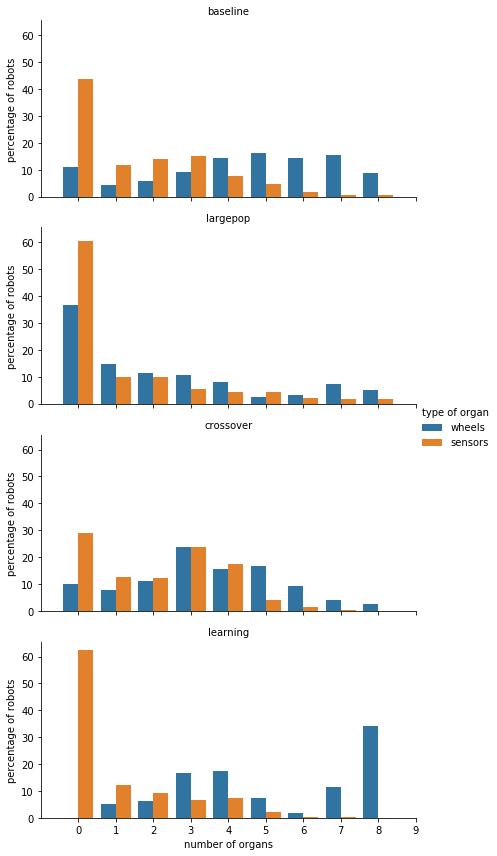

In [26]:
fig = plt.gcf()
fig.set_size_inches(5, 5)
organs_data = pd.DataFrame(data=organ_lines,columns=["number of organs","percentage of robots","type of organ","variant"])
g=sns.catplot(data=organs_data,x="number of organs",y="percentage of robots",hue="type of organ",col="variant",kind='bar',col_wrap=1,aspect=2,height=3)
(g.set_titles("{col_name}")
  .set(xlim=(-1, 9)))

## II.3 Efficiency

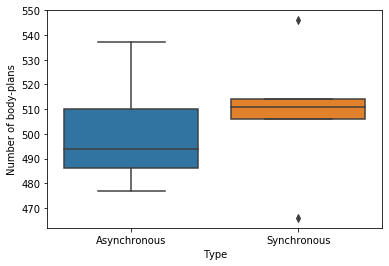

In [15]:
exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/async/"
lines = []
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lines.append([len(ids),"Asynchronous"])

exp_folder = "/home/leni/are-logs/mnipes2_preexp3/obst/synch/"
for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lines.append([len(ids),"Synchronous"])

data = pd.DataFrame(data=lines,columns=["Number of body-plans","Type"])
sns.boxplot(data=data,x="Type",y="Number of body-plans")

## II.4 Behaviours

         id    t         x         y         z
0       168    0  0.000000  0.000000  0.120000
1       168    1  0.001850 -0.001948  0.072952
2       168    2  0.004659 -0.000642  0.073251
3       168    3  0.006170  0.003196  0.073313
4       168    4  0.008395  0.006056  0.073241
...     ...  ...       ...       ...       ...
905915  336  299  0.030949 -0.081522  0.081529
905916  336  300  0.031350 -0.078033  0.081464
905917  336  301  0.031560 -0.076799  0.081518
905918  336  302  0.031921 -0.075677  0.081519
905919  336  303  0.032132 -0.074373  0.081505

[905920 rows x 5 columns]


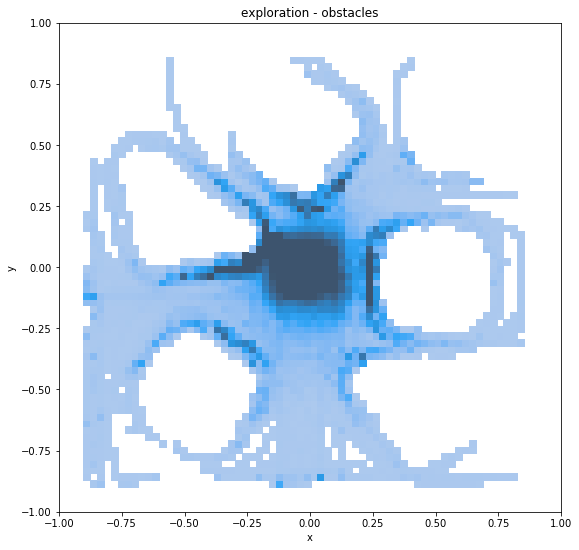

In [27]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/baseline"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        j = find_index(_id,ids)
        if(j == None):
            continue
        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        traj = [[_id] + t for t in traj]
        trajectory += traj

data = pd.DataFrame(data=trajectory,columns=["id","t","x","y","z"]) 
print(data)
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.5)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
ax.set_title("exploration - obstacles")
plt.show()

In [33]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/baseline/mnipes2_22_3_10-28-45-5661-2023224784/traj_330_0"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)

traj = load_trajectory(exp_folder)
traj = [[_id] + t for t in traj]
init_pos = traj[0]
for t in 
data = pd.DataFrame(data=traj,columns=["id","t","x","y","z"])
print(data)
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.5)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
ax.set_title("exploration - obstacles")
plt.show()

SyntaxError: invalid syntax (<ipython-input-33-08fe230dcef7>, line 10)

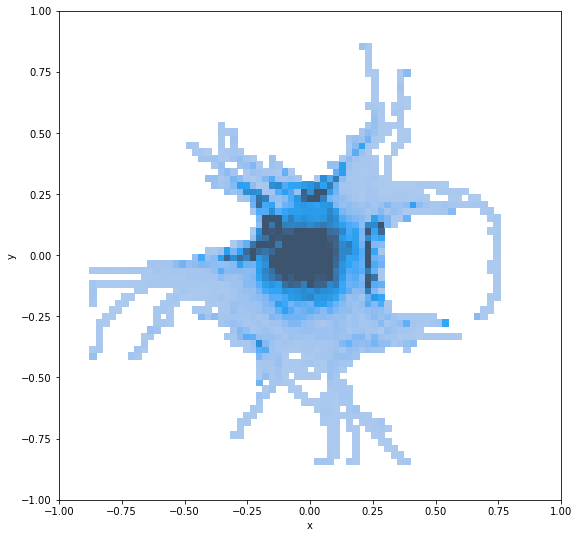

In [28]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/largepop/"
trajectory = []
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        j = find_index(_id,ids)
        if(j == None):
            continue

        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        traj = [[_id] + t for t in traj]
        trajectory += traj

data = pd.DataFrame(data=trajectory,columns=["id","t","x","y","z"]) 
fig = plt.gcf()
fig.set_size_inches(9, 9)
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.5)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

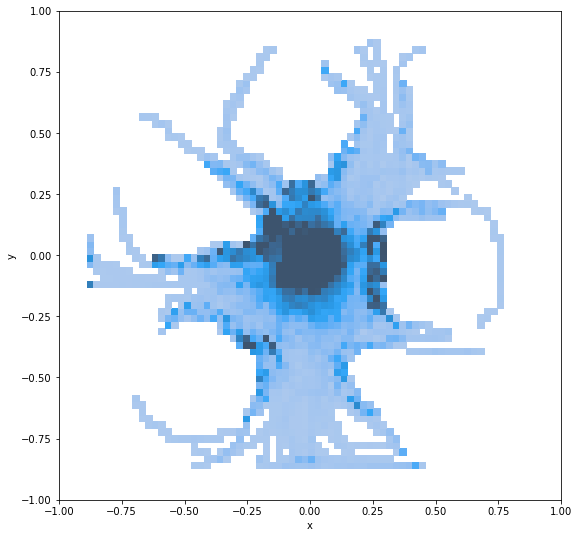

In [29]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/crossover/"
trajectory = []
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        j = find_index(_id,ids)
        if(j == None):
            continue

        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        traj = [[_id] + t for t in traj]
        trajectory += traj

data = pd.DataFrame(data=trajectory,columns=["id","t","x","y","z"]) 
fig = plt.gcf()
fig.set_size_inches(9, 9)
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.5)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

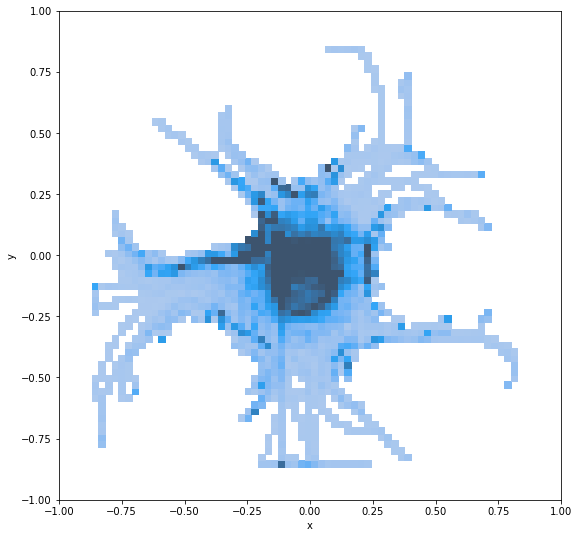

In [30]:
exp_folder = "/home/leni/are-logs/mnipes2_diversity/explo/learning/"
trajectory = []
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        j = find_index(_id,ids)
        if(j == None):
            continue

        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        traj = [[_id] + t for t in traj]
        trajectory += traj

data = pd.DataFrame(data=trajectory,columns=["id","t","x","y","z"]) 
fig = plt.gcf()
fig.set_size_inches(9, 9)
ax = sns.histplot(data=data,x="x",y="y",bins=64,legend=False,pmax=0.5)
ax.set_xlim([-1,1])
ax.set_ylim([-1,1])
plt.show()

# Gradual Navigation
## Quality

6


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 68.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 62.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 49.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 36.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 26.5

Text(0.5, 1.0, 'exploration - obstacles')

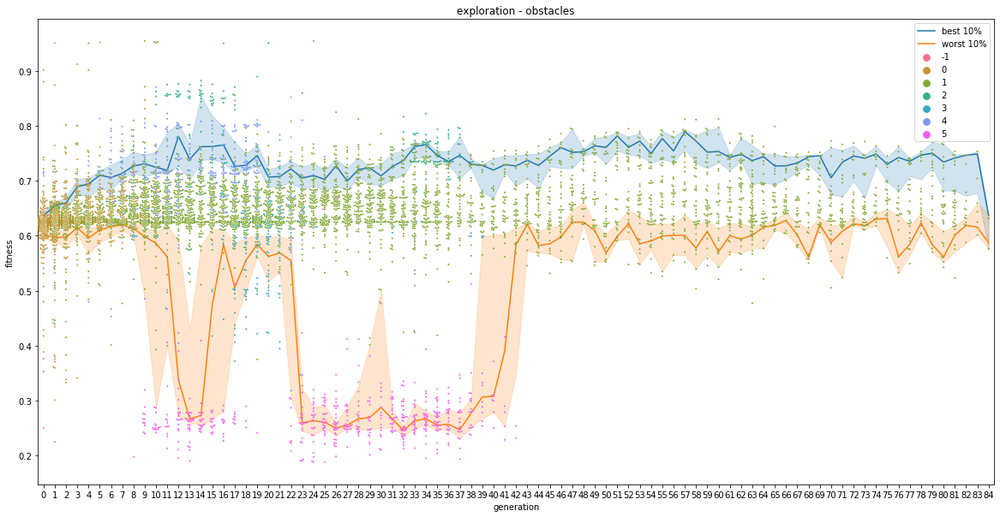

In [50]:
exp_folder = "/home/leni/are-logs/mnipes_gradual"
colors = sns.color_palette("husl", 7)
lines = []
i = 0
fig.set_size_inches(9, 9)
   
for folder in os.listdir(exp_folder):
    i+=1
    id_env = dict()
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        env = int(file.split("_")[2])
        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        if(len(traj) > 0):
            if _id in id_env:
                if env > id_env[_id]:
                    id_env[_id] = env
            else:
                id_env[_id] = env
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        if(not _id in id_env):
            lines.append([_id,fit,gen,-1])
        else:
            lines.append([_id,fit,gen,id_env[_id]])             
            
print(i)
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation","env"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",hue="env",size=2,color='b',palette=colors)
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("exploration - obstacles")

mnipes2_16_4_12-39-11-1472-2082788028


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 50.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 35.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 30.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 7.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 6.4% 

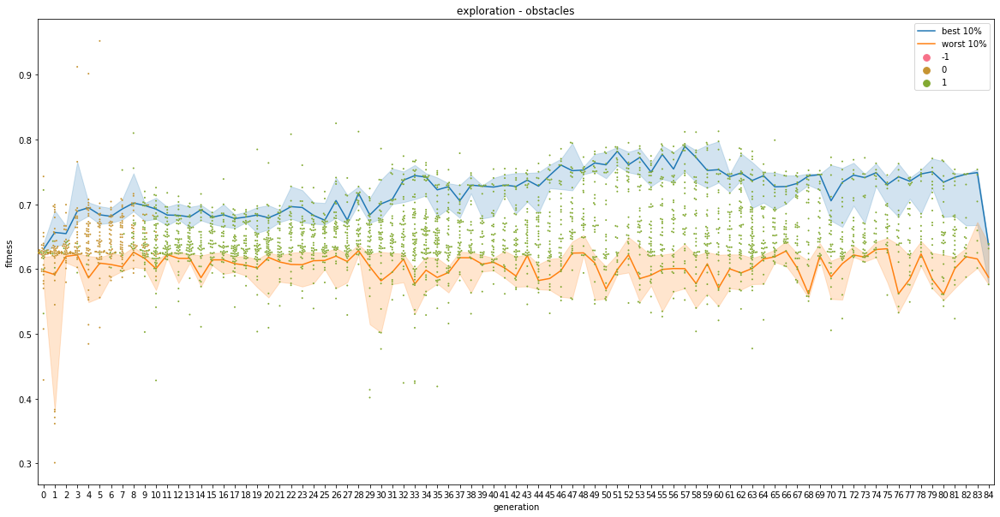

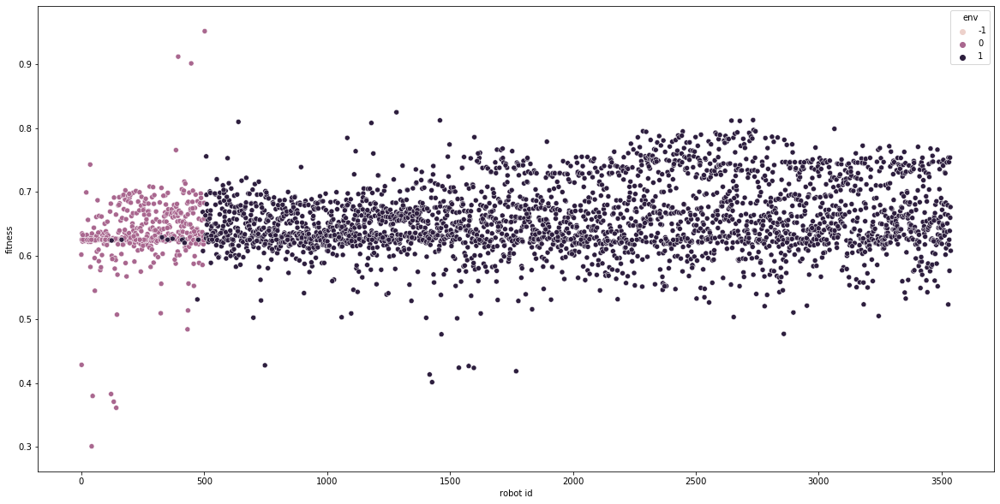

mnipes2_16_4_12-39-2-2720-4285182045


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 9.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 8.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


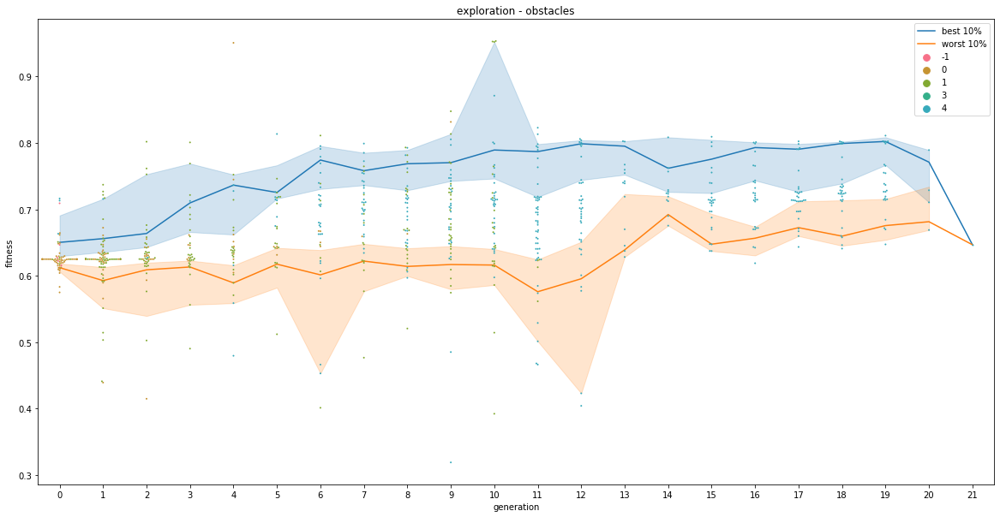

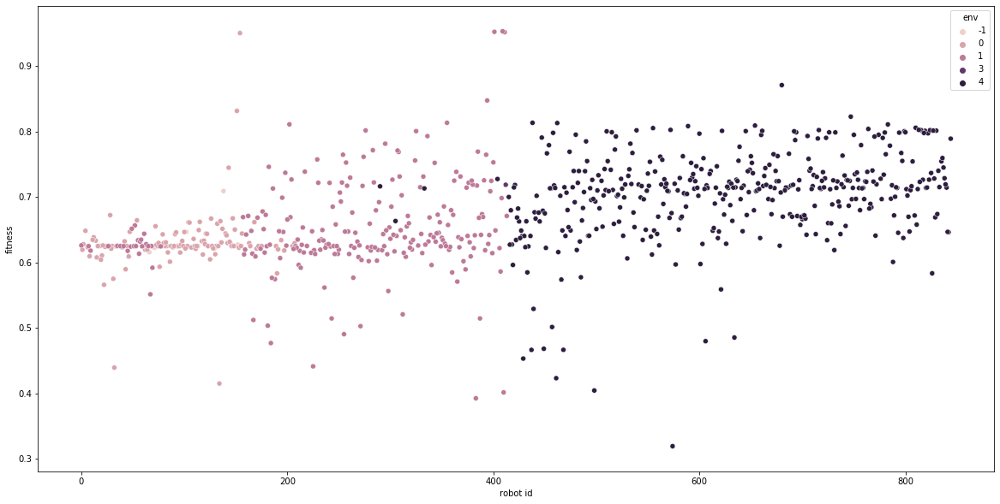

mnipes2_16_4_12-39-1-1783-3311075136


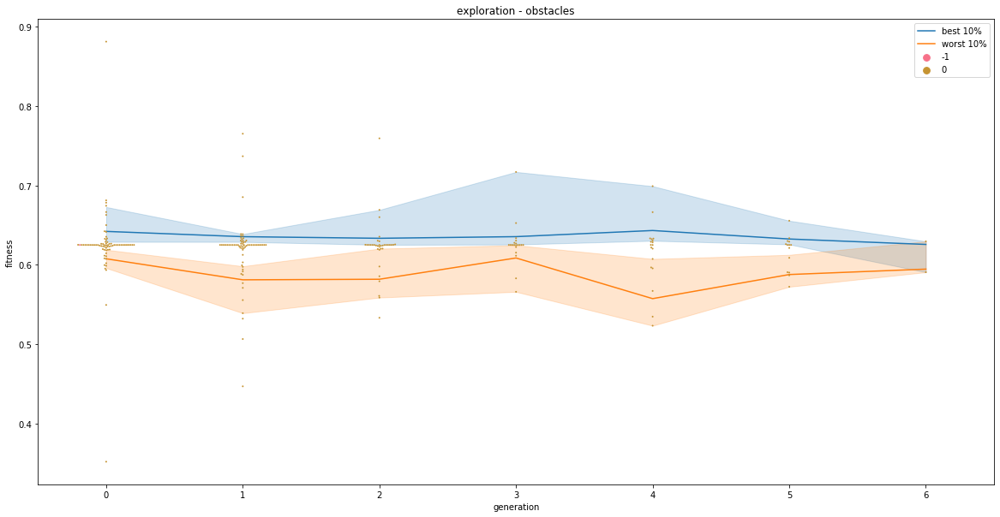

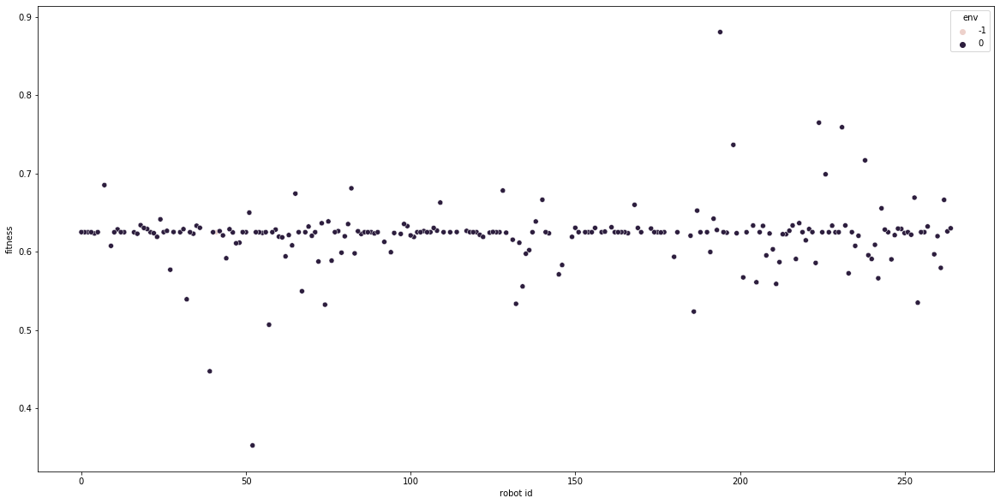

mnipes2_16_4_12-39-1-1770-405870621


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 33.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 21.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 6.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 9.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 9.9% o

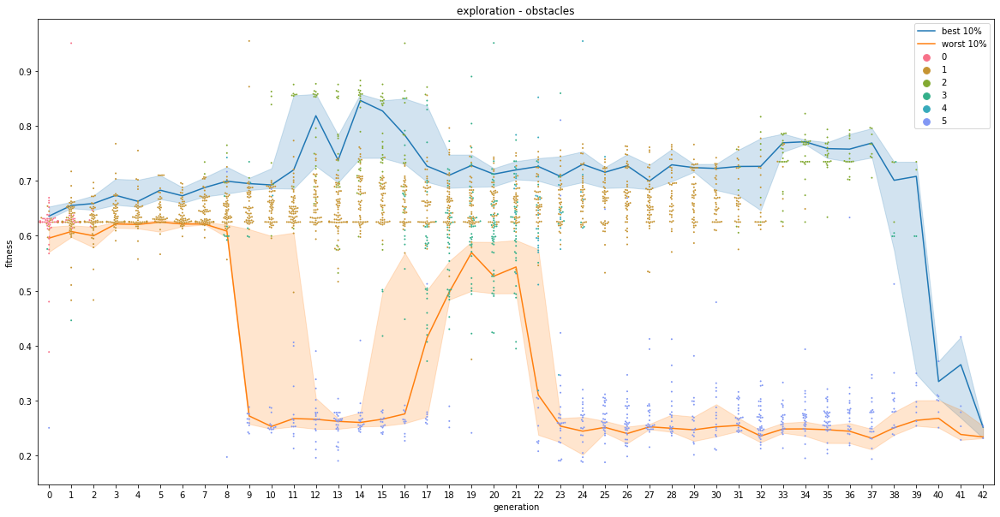

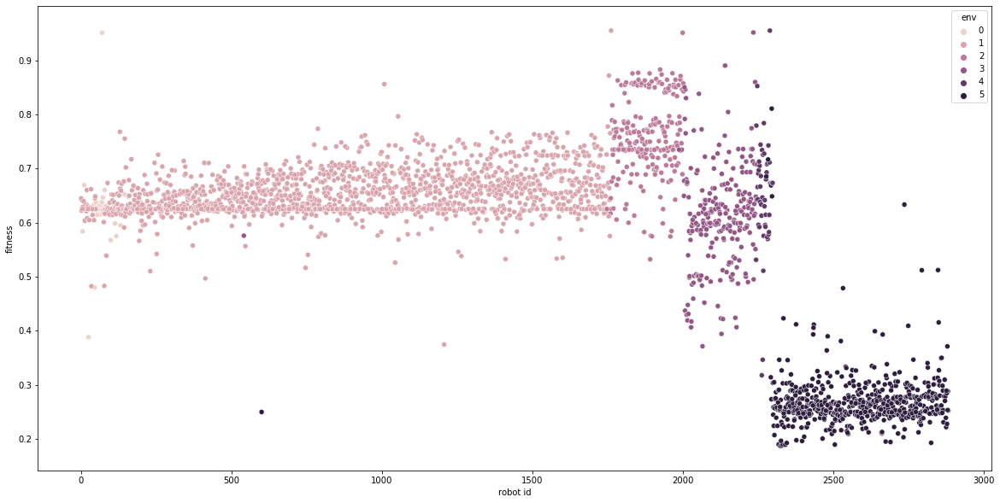

mnipes2_16_4_12-41-18-8755-1707617746


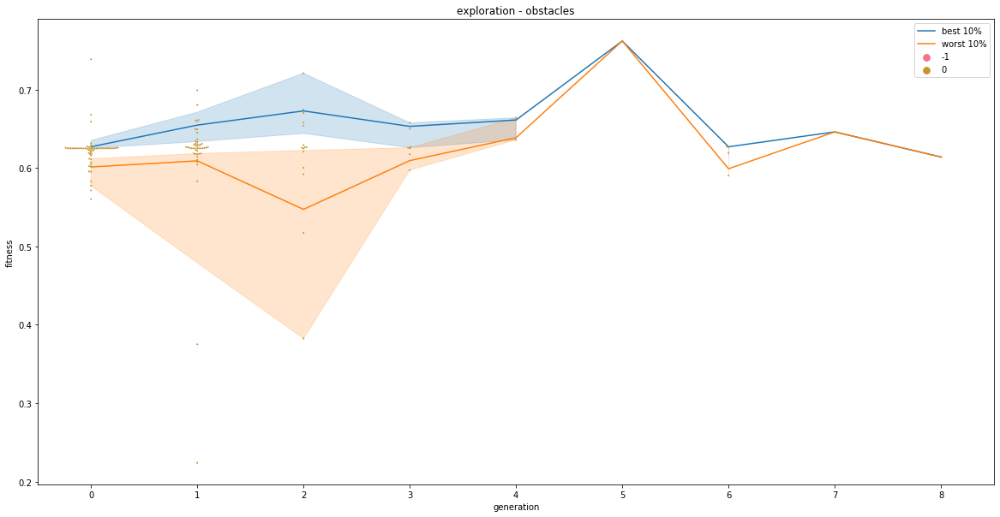

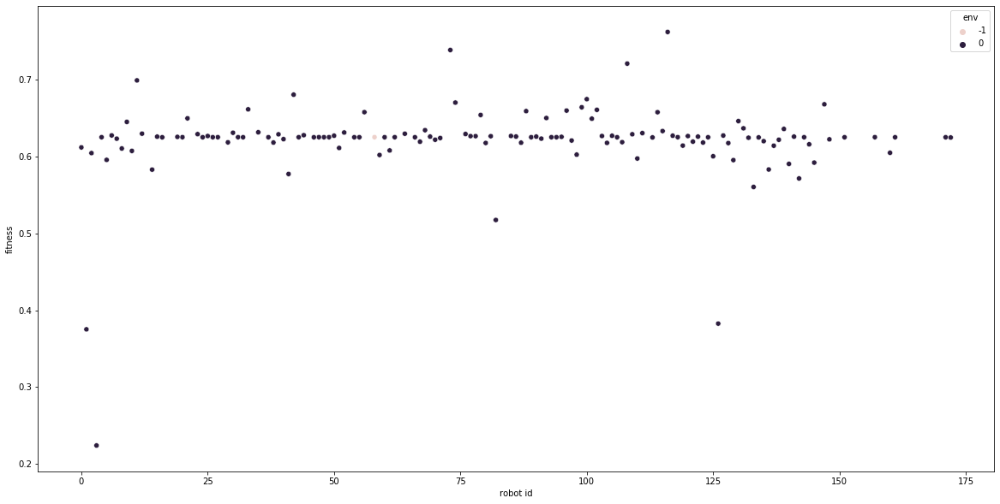

mnipes2_16_4_12-41-18-8776-2677559111


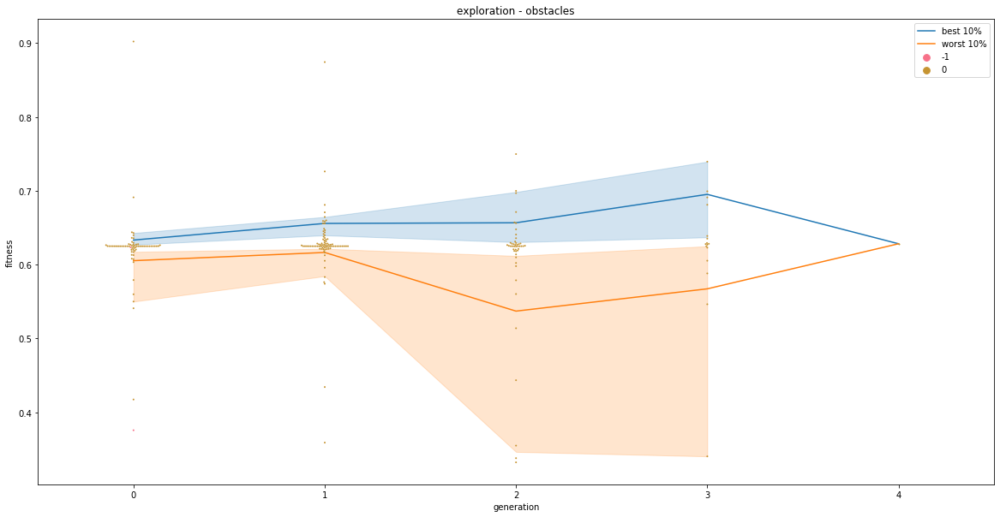

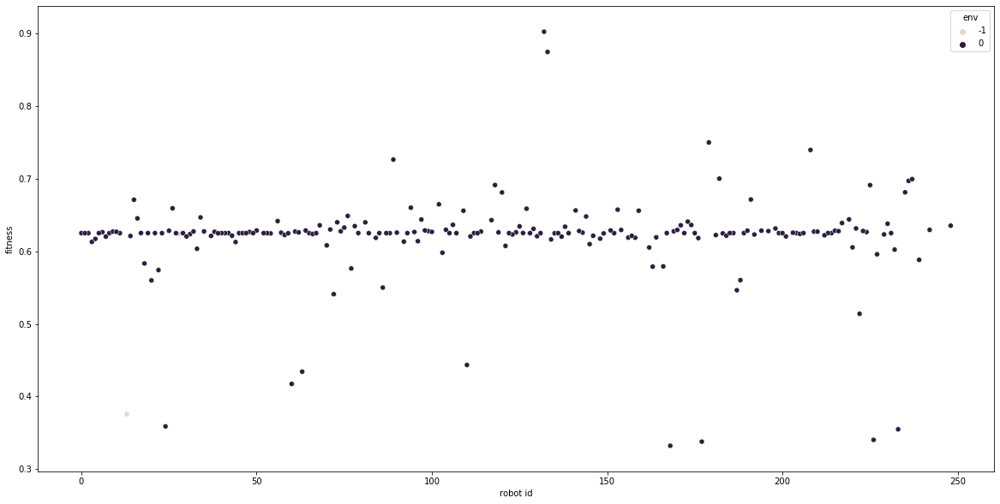

In [74]:
exp_folder = "/home/leni/are-logs/mnipes_gradual"
for folder in os.listdir(exp_folder):
    print(folder)
    lines = []
    id_env = dict()
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        env = int(file.split("_")[2])
        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        if(len(traj) > 0):
            if _id in id_env:
                if env > id_env[_id]:
                    id_env[_id] = env
            else:
                id_env[_id] = env
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        if(not _id in id_env):
            lines.append([_id,fit,gen,-1])
        else:
            lines.append([_id,fit,gen,id_env[_id]])
    data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation","env"]) 
    data.drop_duplicates()
    fig = plt.gcf()
    fig.set_size_inches(20,10)
    ax = sns.swarmplot(data=data,x="generation",y="fitness",hue="env",size=2,color='b',palette=colors)
    sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
    sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
    ax.set_title("exploration - obstacles")
    plt.show()
    fig = plt.gcf()
    fig.set_size_inches(20,10)
    sns.scatterplot(data=data,x="robot id",y="fitness",hue="env")
    plt.show()

      robot id   fitness  generation        env
0         56.0  0.619833           0      arena
1         25.0  0.631133           0      arena
2         66.0  0.631268           0      arena
3         24.0  0.388252           0      arena
4          5.0  0.583790           0      arena
...        ...       ...         ...        ...
2715    2878.0  0.284867          36  hard race
2716    2879.0  0.228026          41  hard race
2717    2877.0  0.289287          18  hard race
2718    2883.0  0.252837          41  hard race
2719    2881.0  0.253668          39  hard race

[2720 rows x 4 columns]


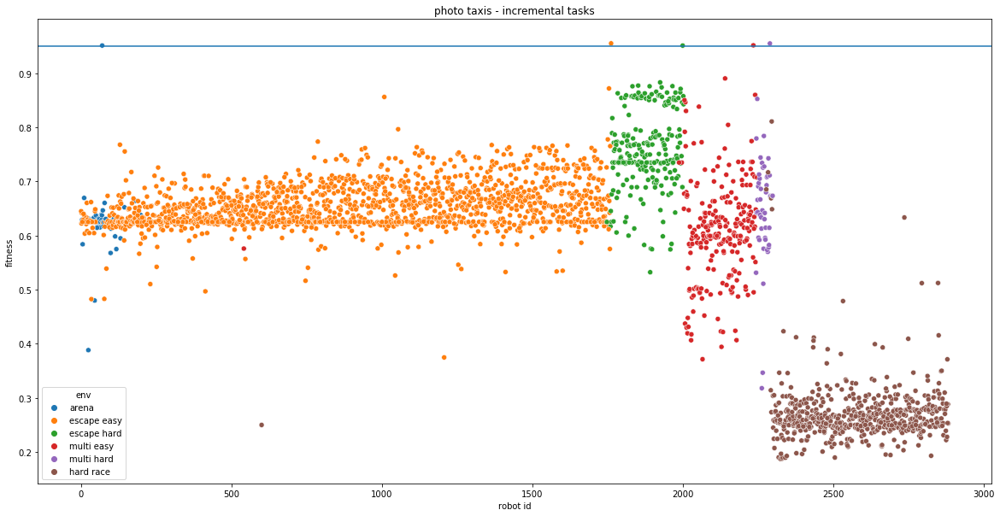

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 45.3% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 30.0% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 16.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 22.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 17.0

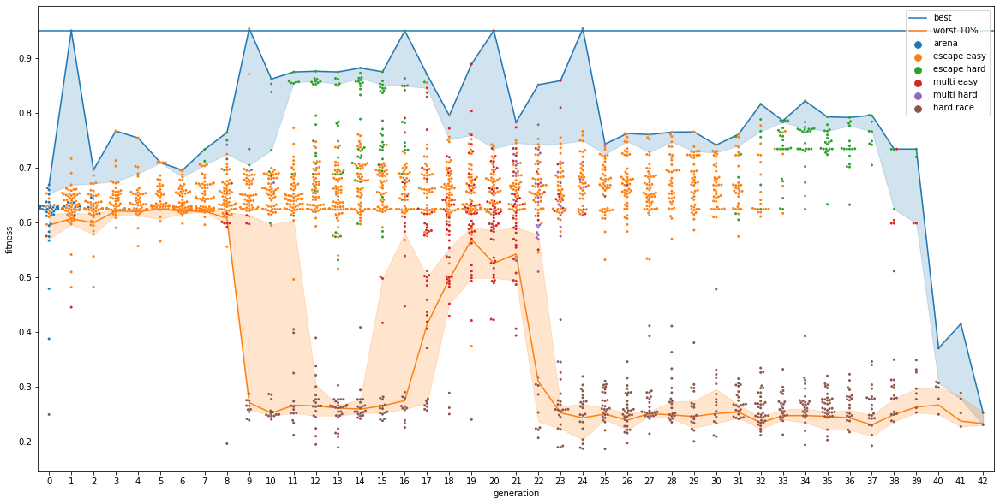

In [3]:
exp_folder = "/home/leni/are-logs/mnipes_gradual/mnipes2_16_4_12-39-1-1770-405870621/"
env_name = ["arena","escape easy","escape hard","multi easy","multi hard","hard race"]
lines = []
id_env = dict()
for file in os.listdir(exp_folder):
    if(file.split("_")[0] != "traj"):
        continue
    _id = int(file.split("_")[1])
    env = int(file.split("_")[2])
    traj = load_trajectory(exp_folder + "/" + file)
    if(len(traj) > 0):
        if _id in id_env:
            if env > id_env[_id]:
                id_env[_id] = env
        else:
            id_env[_id] = env
ids, fitnesses, parents = load_fitness(exp_folder + "/fitnesses.csv")
generation = compute_generation(ids,parents)
for _id, fit, gen in zip(ids,fitnesses,generation):
    if(not _id in id_env):
        lines.append([_id,fit,gen,-1])
    else:
        lines.append([_id,fit,gen,env_name[id_env[_id]]])
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation","env"]) 
print(data)
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.scatterplot(data=data,x="robot id",y="fitness",hue="env",palette=sns.color_palette(n_colors=6))
ax.axhline([0.95])
ax.set_title("photo taxis - incremental tasks")
plt.show()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",hue="env",size=3,color='b',palette=sns.color_palette(n_colors=6))
ax.axhline([0.95])
sns.lineplot(data=data,x="generation",y="fitness",estimator=max,label="best")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
plt.show()

In [14]:
d = data[data["env"] == "hard race"]
dd = d[d["fitness"] > 0.6]
print(dd)
d = data[data["env"] == "arena"]
dd = d[d["fitness"] > 0.9]
print(dd)
d = data[data["env"] == "escape easy"]
dd = d[d["fitness"] > 0.9]
print(dd)
d = data[data["env"] == "escape hard"]
dd = d[d["fitness"] > 0.9]
print(dd)
d = data[data["env"] == "multi easy"]
dd = d[d["fitness"] > 0.9]
print(dd)
d = data[data["env"] == "multi hard"]
dd = d[d["fitness"] > 0.9]
print(dd)

      robot id   fitness  generation        env
2158    2294.0  0.668756          26  hard race
2159    2296.0  0.810629          23  hard race
2160    2298.0  0.673183          23  hard race
2162    2297.0  0.648505          25  hard race
2163    2278.0  0.685090          10  hard race
2164    2284.0  0.716619           8  hard race
2579    2737.0  0.633250          36  hard race
    robot id   fitness  generation    env
63      70.0  0.950877           1  arena
      robot id   fitness  generation          env
1635    1762.0  0.954842           9  escape easy
      robot id   fitness  generation          env
1870    2000.0  0.950751          16  escape hard
      robot id   fitness  generation         env
2102    2235.0  0.951258          20  multi easy
      robot id   fitness  generation         env
2149    2290.0  0.954659          24  multi hard


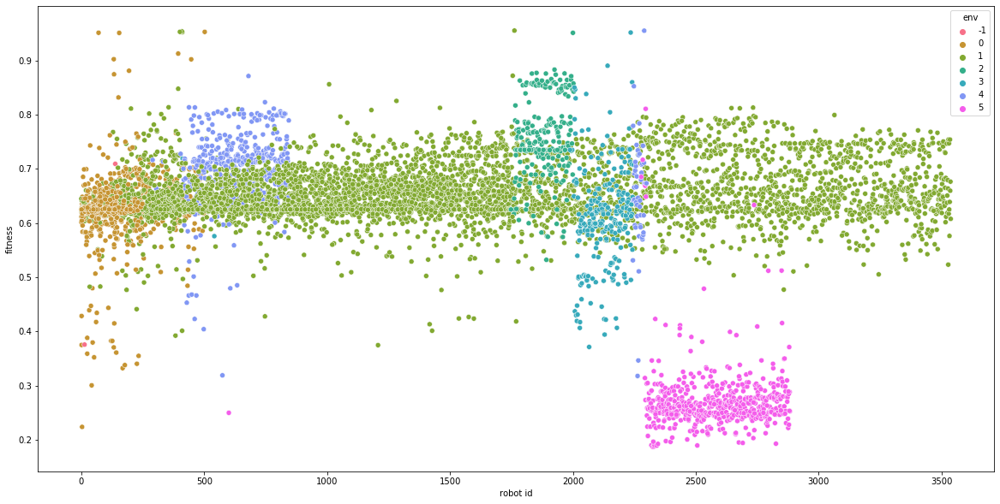

In [49]:
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.scatterplot(data=data,x="robot id",y="fitness",hue="env",estimator=perc_high,palette=sns.color_palette())

## II.2 Diversity

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 28.6% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 42.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 29.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 38.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 35.3

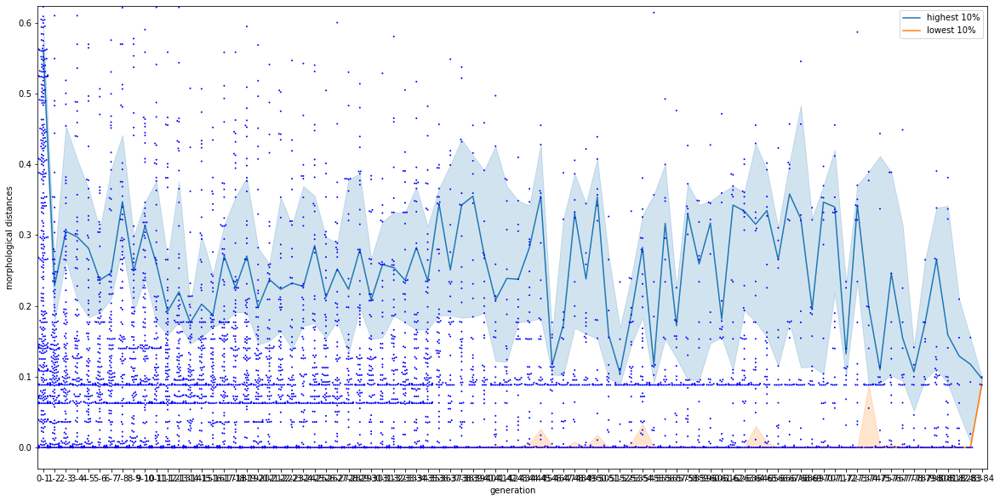

In [10]:
exp_folder = "/home/leni/are-logs/mnipes_gradual/"
lines = []

for folder in os.listdir(exp_folder):
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    lineages = compute_lineage(ids,parents)
    
    descriptors = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")

    for k,v in lineages.items():
        prev_id = k
        j = find_index(k,ids)
        prev_desc = descriptors[j]
        prev_fit = fitnesses[j]
        for i, _id in zip(range(len(v)),v):
            j = find_index(_id,ids)
            dist = la.norm(np.array(descriptors[j][1:])-np.array(prev_desc[1:]))
            diff_fit = fitnesses[j] - prev_fit 
            lines.append([str(prev_id) + "-" + str(_id),str(len(v) - 1 - i)+"-"+str(len(v) - i),dist,diff_fit])
            prev_id = _id
            prev_desc = descriptors[j]
            prev_fit = fitnesses[j]

data = pd.DataFrame(data=lines,columns=["id","generation","morphological distances","fitness difference"])
data = data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
sns.swarmplot(data=data,x="generation",y="morphological distances",size=2,color='b')
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="morphological distances",estimator=perc_low,label="lowest 10%")

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 59.5% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 48.8% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 33.9% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 27.1% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)
/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 16.2

Text(0.5, 1.0, 'exploration - obstacles')

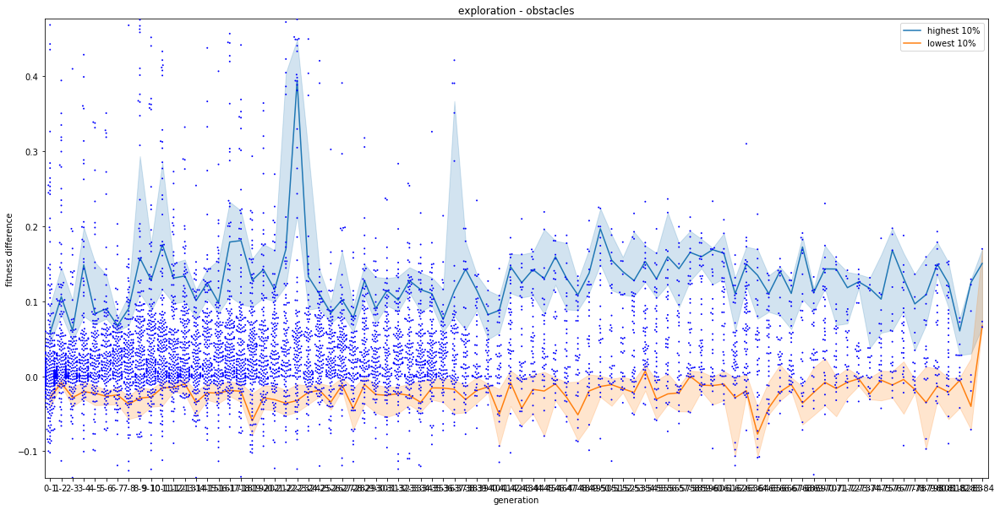

In [12]:
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness difference",size=2,color='b')
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_high,label="highest 10%")
sns.lineplot(data=data,x="generation",y="fitness difference",estimator=perc_low,label="lowest 10%")
ax.set_title("exploration - obstacles")

In [17]:
desc_lines = []
organ_lines = []
exp_folder = "/home/leni/are-logs/mnipes_gradual/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","baseline"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","baseline"])

<Figure size 360x360 with 0 Axes>

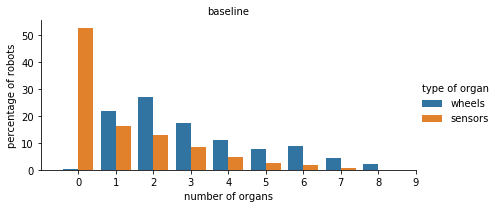

In [18]:
fig = plt.gcf()
fig.set_size_inches(5, 5)
organs_data = pd.DataFrame(data=organ_lines,columns=["number of organs","percentage of robots","type of organ","variant"])
g=sns.catplot(data=organs_data,x="number of organs",y="percentage of robots",hue="type of organ",col="variant",kind='bar',col_wrap=1,aspect=2,height=3)
(g.set_titles("{col_name}")
  .set(xlim=(-1, 9)))

## Behaviours

<Figure size 648x648 with 0 Axes>

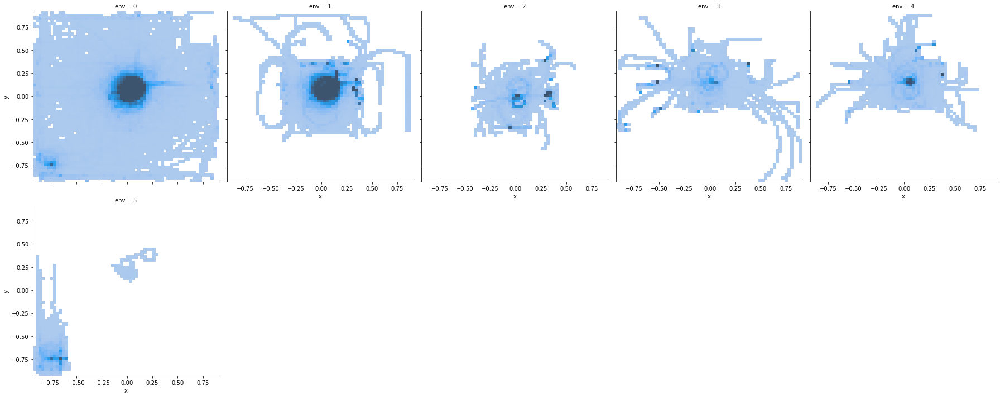

In [29]:
exp_folder = "/home/leni/are-logs/mnipes_gradual/"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)
for folder in os.listdir(exp_folder):
    for file in os.listdir(exp_folder + "/" + folder):
        if(file.split("_")[0] != "traj"):
            continue
        _id = int(file.split("_")[1])
        env = int(file.split("_")[2])
        traj = load_trajectory(exp_folder + "/" + folder + "/" + file)
        traj = [[_id,env] + t for t in traj]
        trajectory += traj

data = pd.DataFrame(data=trajectory,columns=["id","env","t","x","y","z"]) 
sns.displot(kind="hist",data=data,x="x",y="y",col="env",bins=64,legend=False,pmax=0.5,col_wrap=5)

plt.show()

<Figure size 648x648 with 0 Axes>

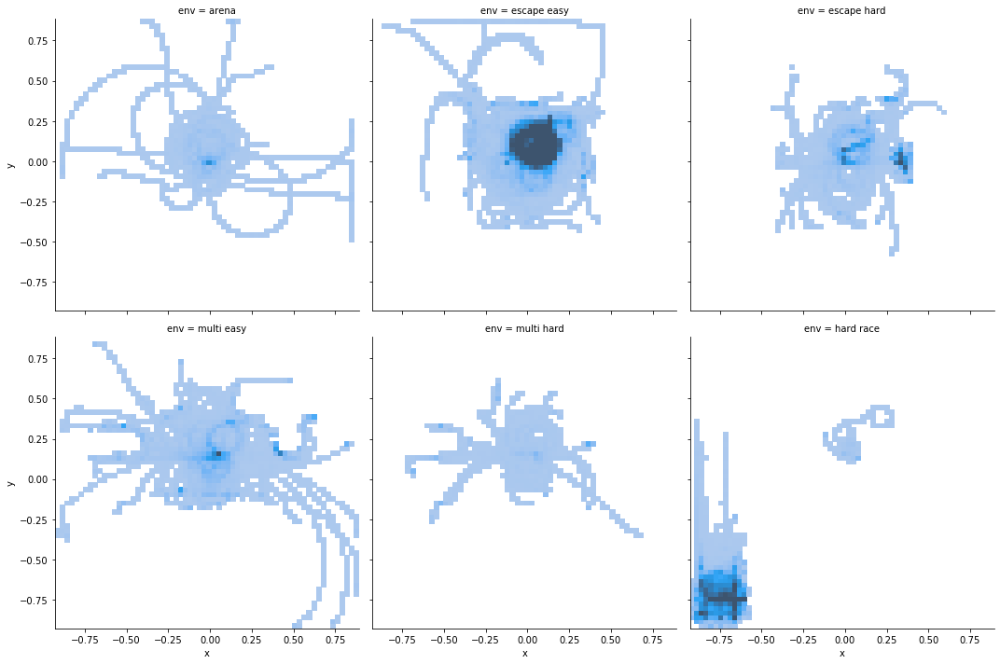

In [103]:
exp_folder = "/home/leni/are-logs/mnipes_gradual/mnipes2_16_4_12-39-1-1770-405870621/"
trajectory = []
fig = plt.gcf()
fig.set_size_inches(9, 9)
id_env = dict()
for file in os.listdir(exp_folder):
    if(file.split("_")[0] != "traj"):
        continue
    _id = int(file.split("_")[1])
    env = int(file.split("_")[2])
    traj = load_trajectory(exp_folder + "/" + file)
    if(len(traj) > 0):
        if _id in id_env:
            if env > id_env[_id]:
                id_env[_id] = env
        else:
            id_env[_id] = env
            
for _id, env in id_env.items():
    traj = load_trajectory(exp_folder + "/traj_" + str(_id) + "_" + str(env))
    traj = [[_id,env_name[env]] + t for t in traj]
    trajectory += traj

data = pd.DataFrame(data=trajectory,columns=["id","env","t","x","y","z"]) 
sns.displot(kind="hist",data=data,x="x",y="y",col="env",bins=64,legend=False,pmax=0.5,col_wrap=3,col_order=env_name)

plt.show()

# Exploration Empty Arena

## Quality

mnipes2_30_8_8-37-38-8693-1197225474 [[177.0, 1.0], [222.0, 1.0], [186.0, 1.0], [465.0, 0.469613], [434.0, 0.464088]]
mnipes2_30_8_8-37-38-8693-1197225474 {258: 0.3149171270718232, 452: 0.27624309392265195, 475: 0.27071823204419887, 372: 0.26519337016574585, 416: 0.26519337016574585}
mnipes2_29_8_15-37-8-8525-3548760707 [[374.0, 1.0], [338.0, 1.0], [363.0, 1.0], [211.0, 0.569061], [424.0, 0.541436]]
mnipes2_29_8_15-37-8-8525-3548760707 {398: 0.3370165745856354, 86: 0.3259668508287293, 249: 0.32044198895027626, 288: 0.32044198895027626, 148: 0.30939226519337015}
mnipes2_30_8_8-37-34-4005-1743262345 [[405.0, 1.0], [369.0, 1.0], [236.0, 1.0], [259.0, 1.0], [205.0, 0.403315]]
mnipes2_30_8_8-37-34-4005-1743262345 {418: 0.3314917127071823, 410: 0.30386740331491713, 339: 0.26519337016574585, 203: 0.24861878453038674, 258: 0.2430939226519337}
mnipes2_29_8_15-37-5-5498-1070279905 [[158.0, 1.0], [202.0, 0.348066], [170.0, 0.337017], [105.0, 0.337017], [87.0, 0.320442]]
mnipes2_29_8_15-37-5-5498-

/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 17.4% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


(0, 0.6)

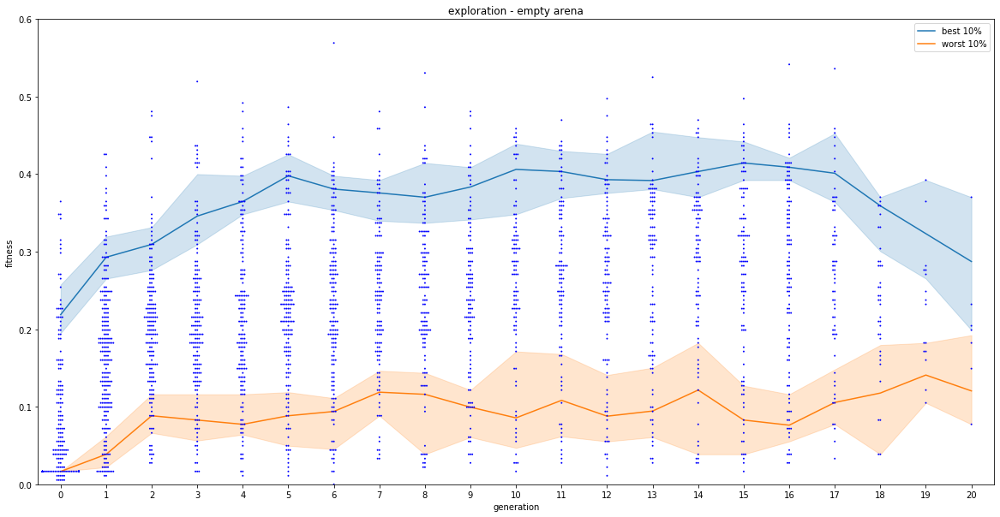

In [87]:
from operator import itemgetter
exp_folder = "/home/leni/are-logs/mnipes2_exploration_sept_22/"
lines = []
i = 0
best_inds = dict()
beh_descriptors = dict()
morph_descriptors = dict()
for folder in os.listdir(exp_folder):
    i+=1
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    indexes = np.argsort(np.array(fitnesses))
    best_inds[folder] = [[ids[indexes[-i]],fitnesses[indexes[-i]]] for i in range(1,6)]
    print(folder,best_inds[folder])
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([_id,fit,gen])
    beh_descriptors[folder] = load_grid_descriptor(exp_folder + "/" + folder + "/behavioral_descriptors")
    fitnesses = dict()
    for _id, desc in descriptors[folder].items():
        fitnesses[_id] = compute_exploration_fitness(desc)
    best_inds[folder] = dict(sorted(fitnesses.items(), key = itemgetter(1), reverse = True)[:5])
    print(folder,best_inds[folder])
    morph_desc = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")
    morph_descriptors[folder] = dict()
    for desc in morph_desc:
        morph_descriptors[folder][desc[0]] = desc[1:]
print(i)
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("exploration - empty arena")
ax.set_ylim([0,0.6])

[[197.0, 0.296875], [90.0, 0.265625], [151.0, 0.265625], [188.0, 0.265625], [161.0, 0.265625]]


(0, 0.6)

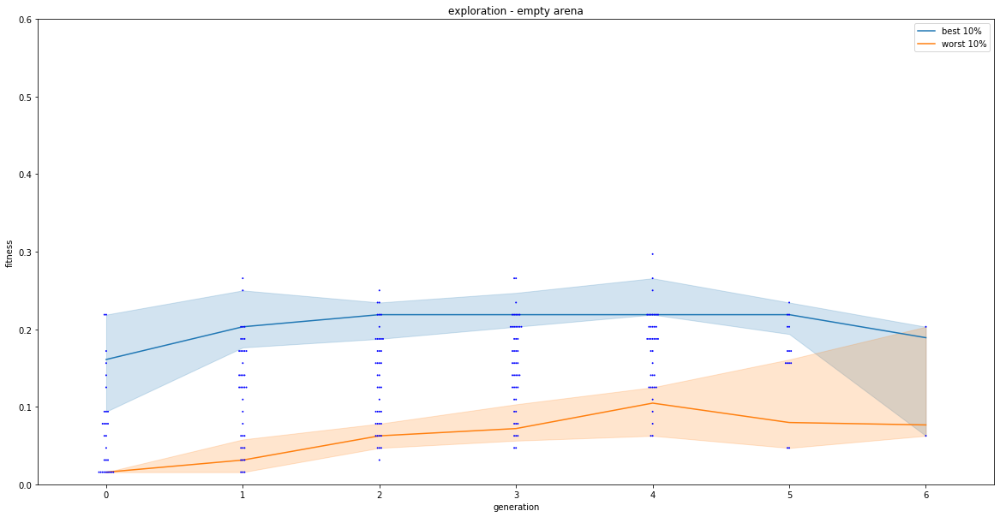

In [7]:
from operator import itemgetter
exp_folder = "/home/leni/are-logs/mnipes2_27_9_10-4-10-72-2968550977/"
lines = []
ids, fitnesses, parents = load_fitness(exp_folder + "/fitnesses.csv")
indexes = np.argsort(np.array(fitnesses))
best_inds = [[ids[indexes[-i]],fitnesses[indexes[-i]]] for i in range(1,6)]
print(best_inds)
generation = compute_generation(ids,parents)
for _id, fit, gen in zip(ids,fitnesses,generation):
    lines.append([_id,fit,gen])
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("exploration - empty arena")
ax.set_ylim([0,0.6])

[[148.0, 0.265625], [176.0, 0.265625], [245.0, 0.265625], [226.0, 0.25], [221.0, 0.234375]]


(0, 0.6)

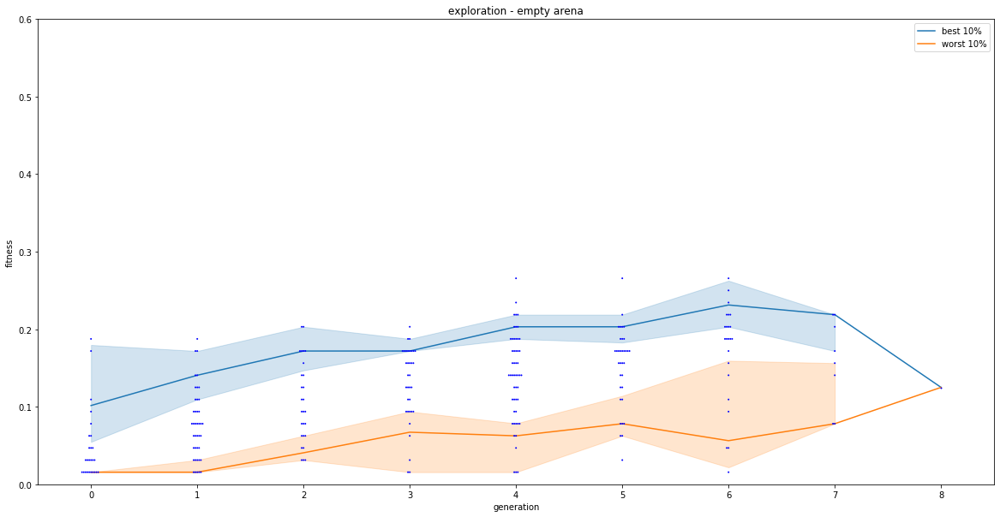

In [8]:
from operator import itemgetter
exp_folder = "/home/leni/are-logs/mnipes2_27_9_10-8-20-687-2850988996/"
lines = []
ids, fitnesses, parents = load_fitness(exp_folder + "/fitnesses.csv")
indexes = np.argsort(np.array(fitnesses))
best_inds = [[ids[indexes[-i]],fitnesses[indexes[-i]]] for i in range(1,6)]
print(best_inds)
generation = compute_generation(ids,parents)
for _id, fit, gen in zip(ids,fitnesses,generation):
    lines.append([_id,fit,gen])
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("exploration - empty arena")
ax.set_ylim([0,0.6])

mnipes2_30_8_8-37-38-8693-1197225474
[(1, 5), (2, 4), (3, 4), (4, 4), (9, 4), (11, 3), (12, 3), (13, 3), (16, 4), (17, 3), (20, 2), (21, 2), (24, 4), (25, 3), (27, 1), (28, 1), (29, 1), (33, 3), (34, 2), (35, 1)]
wheels,sensor,joint,caster
4.0 0.0 0.0 4.0
[[0, 1, 5], [0, 2, 4], [0, 3, 4], [0, 4, 4], [1, 1, 4], [1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 0, 4], [2, 1, 3], [2, 4, 2], [2, 5, 2], [3, 0, 4], [3, 1, 3], [3, 3, 1], [3, 4, 1], [3, 5, 1], [4, 1, 3], [4, 2, 2], [4, 3, 1]]


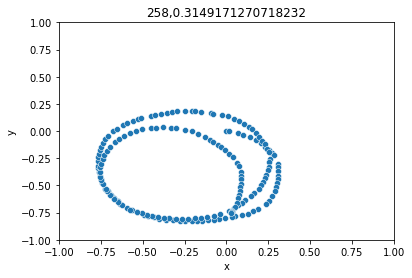

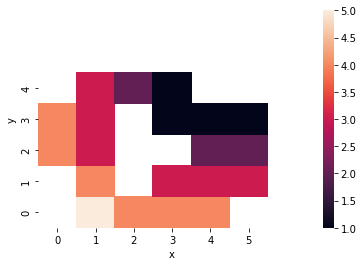

mnipes2_30_8_8-37-38-8693-1197225474
[(1, 5), (2, 4), (3, 4), (9, 4), (10, 3), (11, 3), (12, 3), (13, 3), (17, 3), (20, 2), (21, 2), (25, 3), (26, 2), (27, 1), (28, 1), (29, 1), (33, 3), (34, 2), (35, 1)]
wheels,sensor,joint,caster
4.0 0.0 0.0 4.0
[[0, 1, 5], [0, 2, 4], [0, 3, 4], [1, 1, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 1, 3], [2, 4, 2], [2, 5, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 5, 1], [4, 1, 3], [4, 2, 2], [4, 3, 1]]


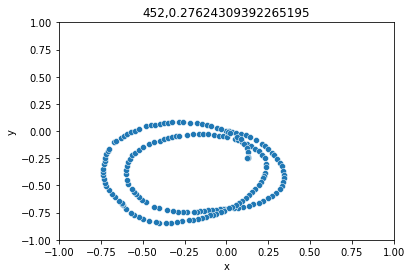

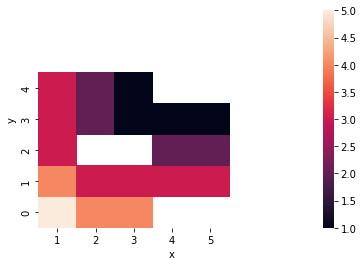

mnipes2_30_8_8-37-38-8693-1197225474
[(2, 4), (3, 4), (4, 4), (9, 4), (10, 3), (11, 3), (12, 3), (13, 3), (17, 3), (18, 2), (21, 2), (22, 2), (25, 3), (26, 2), (27, 1), (28, 1), (29, 1), (34, 2), (35, 1), (37, 1)]
wheels,sensor,joint,caster
4.0 0.0 0.0 4.0
[[0, 2, 4], [0, 3, 4], [0, 4, 4], [1, 1, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 1, 3], [2, 2, 2], [2, 5, 2], [2, 6, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 5, 1], [4, 2, 2], [4, 3, 1], [4, 5, 1]]


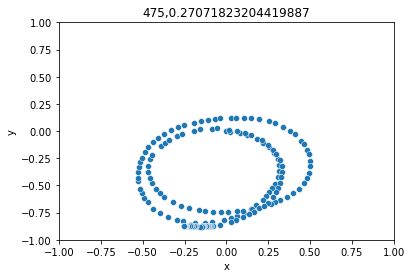

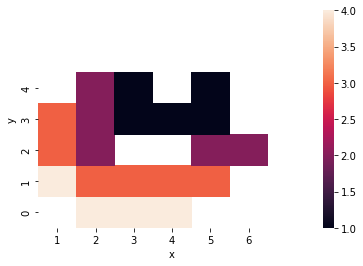

mnipes2_30_8_8-37-38-8693-1197225474
[(3, 4), (4, 4), (9, 4), (10, 3), (11, 3), (12, 3), (13, 3), (17, 3), (18, 2), (20, 2), (21, 2), (25, 3), (26, 2), (27, 1), (28, 1), (29, 1), (33, 3), (34, 2), (35, 1), (37, 1)]
wheels,sensor,joint,caster
4.0 0.0 0.0 4.0
[[0, 3, 4], [0, 4, 4], [1, 1, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 1, 3], [2, 2, 2], [2, 4, 2], [2, 5, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 5, 1], [4, 1, 3], [4, 2, 2], [4, 3, 1], [4, 5, 1]]


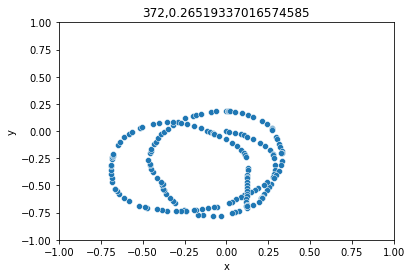

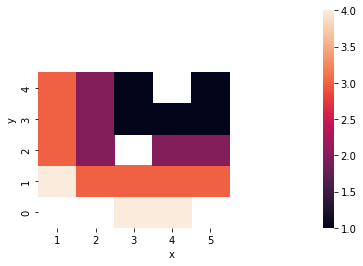

mnipes2_30_8_8-37-38-8693-1197225474
[(10, 3), (11, 3), (12, 3), (13, 3), (17, 3), (18, 2), (20, 2), (21, 2), (22, 2), (25, 3), (26, 2), (27, 1), (28, 1), (29, 1), (30, 2), (31, 3), (34, 2), (35, 1), (38, 2), (39, 3), (44, 1), (45, 1), (46, 2)]
wheels,sensor,joint,caster
4.0 0.0 0.0 4.0
[[1, 2, 3], [1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 1, 3], [2, 2, 2], [2, 4, 2], [2, 5, 2], [2, 6, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 5, 1], [3, 6, 2], [3, 7, 3], [4, 2, 2], [4, 3, 1], [4, 6, 2], [4, 7, 3], [5, 4, 1], [5, 5, 1], [5, 6, 2]]


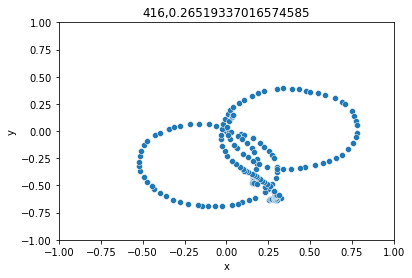

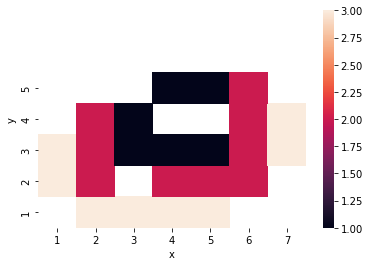

mnipes2_29_8_15-37-8-8525-3548760707
[(3, 4), (4, 4), (5, 4), (6, 4), (7, 5), (10, 3), (11, 3), (18, 2), (20, 2), (21, 2), (22, 2), (25, 3), (26, 2), (27, 1), (28, 1), (30, 2), (33, 3), (38, 2), (42, 2), (43, 1), (45, 1), (46, 2), (51, 2), (52, 2), (53, 2)]
wheels,sensor,joint,caster
4.0 4.0 0.0 0.0
[[0, 3, 4], [0, 4, 4], [0, 5, 4], [0, 6, 4], [0, 7, 5], [1, 2, 3], [1, 3, 3], [2, 2, 2], [2, 4, 2], [2, 5, 2], [2, 6, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 6, 2], [4, 1, 3], [4, 6, 2], [5, 2, 2], [5, 3, 1], [5, 5, 1], [5, 6, 2], [6, 3, 2], [6, 4, 2], [6, 5, 2]]


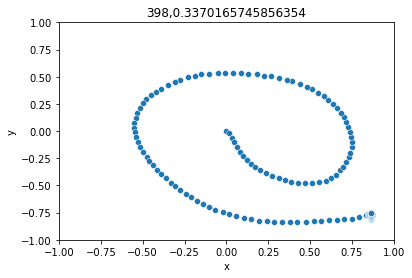

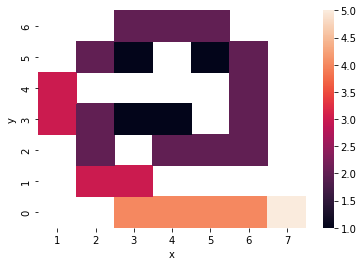

mnipes2_29_8_15-37-8-8525-3548760707
[(11, 3), (12, 3), (13, 3), (17, 3), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (23, 3), (25, 3), (26, 2), (27, 1), (28, 1), (29, 1), (31, 3), (33, 3), (34, 2), (35, 1), (37, 1), (38, 2), (39, 3), (42, 2), (43, 1), (44, 1), (45, 1), (46, 2), (51, 2), (52, 2)]
wheels,sensor,joint,caster
4.0 4.0 0.0 0.0
[[1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 1, 3], [2, 2, 2], [2, 3, 2], [2, 4, 2], [2, 5, 2], [2, 6, 2], [2, 7, 3], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 5, 1], [3, 7, 3], [4, 1, 3], [4, 2, 2], [4, 3, 1], [4, 5, 1], [4, 6, 2], [4, 7, 3], [5, 2, 2], [5, 3, 1], [5, 4, 1], [5, 5, 1], [5, 6, 2], [6, 3, 2], [6, 4, 2]]


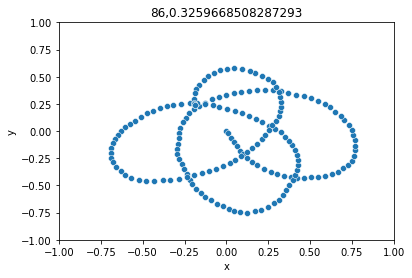

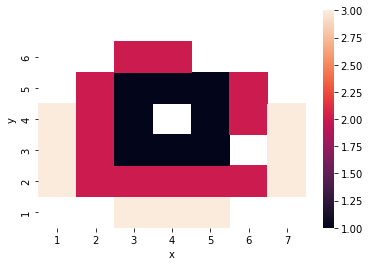

mnipes2_29_8_15-37-8-8525-3548760707
[(1, 5), (2, 4), (3, 4), (5, 4), (6, 4), (9, 4), (11, 3), (12, 3), (14, 3), (15, 4), (17, 3), (18, 2), (20, 2), (22, 2), (23, 3), (26, 2), (27, 1), (28, 1), (29, 1), (30, 2), (35, 1)]
wheels,sensor,joint,caster
4.0 4.0 0.0 0.0
[[0, 1, 5], [0, 2, 4], [0, 3, 4], [0, 5, 4], [0, 6, 4], [1, 1, 4], [1, 3, 3], [1, 4, 3], [1, 6, 3], [1, 7, 4], [2, 1, 3], [2, 2, 2], [2, 4, 2], [2, 6, 2], [2, 7, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 5, 1], [3, 6, 2], [4, 3, 1]]


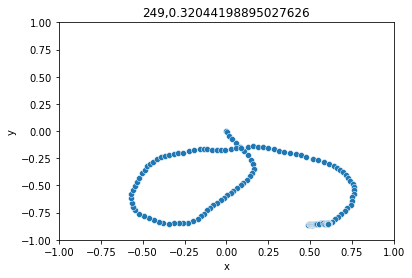

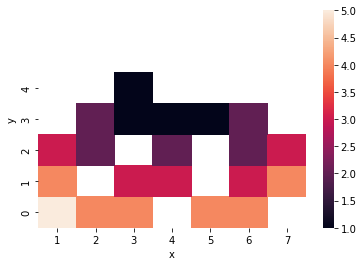

mnipes2_29_8_15-37-8-8525-3548760707
[(9, 4), (10, 3), (11, 3), (12, 3), (17, 3), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (24, 4), (25, 3), (26, 2), (27, 1), (28, 1), (29, 1), (30, 2), (33, 3), (35, 1), (37, 1), (38, 2), (41, 3), (42, 2), (43, 1), (44, 1), (50, 2), (51, 2)]
wheels,sensor,joint,caster
4.0 4.0 0.0 0.0
[[1, 1, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [2, 1, 3], [2, 2, 2], [2, 3, 2], [2, 4, 2], [2, 5, 2], [2, 6, 2], [3, 0, 4], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 5, 1], [3, 6, 2], [4, 1, 3], [4, 3, 1], [4, 5, 1], [4, 6, 2], [5, 1, 3], [5, 2, 2], [5, 3, 1], [5, 4, 1], [6, 2, 2], [6, 3, 2]]


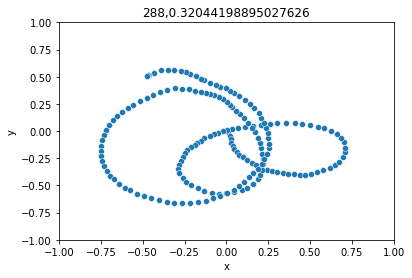

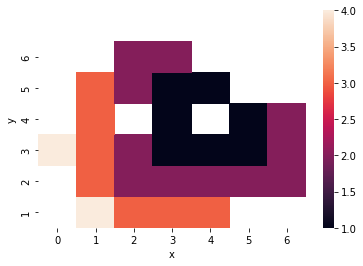

mnipes2_29_8_15-37-8-8525-3548760707
[(10, 3), (11, 3), (12, 3), (13, 3), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (25, 3), (26, 2), (27, 1), (28, 1), (30, 2), (33, 3), (34, 2), (35, 1), (37, 1), (38, 2), (41, 3), (42, 2), (43, 1), (44, 1), (45, 1), (46, 2), (50, 2), (51, 2), (52, 2)]
wheels,sensor,joint,caster
4.0 4.0 0.0 0.0
[[1, 2, 3], [1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 2, 2], [2, 3, 2], [2, 4, 2], [2, 5, 2], [2, 6, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 6, 2], [4, 1, 3], [4, 2, 2], [4, 3, 1], [4, 5, 1], [4, 6, 2], [5, 1, 3], [5, 2, 2], [5, 3, 1], [5, 4, 1], [5, 5, 1], [5, 6, 2], [6, 2, 2], [6, 3, 2], [6, 4, 2]]


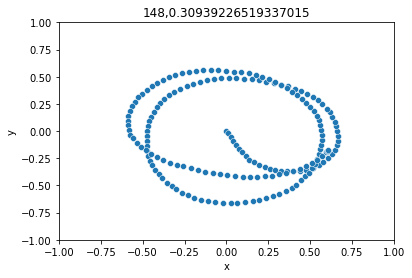

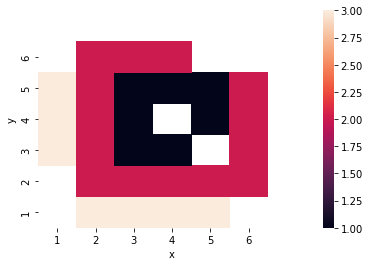

mnipes2_30_8_8-37-34-4005-1743262345
[(8, 5), (9, 4), (10, 3), (11, 3), (16, 4), (19, 2), (20, 2), (24, 4), (25, 3), (27, 1), (28, 1), (32, 4), (33, 3), (41, 3), (49, 3), (50, 2), (57, 4), (58, 3), (59, 3), (60, 3)]
wheels,sensor,joint,caster
2.0 0.0 8.0 0.0
[[1, 0, 5], [1, 1, 4], [1, 2, 3], [1, 3, 3], [2, 0, 4], [2, 3, 2], [2, 4, 2], [3, 0, 4], [3, 1, 3], [3, 3, 1], [3, 4, 1], [4, 0, 4], [4, 1, 3], [5, 1, 3], [6, 1, 3], [6, 2, 2], [7, 1, 4], [7, 2, 3], [7, 3, 3], [7, 4, 3]]


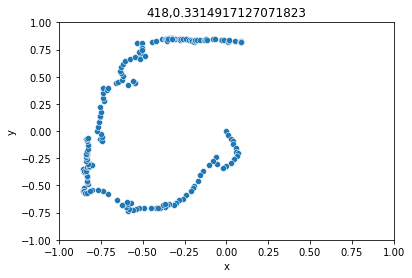

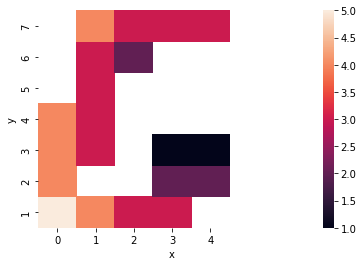

mnipes2_30_8_8-37-34-4005-1743262345
[(0, 5), (1, 5), (2, 4), (8, 5), (9, 4), (10, 3), (11, 3), (17, 3), (19, 2), (25, 3), (27, 1), (28, 1), (33, 3), (34, 2), (35, 1), (41, 3), (42, 2), (49, 3), (50, 2)]
wheels,sensor,joint,caster
2.0 1.0 4.0 2.0
[[0, 0, 5], [0, 1, 5], [0, 2, 4], [1, 0, 5], [1, 1, 4], [1, 2, 3], [1, 3, 3], [2, 1, 3], [2, 3, 2], [3, 1, 3], [3, 3, 1], [3, 4, 1], [4, 1, 3], [4, 2, 2], [4, 3, 1], [5, 1, 3], [5, 2, 2], [6, 1, 3], [6, 2, 2]]


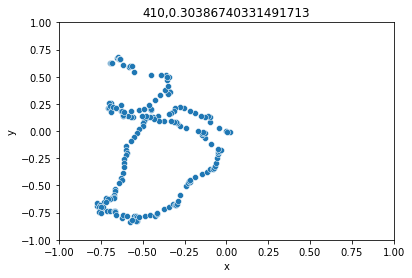

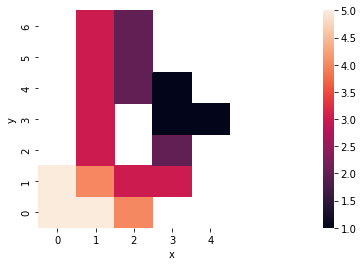

mnipes2_30_8_8-37-34-4005-1743262345
[(10, 3), (11, 3), (12, 3), (13, 3), (17, 3), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (25, 3), (26, 2), (27, 1), (28, 1), (30, 2), (33, 3), (34, 2), (35, 1), (37, 1), (38, 2), (42, 2), (43, 1), (44, 1), (45, 1)]
wheels,sensor,joint,caster
3.0 4.0 0.0 1.0
[[1, 2, 3], [1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 1, 3], [2, 2, 2], [2, 3, 2], [2, 4, 2], [2, 5, 2], [2, 6, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 6, 2], [4, 1, 3], [4, 2, 2], [4, 3, 1], [4, 5, 1], [4, 6, 2], [5, 2, 2], [5, 3, 1], [5, 4, 1], [5, 5, 1]]


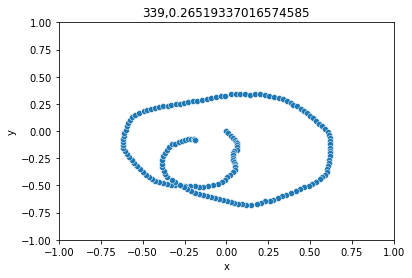

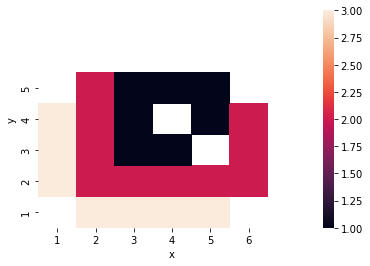

mnipes2_30_8_8-37-34-4005-1743262345
[(8, 5), (9, 4), (10, 3), (11, 3), (12, 3), (13, 3), (16, 4), (17, 3), (20, 2), (21, 2), (25, 3), (26, 2), (27, 1), (28, 1), (33, 3), (34, 2), (35, 1)]
wheels,sensor,joint,caster
2.0 0.0 8.0 0.0
[[1, 0, 5], [1, 1, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 0, 4], [2, 1, 3], [2, 4, 2], [2, 5, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [4, 1, 3], [4, 2, 2], [4, 3, 1]]


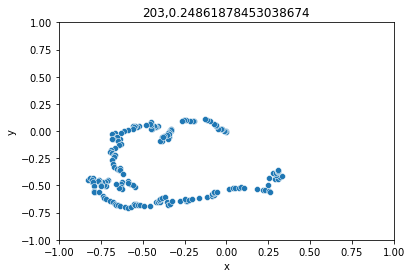

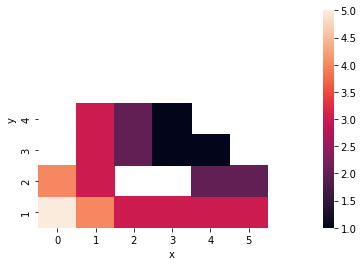

mnipes2_30_8_8-37-34-4005-1743262345
[(1, 5), (2, 4), (3, 4), (9, 4), (11, 3), (12, 3), (17, 3), (18, 2), (19, 2), (20, 2), (25, 3), (26, 2), (27, 1), (33, 3), (34, 2), (35, 1)]
wheels,sensor,joint,caster
1.0 3.0 8.0 0.0
[[0, 1, 5], [0, 2, 4], [0, 3, 4], [1, 1, 4], [1, 3, 3], [1, 4, 3], [2, 1, 3], [2, 2, 2], [2, 3, 2], [2, 4, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [4, 1, 3], [4, 2, 2], [4, 3, 1]]


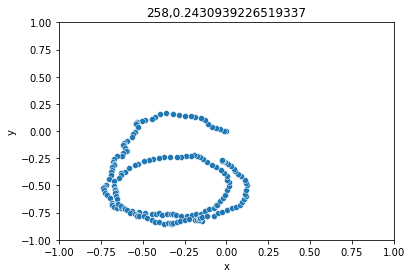

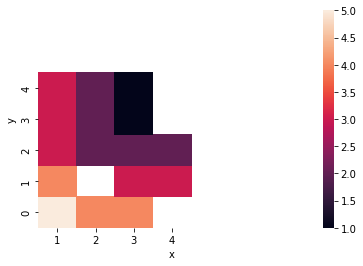

mnipes2_29_8_15-37-5-5498-1070279905
[(2, 4), (3, 4), (9, 4), (10, 3), (11, 3), (12, 3), (17, 3), (18, 2), (19, 2), (20, 2), (25, 3), (26, 2), (28, 1), (34, 2), (35, 1)]
wheels,sensor,joint,caster
1.0 2.0 6.0 1.0
[[0, 2, 4], [0, 3, 4], [1, 1, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [2, 1, 3], [2, 2, 2], [2, 3, 2], [2, 4, 2], [3, 1, 3], [3, 2, 2], [3, 4, 1], [4, 2, 2], [4, 3, 1]]


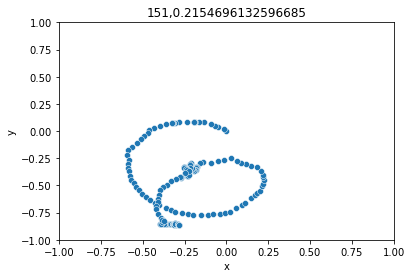

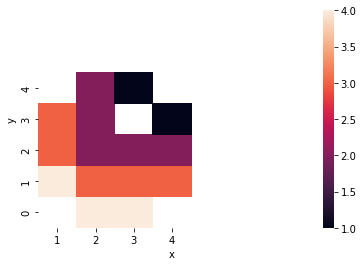

mnipes2_29_8_15-37-5-5498-1070279905
[(2, 4), (3, 4), (9, 4), (10, 3), (11, 3), (12, 3), (17, 3), (18, 2), (20, 2), (25, 3), (26, 2), (27, 1), (28, 1), (34, 2), (35, 1)]
wheels,sensor,joint,caster
1.0 3.0 4.0 1.0
[[0, 2, 4], [0, 3, 4], [1, 1, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [2, 1, 3], [2, 2, 2], [2, 4, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [4, 2, 2], [4, 3, 1]]


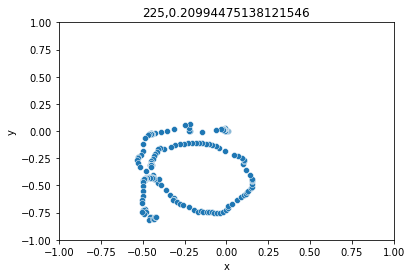

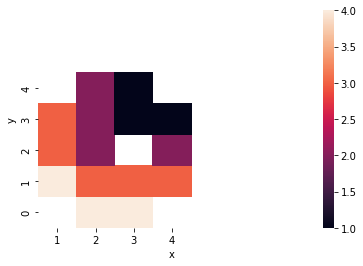

mnipes2_29_8_15-37-5-5498-1070279905
[(0, 5), (8, 5), (16, 4), (24, 4), (27, 1), (28, 1), (32, 4), (33, 3), (34, 2), (35, 1), (41, 3), (42, 2)]
wheels,sensor,joint,caster
2.0 2.0 4.0 1.0
[[0, 0, 5], [1, 0, 5], [2, 0, 4], [3, 0, 4], [3, 3, 1], [3, 4, 1], [4, 0, 4], [4, 1, 3], [4, 2, 2], [4, 3, 1], [5, 1, 3], [5, 2, 2]]


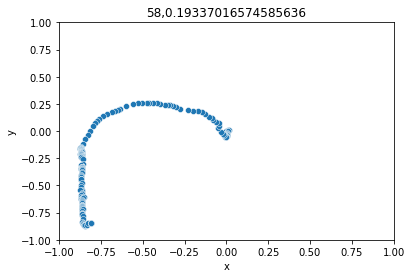

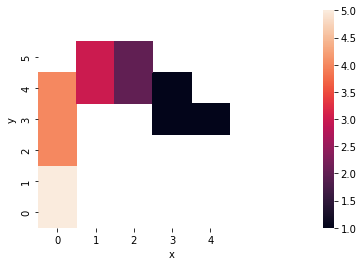

mnipes2_29_8_15-37-5-5498-1070279905
[(9, 4), (10, 3), (11, 3), (12, 3), (17, 3), (18, 2), (20, 2), (24, 4), (25, 3), (27, 1), (33, 3), (34, 2), (35, 1)]
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0
[[1, 1, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [2, 1, 3], [2, 2, 2], [2, 4, 2], [3, 0, 4], [3, 1, 3], [3, 3, 1], [4, 1, 3], [4, 2, 2], [4, 3, 1]]


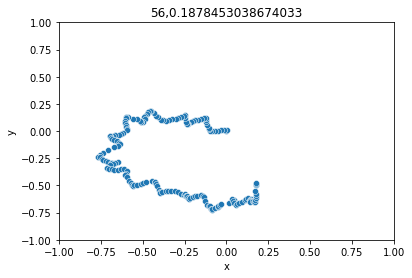

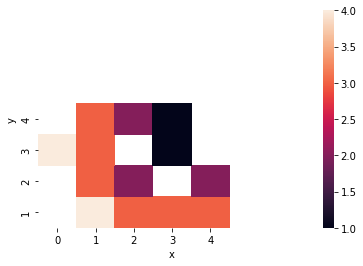

mnipes2_29_8_15-37-5-5498-1070279905
[(3, 4), (4, 4), (10, 3), (11, 3), (12, 3), (13, 3), (18, 2), (20, 2), (21, 2), (26, 2), (27, 1), (28, 1), (35, 1)]
wheels,sensor,joint,caster
1.0 3.0 4.0 1.0
[[0, 3, 4], [0, 4, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [1, 5, 3], [2, 2, 2], [2, 4, 2], [2, 5, 2], [3, 2, 2], [3, 3, 1], [3, 4, 1], [4, 3, 1]]


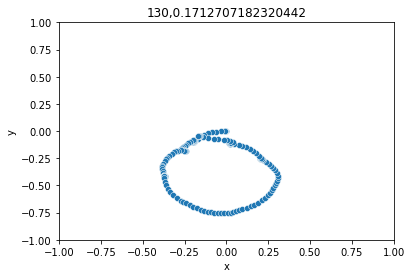

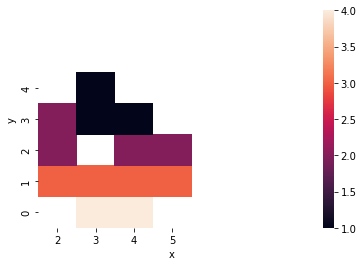

mnipes2_29_8_15-35-6-6994-1947657650
[(1, 5), (2, 4), (3, 4), (9, 4), (11, 3), (12, 3), (13, 3), (14, 3), (17, 3), (18, 2), (19, 2), (20, 2), (21, 2), (22, 2), (26, 2), (27, 1), (28, 1), (29, 1), (30, 2), (31, 3), (35, 1), (37, 1), (38, 2), (39, 3), (44, 1), (45, 1), (46, 2)]
wheels,sensor,joint,caster
4.0 3.0 0.0 0.0
[[0, 1, 5], [0, 2, 4], [0, 3, 4], [1, 1, 4], [1, 3, 3], [1, 4, 3], [1, 5, 3], [1, 6, 3], [2, 1, 3], [2, 2, 2], [2, 3, 2], [2, 4, 2], [2, 5, 2], [2, 6, 2], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 5, 1], [3, 6, 2], [3, 7, 3], [4, 3, 1], [4, 5, 1], [4, 6, 2], [4, 7, 3], [5, 4, 1], [5, 5, 1], [5, 6, 2]]


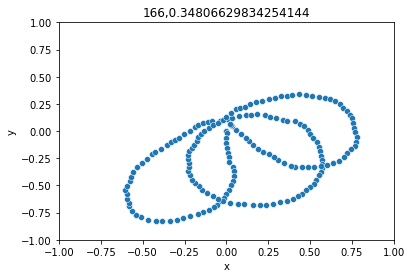

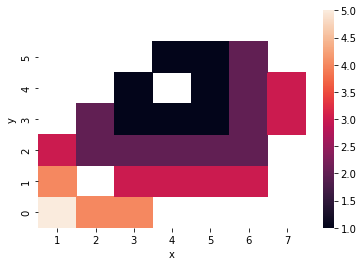

mnipes2_29_8_15-35-6-6994-1947657650
[(2, 4), (3, 4), (9, 4), (10, 3), (11, 3), (12, 3), (16, 4), (17, 3), (19, 2), (20, 2), (24, 4), (27, 1), (28, 1), (32, 4), (35, 1), (40, 4), (41, 3), (43, 1), (49, 3), (50, 2), (51, 2)]
wheels,sensor,joint,caster
4.0 3.0 0.0 0.0
[[0, 2, 4], [0, 3, 4], [1, 1, 4], [1, 2, 3], [1, 3, 3], [1, 4, 3], [2, 0, 4], [2, 1, 3], [2, 3, 2], [2, 4, 2], [3, 0, 4], [3, 3, 1], [3, 4, 1], [4, 0, 4], [4, 3, 1], [5, 0, 4], [5, 1, 3], [5, 3, 1], [6, 1, 3], [6, 2, 2], [6, 3, 2]]


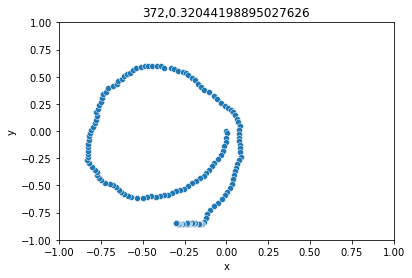

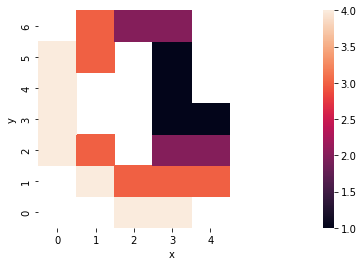

mnipes2_29_8_15-35-6-6994-1947657650
[(2, 4), (3, 4), (4, 4), (10, 3), (12, 3), (16, 4), (17, 3), (18, 2), (19, 2), (20, 2), (24, 4), (26, 2), (27, 1), (28, 1), (31, 3), (32, 4), (33, 3), (34, 2), (35, 1), (37, 1), (38, 2), (39, 3)]
wheels,sensor,joint,caster
4.0 3.0 0.0 0.0
[[0, 2, 4], [0, 3, 4], [0, 4, 4], [1, 2, 3], [1, 4, 3], [2, 0, 4], [2, 1, 3], [2, 2, 2], [2, 3, 2], [2, 4, 2], [3, 0, 4], [3, 2, 2], [3, 3, 1], [3, 4, 1], [3, 7, 3], [4, 0, 4], [4, 1, 3], [4, 2, 2], [4, 3, 1], [4, 5, 1], [4, 6, 2], [4, 7, 3]]


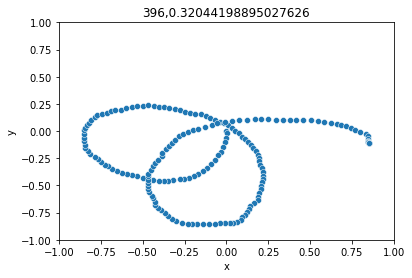

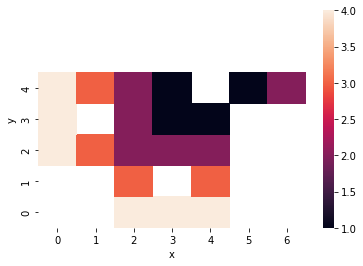

mnipes2_29_8_15-35-6-6994-1947657650
[(1, 5), (9, 4), (17, 3), (25, 3), (27, 1), (32, 4), (33, 3), (40, 4), (44, 1), (48, 4), (49, 3), (50, 2), (51, 2), (52, 2), (56, 5), (59, 3), (60, 3)]
wheels,sensor,joint,caster
6.0 0.0 0.0 1.0
[[0, 1, 5], [1, 1, 4], [2, 1, 3], [3, 1, 3], [3, 3, 1], [4, 0, 4], [4, 1, 3], [5, 0, 4], [5, 4, 1], [6, 0, 4], [6, 1, 3], [6, 2, 2], [6, 3, 2], [6, 4, 2], [7, 0, 5], [7, 3, 3], [7, 4, 3]]


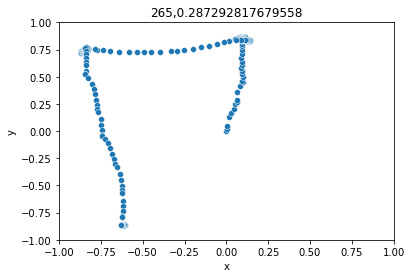

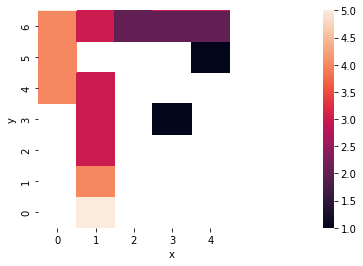

mnipes2_29_8_15-35-6-6994-1947657650
[(3, 4), (4, 4), (5, 4), (6, 4), (11, 3), (12, 3), (14, 3), (15, 4), (19, 2), (20, 2), (23, 3), (27, 1), (28, 1), (29, 1), (30, 2), (31, 3), (35, 1), (37, 1)]
wheels,sensor,joint,caster
4.0 3.0 0.0 0.0
[[0, 3, 4], [0, 4, 4], [0, 5, 4], [0, 6, 4], [1, 3, 3], [1, 4, 3], [1, 6, 3], [1, 7, 4], [2, 3, 2], [2, 4, 2], [2, 7, 3], [3, 3, 1], [3, 4, 1], [3, 5, 1], [3, 6, 2], [3, 7, 3], [4, 3, 1], [4, 5, 1]]


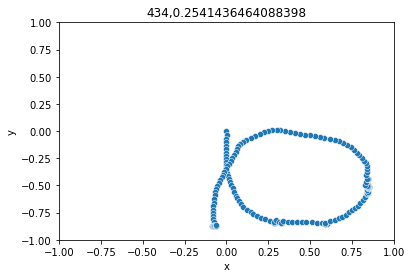

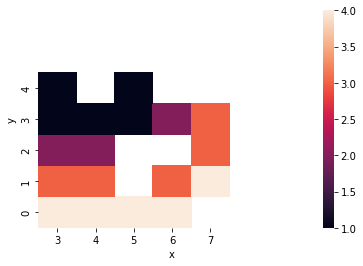

mnipes2_30_8_8-37-35-5646-2737766409
[(0, 5), (1, 5), (2, 4), (8, 5), (9, 4), (10, 3), (11, 3), (16, 4), (19, 2), (20, 2), (22, 2), (24, 4), (28, 1), (30, 2), (32, 4), (33, 3), (34, 2), (35, 1), (38, 2), (41, 3), (42, 2), (44, 1), (45, 1), (46, 2)]
wheels,sensor,joint,caster
3.0 0.0 8.0 0.0
[[0, 0, 5], [0, 1, 5], [0, 2, 4], [1, 0, 5], [1, 1, 4], [1, 2, 3], [1, 3, 3], [2, 0, 4], [2, 3, 2], [2, 4, 2], [2, 6, 2], [3, 0, 4], [3, 4, 1], [3, 6, 2], [4, 0, 4], [4, 1, 3], [4, 2, 2], [4, 3, 1], [4, 6, 2], [5, 1, 3], [5, 2, 2], [5, 4, 1], [5, 5, 1], [5, 6, 2]]


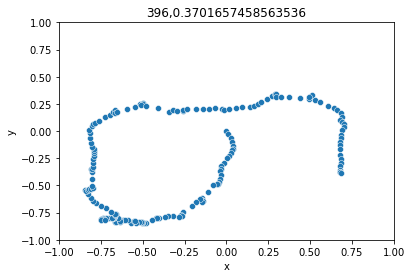

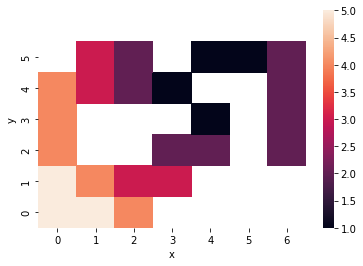

mnipes2_30_8_8-37-35-5646-2737766409
[(1, 5), (2, 4), (8, 5), (9, 4), (10, 3), (16, 4), (18, 2), (19, 2), (24, 4), (25, 3), (27, 1), (28, 1), (32, 4), (33, 3), (40, 4), (41, 3), (48, 4)]
wheels,sensor,joint,caster
3.0 0.0 8.0 0.0
[[0, 1, 5], [0, 2, 4], [1, 0, 5], [1, 1, 4], [1, 2, 3], [2, 0, 4], [2, 2, 2], [2, 3, 2], [3, 0, 4], [3, 1, 3], [3, 3, 1], [3, 4, 1], [4, 0, 4], [4, 1, 3], [5, 0, 4], [5, 1, 3], [6, 0, 4]]


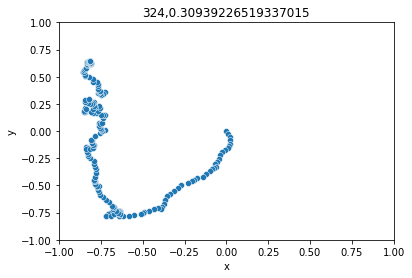

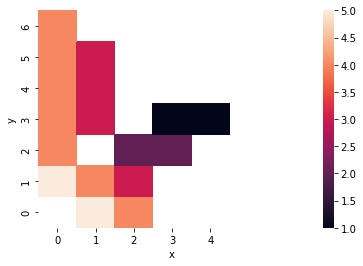

mnipes2_30_8_8-37-35-5646-2737766409
[(9, 4), (10, 3), (11, 3), (16, 4), (17, 3), (19, 2), (24, 4), (27, 1), (28, 1), (32, 4), (33, 3), (35, 1), (41, 3), (49, 3), (51, 2), (57, 4), (58, 3), (59, 3), (60, 3)]
wheels,sensor,joint,caster
3.0 0.0 8.0 0.0
[[1, 1, 4], [1, 2, 3], [1, 3, 3], [2, 0, 4], [2, 1, 3], [2, 3, 2], [3, 0, 4], [3, 3, 1], [3, 4, 1], [4, 0, 4], [4, 1, 3], [4, 3, 1], [5, 1, 3], [6, 1, 3], [6, 3, 2], [7, 1, 4], [7, 2, 3], [7, 3, 3], [7, 4, 3]]


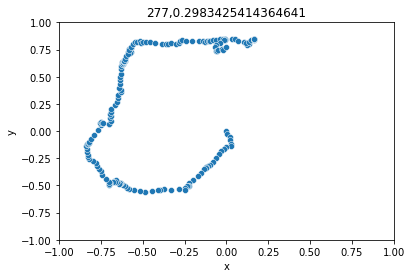

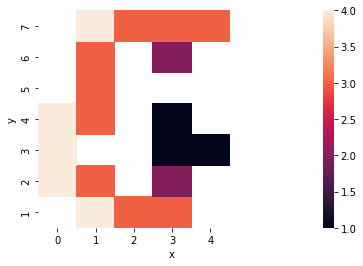

mnipes2_30_8_8-37-35-5646-2737766409
[(1, 5), (2, 4), (8, 5), (9, 4), (10, 3), (11, 3), (16, 4), (19, 2), (20, 2), (24, 4), (25, 3), (28, 1), (33, 3), (34, 2), (41, 3), (42, 2), (50, 2)]
wheels,sensor,joint,caster
3.0 0.0 8.0 0.0
[[0, 1, 5], [0, 2, 4], [1, 0, 5], [1, 1, 4], [1, 2, 3], [1, 3, 3], [2, 0, 4], [2, 3, 2], [2, 4, 2], [3, 0, 4], [3, 1, 3], [3, 4, 1], [4, 1, 3], [4, 2, 2], [5, 1, 3], [5, 2, 2], [6, 2, 2]]


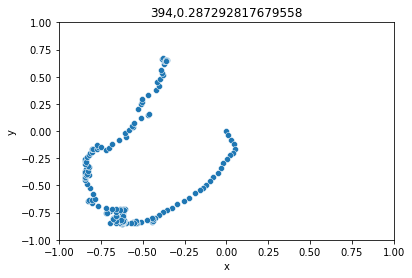

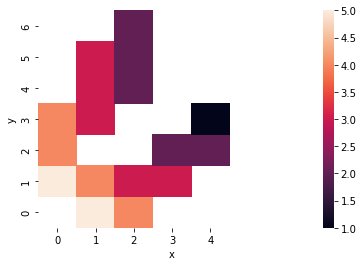

mnipes2_30_8_8-37-35-5646-2737766409
[(17, 3), (18, 2), (25, 3), (26, 2), (27, 1), (28, 1), (32, 4), (33, 3), (40, 4), (45, 1), (46, 2), (48, 4), (49, 3), (52, 2), (53, 2), (57, 4), (58, 3), (59, 3), (60, 3)]
wheels,sensor,joint,caster
3.0 0.0 8.0 0.0
[[2, 1, 3], [2, 2, 2], [3, 1, 3], [3, 2, 2], [3, 3, 1], [3, 4, 1], [4, 0, 4], [4, 1, 3], [5, 0, 4], [5, 5, 1], [5, 6, 2], [6, 0, 4], [6, 1, 3], [6, 4, 2], [6, 5, 2], [7, 1, 4], [7, 2, 3], [7, 3, 3], [7, 4, 3]]


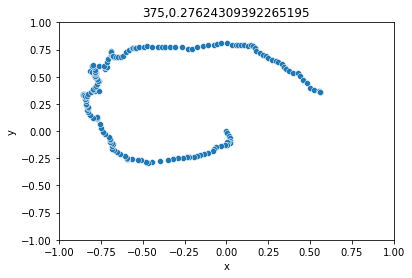

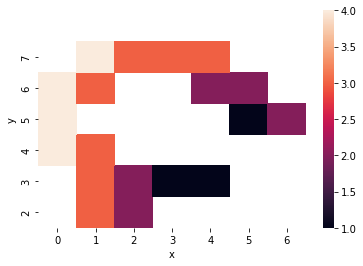

In [90]:
for folder, inds in best_inds.items():
    for _id,fit in inds.items():
        print(folder)
        print(beh_descriptors[folder][int(_id)])
        print("wheels,sensor,joint,caster")
        print(morph_descriptors[folder][int(_id)][4]*16,morph_descriptors[folder][int(_id)][5]*16,morph_descriptors[folder][int(_id)][6]*16,morph_descriptors[folder][int(_id)][7]*16)
        
        lines = []
        for d in descriptors[folder][int(_id)]:
            lines.append([int(d[0]/8),int(d[0])%8,d[1]])
        print(lines)
        data_desc = pd.DataFrame(data=lines,columns=["y","x","dist"])
        data_desc = data_desc.pivot("y","x","dist")
        if(not os.path.exists(exp_folder + "/" + folder + "/traj_" + str(int(_id)) + "_0")):
            continue
        traj = load_trajectory(exp_folder + "/" + folder + "/traj_" + str(int(_id)) + "_0")
        data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
        
        ax = sns.scatterplot(data=data,x="x",y="y")
        ax.set_ylim([-1,1])
        ax.set_xlim([-1,1])
        ax.set_title(str(int(_id)) + "," + str(fit))
        plt.show()
        
        ax = sns.heatmap(data_desc)
        ax.set_xlim([0,7])
        ax.set_ylim([0,7])
        
        plt.show()
        

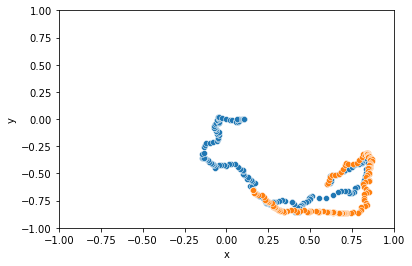

In [14]:
traj = load_trajectory("/home/leni/are-logs/mnipes2_27_9_10-4-10-72-2968550977/traj_16_0")
traj_2 = load_trajectory("/home/leni/are-logs/visualization_28_9_11-16-36-6543-566279835/traj_3_0")
data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
data_2 = pd.DataFrame(data=traj_2,columns=["time_step","x","y","z"])

ax = sns.scatterplot(data=data,x="x",y="y")
ax = sns.scatterplot(data=data_2,x="x",y="y")
ax.set_ylim([-1,1])
ax.set_xlim([-1,1])
plt.show()

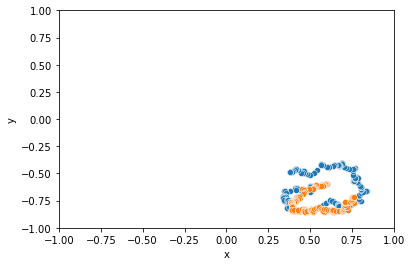

In [11]:
traj = load_trajectory("/home/leni/are-logs/mnipes2_27_9_10-4-10-72-2968550977/traj_6_0")
traj_2 = load_trajectory("/home/leni/are-logs/visualization_28_9_10-47-32-2359-3976109258//traj_3_0")
data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
data_2 = pd.DataFrame(data=traj_2,columns=["time_step","x","y","z"])

ax = sns.scatterplot(data=data,x="x",y="y")
ax = sns.scatterplot(data=data_2,x="x",y="y")
ax.set_ylim([-1,1])
ax.set_xlim([-1,1])
plt.show()

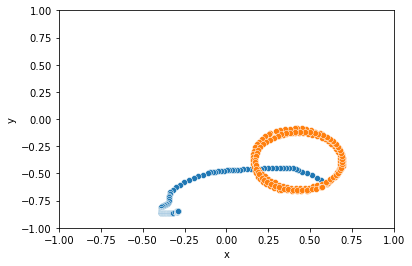

In [18]:
traj = load_trajectory("/home/leni/are-logs/mnipes2_27_9_10-4-10-72-2968550977/traj_95_0")
traj_2 = load_trajectory("/home/leni/are-logs/visualization_28_9_15-19-43-3266-1318586220//traj_3_0")
data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
data_2 = pd.DataFrame(data=traj_2,columns=["time_step","x","y","z"])

ax = sns.scatterplot(data=data,x="x",y="y")
ax = sns.scatterplot(data=data_2,x="x",y="y")
ax.set_ylim([-1,1])
ax.set_xlim([-1,1])
plt.show()

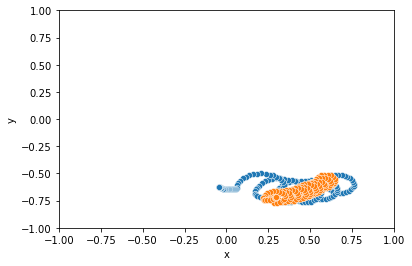

In [20]:
traj = load_trajectory("/home/leni/are-logs/mnipes2_27_9_10-4-10-72-2968550977/traj_164_0")
traj_2 = load_trajectory("/home/leni/are-logs/visualization_28_9_15-29-56-6182-4159840815/traj_3_0")
data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
data_2 = pd.DataFrame(data=traj_2,columns=["time_step","x","y","z"])

ax = sns.scatterplot(data=data,x="x",y="y")
ax = sns.scatterplot(data=data_2,x="x",y="y")
ax.set_ylim([-1,1])
ax.set_xlim([-1,1])
plt.show()

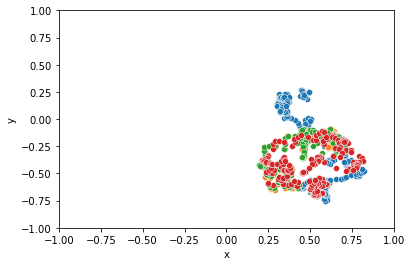

In [12]:
traj = load_trajectory("/home/leni/are-logs/mnipes2_31_9_11-50-36-6271-156170829/traj_8_0")
traj_2 = load_trajectory("/home/leni/are-logs/visualization_31_9_16-52-4-4165-1795554433/traj_3_0")
traj_3 = load_trajectory("/home/leni/are-logs/visualization_31_9_16-54-45-5673-3437627630/traj_3_0")
traj_4 = load_trajectory("/home/leni/are-logs/visualization_31_9_16-57-58-8299-620921330/traj_3_0")

data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
data_2 = pd.DataFrame(data=traj_2,columns=["time_step","x","y","z"])
data_3 = pd.DataFrame(data=traj_3,columns=["time_step","x","y","z"])
data_4 = pd.DataFrame(data=traj_4,columns=["time_step","x","y","z"])
ax = sns.scatterplot(data=data,x="x",y="y")
ax = sns.scatterplot(data=data_2,x="x",y="y")
ax = sns.scatterplot(data=data_3,x="x",y="y")
ax = sns.scatterplot(data=data_4,x="x",y="y")
ax.set_ylim([-1,1])
ax.set_xlim([-1,1])
plt.show()

## Diversity

In [5]:
desc_lines = []
organ_lines = []
exp_folder = "/home/leni/are-logs/mnipes2_exploration_sept_22/"
for folder in os.listdir(exp_folder):
    descriptors = load_descriptor(exp_folder + folder + "/morph_descriptors.csv")
    for desc in descriptors:
        desc_lines.append([desc[0],desc[5]*16,desc[6]*16,desc[7]*16])
wheels = [0 for _ in range(16)]
sensors = [0 for _ in range(16)]
joints = [0 for _ in range(16)]

total=0
for desc in desc_lines:
        wheels[int(desc[1])]+=1
        sensors[int(desc[2])]+=1
        joints[int(desc[3])]+=1
        total+=1

for i in range(len(wheels)):
    wheels[i]=wheels[i]/total*100
    sensors[i]=sensors[i]/total*100
    joints[i]=sensors[i]/total*100


for i,w in zip(range(len(wheels)),wheels):
    organ_lines.append([str(i),w,"wheels","baseline"])
for i,s in zip(range(len(sensors)),sensors):
    organ_lines.append([str(i),s,"sensors","baseline"])
for i,s in zip(range(len(sensors)),joints):
    organ_lines.append([str(i),s,"joints","baseline"])

<Figure size 360x360 with 0 Axes>

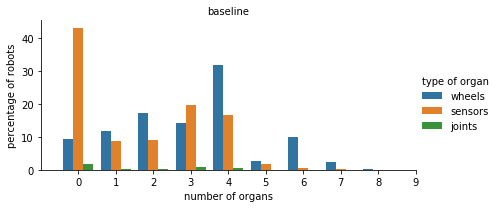

In [6]:
fig = plt.gcf()
fig.set_size_inches(5, 5)
organs_data = pd.DataFrame(data=organ_lines,columns=["number of organs","percentage of robots","type of organ","variant"])
g=sns.catplot(data=organs_data,x="number of organs",y="percentage of robots",hue="type of organ",col="variant",kind='bar',col_wrap=1,aspect=2,height=3)
(g.set_titles("{col_name}")
  .set(xlim=(-1, 9))) 

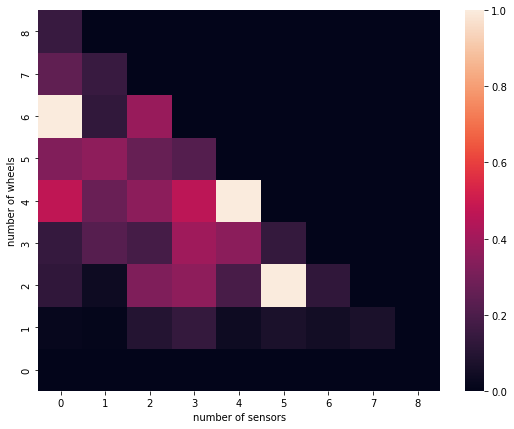

In [14]:
exp_folder = "/home/leni/are-logs/mnipes2_exploration_sept_22/"
list_data = []
for folder in os.listdir(exp_folder):
    list_data.append(load_controller_archive(exp_folder + "/" + folder + "/controller_archive"))

data = pd.concat(list_data,ignore_index=True)
data = data.groupby(["number of wheels","number of sensors"]).max().squeeze().unstack()
#data = data.pivot(index="number of wheels",columns="number of sensors",values="fitness")
fig = plt.gcf()
fig.set_size_inches(9, 7)
ax = sns.heatmap(data,vmin=0,vmax=1)
ax.set_ylim([0,9])
ax.set_xlim([0,9])
plt.show()

# Exploration Side Obstacles

## Quality

mnipes2_31_9_11-53-3-3763-1834763126 [[137.0, 21.0], [44.0, 20.0], [115.0, 19.0], [191.0, 17.0], [155.0, 16.0]]
mnipes2_31_9_11-53-4-4010-612257325 [[182.0, 23.0], [186.0, 20.0], [84.0, 19.0], [147.0, 18.0], [159.0, 17.0]]
mnipes2_31_9_11-50-43-3128-834807459 [[176.0, 19.0], [89.0, 16.0], [66.0, 16.0], [8.0, 16.0], [102.0, 15.0]]
mnipes2_31_9_11-50-36-6271-156170829 [[220.0, 35.821376], [73.0, 16.0], [102.0, 16.0], [92.0, 15.0], [177.0, 15.0]]
mnipes2_31_9_11-50-43-3129-528987212 [[165.0, 21.0], [83.0, 20.0], [155.0, 20.0], [156.0, 20.0], [108.0, 20.0]]
5


/home/leni/.local/lib/python3.8/site-packages/seaborn/categorical.py:1296: UserWarning: 7.2% of the points cannot be placed; you may want to decrease the size of the markers or use stripplot.
  warnings.warn(msg, UserWarning)


(0, 0.6)

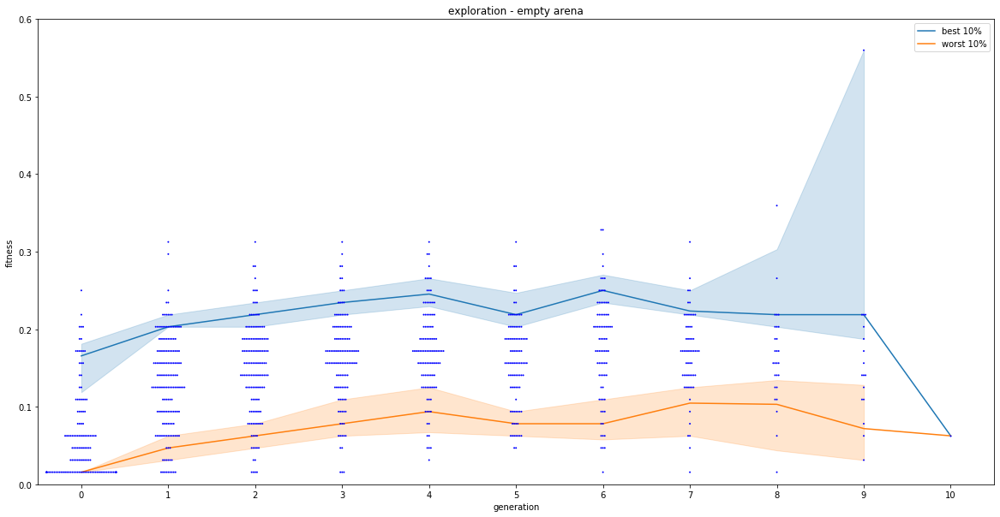

In [33]:
from operator import itemgetter
exp_folder = "/home/leni/are-logs/mnipes2_exploration_1/side/"
lines = []
i = 0
best_inds = dict()
beh_descriptors = dict()
morph_descriptors = dict()
for folder in os.listdir(exp_folder):
    i+=1
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    indexes = np.argsort(np.array(fitnesses))
    best_inds[folder] = [[ids[indexes[-i]],fitnesses[indexes[-i]]*64] for i in range(1,6)]
    print(folder,best_inds[folder])
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([_id,fit,gen])
  
    morph_desc = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")
    morph_descriptors[folder] = dict()
    for desc in morph_desc:
        morph_descriptors[folder][desc[0]] = desc[1:]
print(i)
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("exploration - empty arena")
ax.set_ylim([0,0.6])

mnipes2_31_9_11-53-3-3763-1834763126
wheels,sensor,joint,caster
4.0 3.0 0.0 0.0


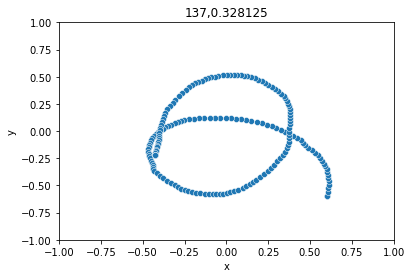

mnipes2_31_9_11-53-3-3763-1834763126
wheels,sensor,joint,caster
4.0 3.0 0.0 0.0


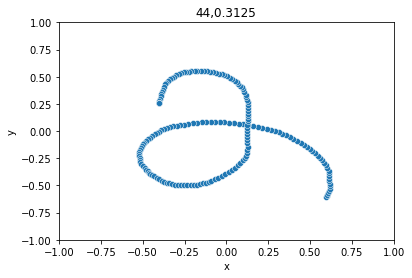

mnipes2_31_9_11-53-3-3763-1834763126
wheels,sensor,joint,caster
4.0 3.0 0.0 0.0


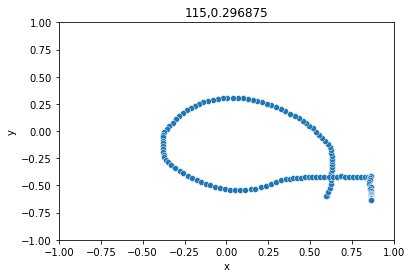

mnipes2_31_9_11-53-3-3763-1834763126
wheels,sensor,joint,caster
6.0 0.0 2.0 0.0


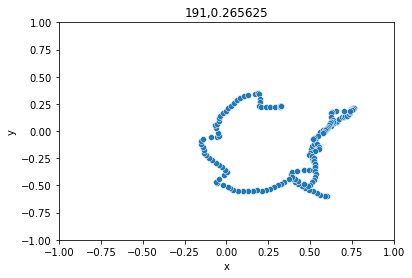

mnipes2_31_9_11-53-3-3763-1834763126
wheels,sensor,joint,caster
3.0 2.0 4.0 0.0


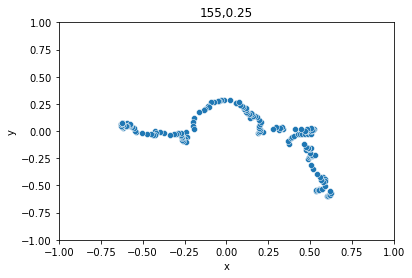

mnipes2_31_9_11-53-4-4010-612257325
wheels,sensor,joint,caster
4.0 3.0 2.0 0.0


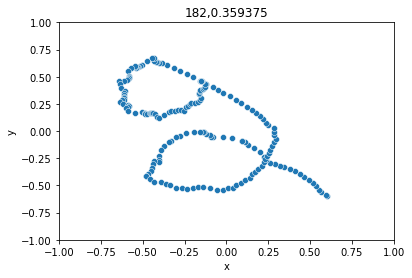

mnipes2_31_9_11-53-4-4010-612257325
wheels,sensor,joint,caster
4.0 2.0 2.0 0.0


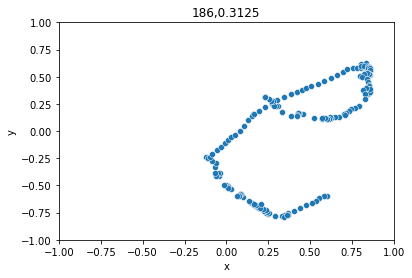

mnipes2_31_9_11-53-4-4010-612257325
wheels,sensor,joint,caster
5.0 2.0 0.0 0.0


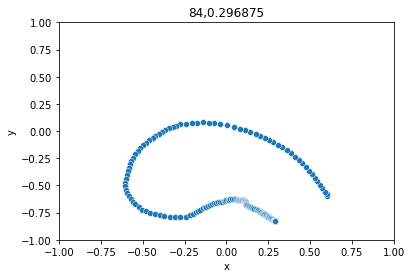

mnipes2_31_9_11-53-4-4010-612257325
wheels,sensor,joint,caster
4.0 3.0 2.0 0.0


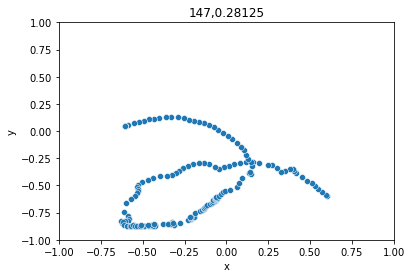

mnipes2_31_9_11-53-4-4010-612257325
wheels,sensor,joint,caster
4.0 2.0 2.0 0.0


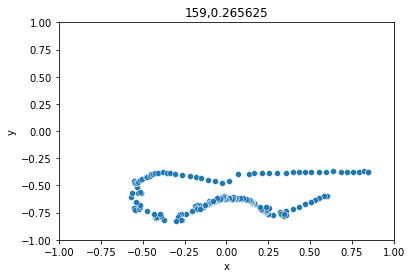

mnipes2_31_9_11-50-43-3128-834807459
wheels,sensor,joint,caster
4.0 1.0 4.0 0.0


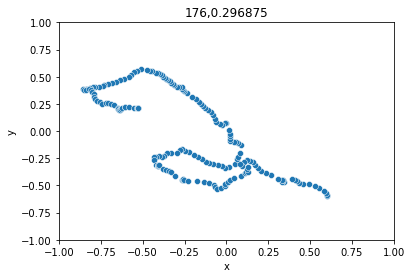

mnipes2_31_9_11-50-43-3128-834807459
wheels,sensor,joint,caster
3.0 3.0 4.0 0.0


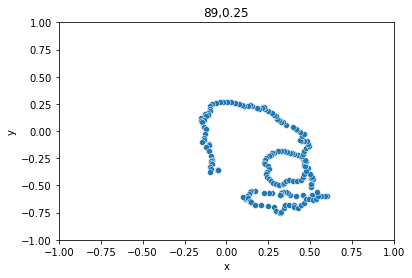

mnipes2_31_9_11-50-43-3128-834807459
wheels,sensor,joint,caster
2.0 4.0 4.0 0.0


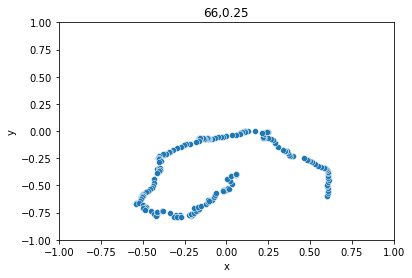

mnipes2_31_9_11-50-43-3128-834807459
wheels,sensor,joint,caster
3.0 3.0 4.0 0.0


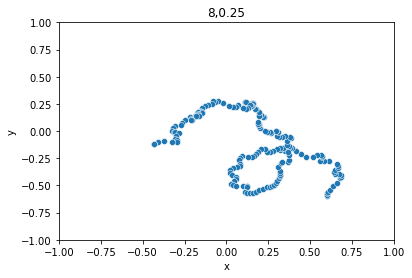

mnipes2_31_9_11-50-43-3128-834807459
wheels,sensor,joint,caster
3.0 3.0 4.0 0.0


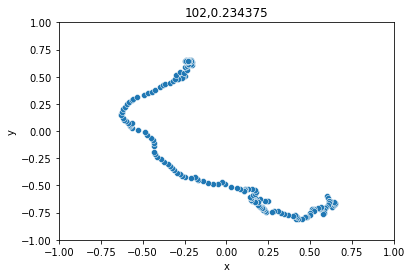

mnipes2_31_9_11-50-36-6271-156170829
wheels,sensor,joint,caster
6.0 0.0 2.0 0.0
mnipes2_31_9_11-50-36-6271-156170829
wheels,sensor,joint,caster
4.0 0.0 6.0 1.0


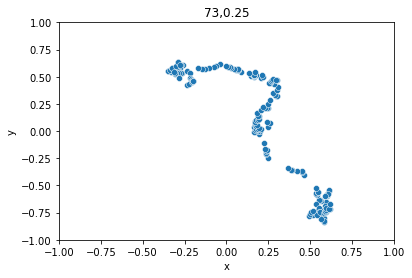

mnipes2_31_9_11-50-36-6271-156170829
wheels,sensor,joint,caster
6.0 0.0 4.0 0.0


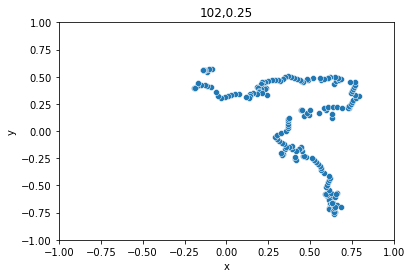

mnipes2_31_9_11-50-36-6271-156170829
wheels,sensor,joint,caster
5.0 0.0 6.0 0.0


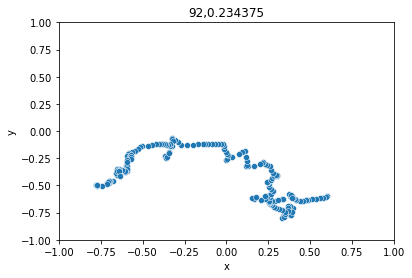

mnipes2_31_9_11-50-36-6271-156170829
wheels,sensor,joint,caster
5.0 0.0 6.0 0.0


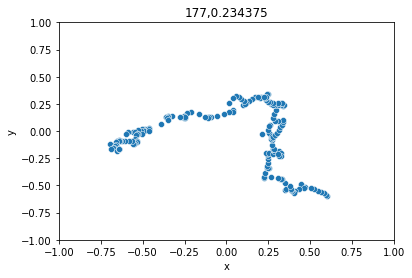

mnipes2_31_9_11-50-43-3129-528987212
wheels,sensor,joint,caster
5.0 1.0 2.0 0.0


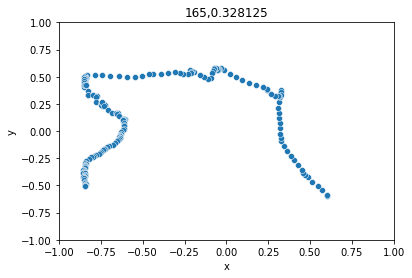

mnipes2_31_9_11-50-43-3129-528987212
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


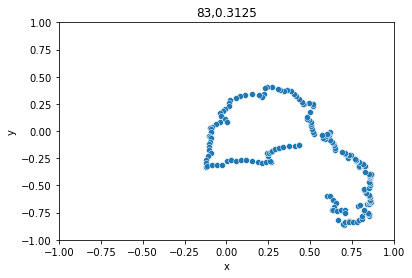

mnipes2_31_9_11-50-43-3129-528987212
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


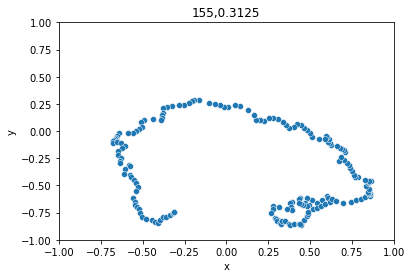

mnipes2_31_9_11-50-43-3129-528987212
wheels,sensor,joint,caster
5.0 1.0 2.0 0.0


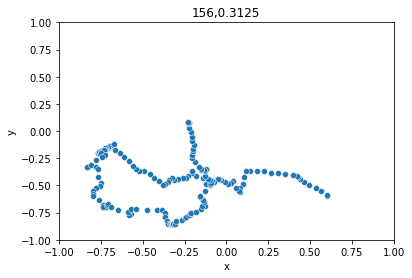

mnipes2_31_9_11-50-43-3129-528987212
wheels,sensor,joint,caster
5.0 1.0 2.0 0.0


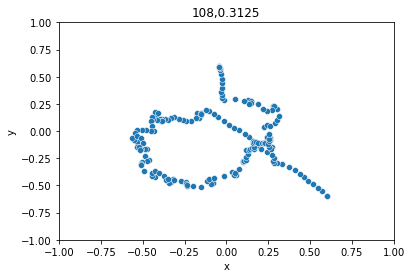

In [29]:
for folder, inds in best_inds.items():
    for fit in inds:
        print(folder)
   #     print(beh_descriptors[folder][int(fit[0])])
        print("wheels,sensor,joint,caster")
        print(morph_descriptors[folder][int(fit[0])][4]*16,morph_descriptors[folder][int(fit[0])][5]*16,morph_descriptors[folder][int(fit[0])][6]*16,morph_descriptors[folder][int(fit[0])][7]*16)
        
        #lines = []
       # for d in descriptors[folder][int(fit[0])]:
        #    lines.append([int(d[0]/8),int(d[0])%8,d[1]])
        #print(lines)
        #data_desc = pd.DataFrame(data=lines,columns=["y","x","dist"])
        #data_desc = data_desc.pivot("y","x","dist")
        if(not os.path.exists(exp_folder + "/" + folder + "/traj_" + str(int(fit[0])) + "_0")):
            continue
        traj = load_trajectory(exp_folder + "/" + folder + "/traj_" + str(int(fit[0])) + "_0")
        data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
        
        ax = sns.scatterplot(data=data,x="x",y="y")
        ax.set_ylim([-1,1])
        ax.set_xlim([-1,1])
        ax.set_title(str(int(fit[0])) + "," + str(fit[1]))
        plt.show()
        
        #ax = sns.heatmap(data_desc)
        #ax.set_xlim([0,7])
        #ax.set_ylim([0,7])
        
        #plt.show()
        

# Exploration Side Obstacles Hard

## Quality

mnipes2_1_10_16-1-31-1488-648673744 [[180.0, 18.0], [106.0, 16.0], [160.0, 16.0], [47.0, 16.0], [81.0, 16.0]]
mnipes2_1_10_16-1-34-4619-3117921717 [[172.0, 64.0], [79.0, 20.0], [147.0, 16.0], [126.0, 15.0], [68.0, 15.0]]
mnipes2_1_10_16-1-48-8091-1914053529 [[179.0, 64.0], [96.0, 18.0], [175.0, 18.0], [120.0, 17.0], [91.0, 16.0]]
mnipes2_1_10_16-1-40-125-2799366789 [[148.0, 17.0], [134.0, 17.0], [93.0, 16.0], [116.0, 16.0], [120.0, 15.0]]
mnipes2_1_10_16-1-52-2558-4174782421 [[248.0, 19.0], [175.0, 19.0], [207.0, 18.0], [218.0, 18.0], [104.0, 18.0]]


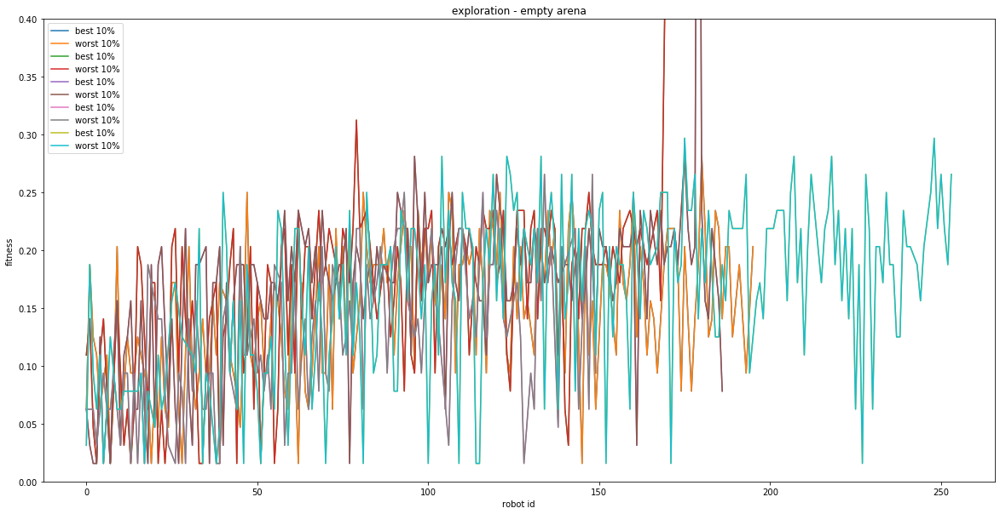

In [15]:
from operator import itemgetter
exp_folder = "/home/leni/are-logs/mnipes2_exploration_2/side_hard/"
lines = []
i = 0
best_inds = dict()
beh_descriptors = dict()
morph_descriptors = dict()
for folder in os.listdir(exp_folder):
    lines =[]
    i+=1
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    indexes = np.argsort(np.array(fitnesses))
    best_inds[folder] = [[ids[indexes[-i]],fitnesses[indexes[-i]]*64] for i in range(1,6)]
    print(folder,best_inds[folder])
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([_id,fit,gen])
  
    morph_desc = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")
    morph_descriptors[folder] = dict()
    for desc in morph_desc:
        morph_descriptors[folder][desc[0]] = desc[1:]

    data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
    data.drop_duplicates()
    fig = plt.gcf()
    fig.set_size_inches(20,10)
   # ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
    def perc(a):
        return np.percentile(a,q=90)
    ax = sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc_high,label="best 10%")
    sns.lineplot(data=data,x="robot id",y="fitness",estimator=perc_low,label="worst 10%")
    ax.set_title("exploration - empty arena")
    ax.set_ylim([0,0.4])
    plt.show

mnipes2_31_9_11-51-18-8315-1480072296
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


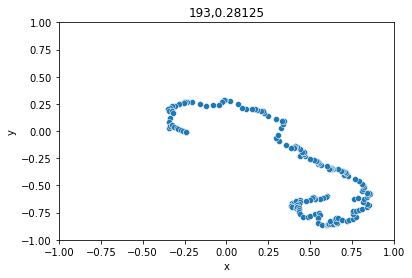

mnipes2_31_9_11-51-18-8315-1480072296
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


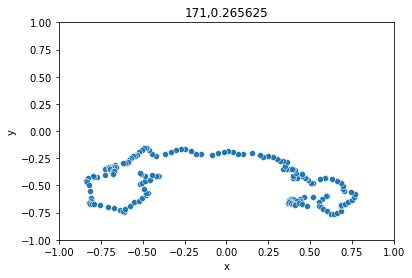

mnipes2_31_9_11-51-18-8315-1480072296
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


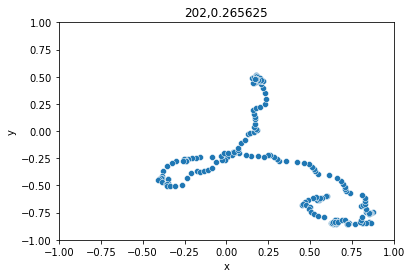

mnipes2_31_9_11-51-18-8315-1480072296
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


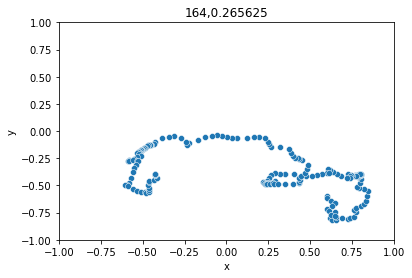

mnipes2_31_9_11-51-18-8315-1480072296
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


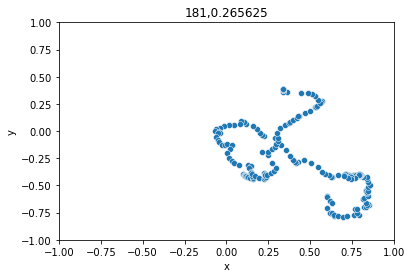

mnipes2_31_9_11-51-21-1321-644942751
wheels,sensor,joint,caster
3.0 0.0 4.0 1.0


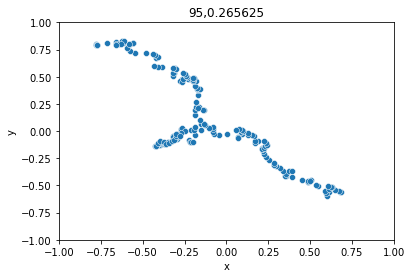

mnipes2_31_9_11-51-21-1321-644942751
wheels,sensor,joint,caster
1.0 4.0 6.0 0.0


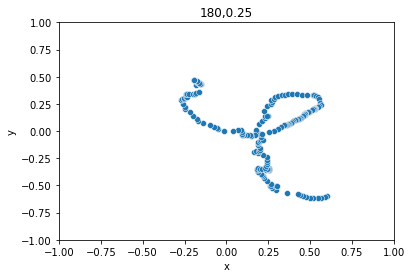

mnipes2_31_9_11-51-21-1321-644942751
wheels,sensor,joint,caster
3.0 0.0 4.0 1.0


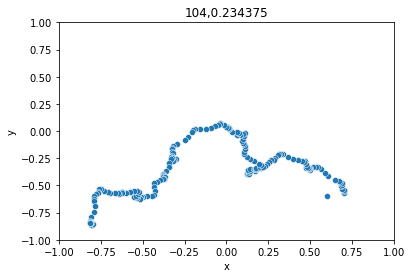

mnipes2_31_9_11-51-21-1321-644942751
wheels,sensor,joint,caster
2.0 0.0 4.0 4.0


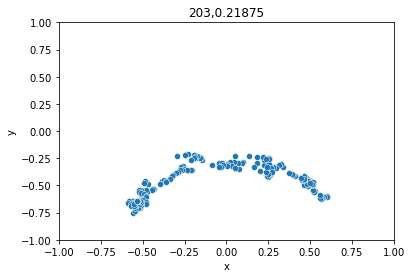

mnipes2_31_9_11-51-21-1321-644942751
wheels,sensor,joint,caster
3.0 2.0 4.0 0.0


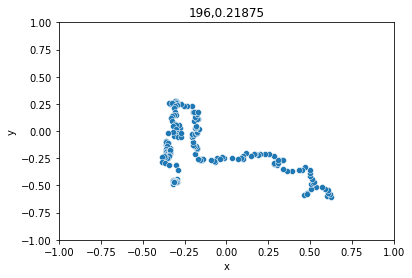

mnipes2_31_9_11-51-21-1327-3642891666
wheels,sensor,joint,caster
3.0 2.0 2.0 1.0


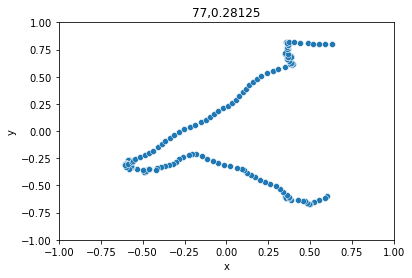

mnipes2_31_9_11-51-21-1327-3642891666
wheels,sensor,joint,caster
3.0 2.0 2.0 1.0


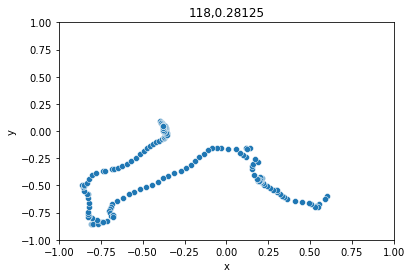

mnipes2_31_9_11-51-21-1327-3642891666
wheels,sensor,joint,caster
3.0 2.0 2.0 1.0


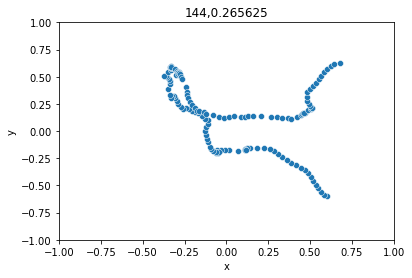

mnipes2_31_9_11-51-21-1327-3642891666
wheels,sensor,joint,caster
3.0 2.0 2.0 1.0


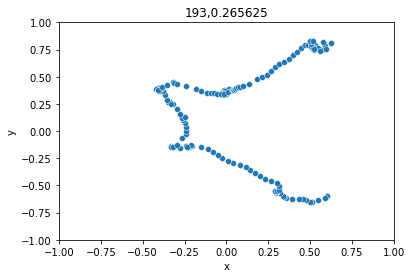

mnipes2_31_9_11-51-21-1327-3642891666
wheels,sensor,joint,caster
3.0 2.0 2.0 1.0


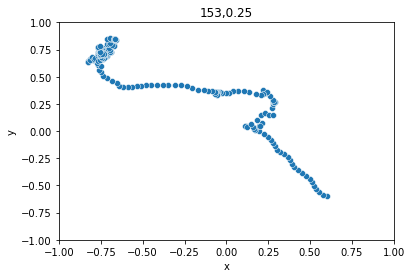

In [31]:
for folder, inds in best_inds.items():
    for fit in inds:
        print(folder)
   #     print(beh_descriptors[folder][int(fit[0])])
        print("wheels,sensor,joint,caster")
        print(morph_descriptors[folder][int(fit[0])][4]*16,morph_descriptors[folder][int(fit[0])][5]*16,morph_descriptors[folder][int(fit[0])][6]*16,morph_descriptors[folder][int(fit[0])][7]*16)
        
        #lines = []
       # for d in descriptors[folder][int(fit[0])]:
        #    lines.append([int(d[0]/8),int(d[0])%8,d[1]])
        #print(lines)
        #data_desc = pd.DataFrame(data=lines,columns=["y","x","dist"])
        #data_desc = data_desc.pivot("y","x","dist")
        if(not os.path.exists(exp_folder + "/" + folder + "/traj_" + str(int(fit[0])) + "_0")):
            continue
        traj = load_trajectory(exp_folder + "/" + folder + "/traj_" + str(int(fit[0])) + "_0")
        data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
        
        ax = sns.scatterplot(data=data,x="x",y="y")
        ax.set_ylim([-1,1])
        ax.set_xlim([-1,1])
        ax.set_title(str(int(fit[0])) + "," + str(fit[1]))
        plt.show()
        
        #ax = sns.heatmap(data_desc)
        #ax.set_xlim([0,7])
        #ax.set_ylim([0,7])
        
        #plt.show()
        

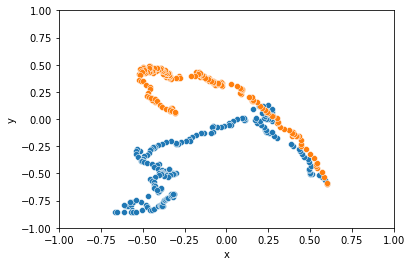

In [4]:
traj = load_trajectory("/home/leni/are-logs/mnipes2_exploration_2/side_hard/mnipes2_1_10_16-1-31-1488-648673744/traj_47_0")
traj_2 = load_trajectory("/home/leni/are-logs/visualization_3_10_17-11-0-113-1308080901/")
data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
data_2 = pd.DataFrame(data=traj_2,columns=["time_step","x","y","z"])

ax = sns.scatterplot(data=data,x="x",y="y")
ax = sns.scatterplot(data=data_2,x="x",y="y")
ax.set_ylim([-1,1])
ax.set_xlim([-1,1])
plt.show()

# Exploration Maze

## Quality

mnipes2_31_9_11-50-56-6260-2502997226 [[117.0, 15.0], [131.0, 15.0], [145.0, 15.0], [121.0, 14.0], [152.0, 14.0]]
mnipes2_31_9_11-51-0-884-1057712645 [[205.0, 53.173376], [115.0, 21.0], [204.0, 20.0], [113.0, 19.0], [169.0, 18.0]]
mnipes2_31_9_11-51-2-2284-3218377484 [[160.0, 18.0], [182.0, 17.0], [194.0, 17.0], [63.0, 17.0], [215.0, 16.0]]
mnipes2_31_9_11-51-2-2281-3786437956 [[67.0, 16.0], [77.0, 15.0], [47.0, 14.0], [183.0, 14.0], [182.0, 14.0]]
4


(0, 0.6)

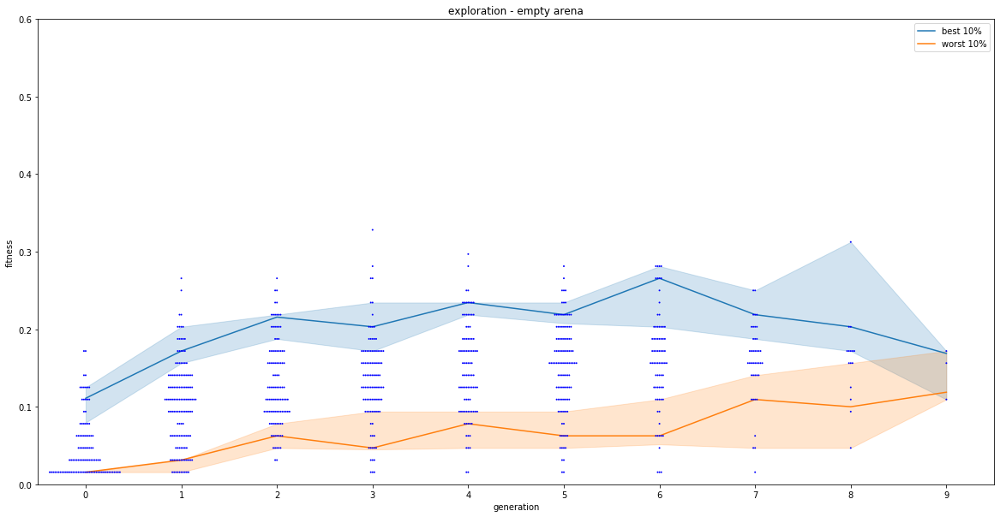

In [34]:
from operator import itemgetter
exp_folder = "/home/leni/are-logs/mnipes2_exploration_1/maze/"
lines = []
i = 0
best_inds = dict()
beh_descriptors = dict()
morph_descriptors = dict()
for folder in os.listdir(exp_folder):
    i+=1
    ids, fitnesses, parents = load_fitness(exp_folder + "/" + folder + "/fitnesses.csv")
    indexes = np.argsort(np.array(fitnesses))
    best_inds[folder] = [[ids[indexes[-i]],fitnesses[indexes[-i]]*64] for i in range(1,6)]
    print(folder,best_inds[folder])
    generation = compute_generation(ids,parents)
    for _id, fit, gen in zip(ids,fitnesses,generation):
        lines.append([_id,fit,gen])
  
    morph_desc = load_descriptor(exp_folder + "/" + folder + "/morph_descriptors.csv")
    morph_descriptors[folder] = dict()
    for desc in morph_desc:
        morph_descriptors[folder][desc[0]] = desc[1:]
print(i)
data = pd.DataFrame(data=lines,columns=["robot id","fitness","generation"]) 
data.drop_duplicates()
fig = plt.gcf()
fig.set_size_inches(20,10)
ax = sns.swarmplot(data=data,x="generation",y="fitness",size=2,color='b')
def perc(a):
    return np.percentile(a,q=90)
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_high,label="best 10%")
sns.lineplot(data=data,x="generation",y="fitness",estimator=perc_low,label="worst 10%")
ax.set_title("exploration - empty arena")
ax.set_ylim([0,0.6])

mnipes2_31_9_11-50-56-6260-2502997226
wheels,sensor,joint,caster
2.0 3.0 6.0 0.0


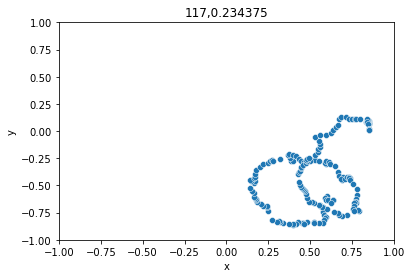

mnipes2_31_9_11-50-56-6260-2502997226
wheels,sensor,joint,caster
2.0 6.0 0.0 0.0


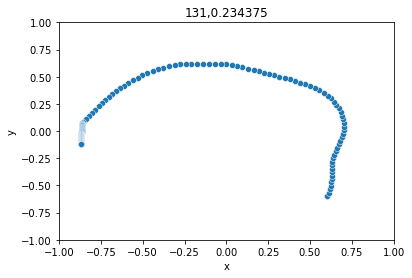

mnipes2_31_9_11-50-56-6260-2502997226
wheels,sensor,joint,caster
2.0 3.0 6.0 0.0


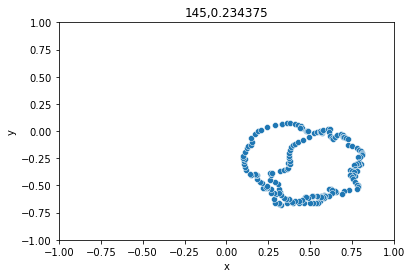

mnipes2_31_9_11-50-56-6260-2502997226
wheels,sensor,joint,caster
1.0 4.0 4.0 0.0


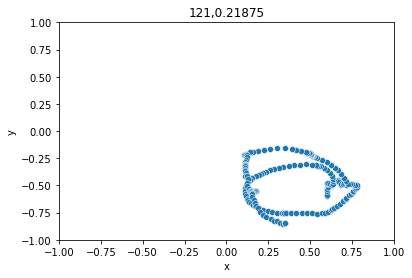

mnipes2_31_9_11-50-56-6260-2502997226
wheels,sensor,joint,caster
2.0 3.0 4.0 0.0


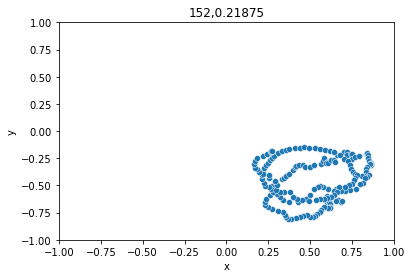

mnipes2_31_9_11-51-0-884-1057712645
wheels,sensor,joint,caster
5.0 0.0 6.0 0.0
mnipes2_31_9_11-51-0-884-1057712645
wheels,sensor,joint,caster
5.0 0.0 4.0 0.0


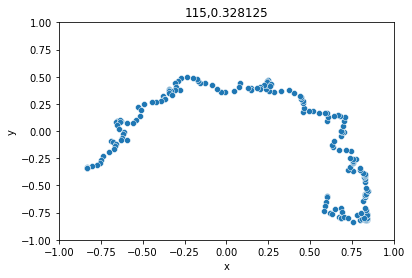

mnipes2_31_9_11-51-0-884-1057712645
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


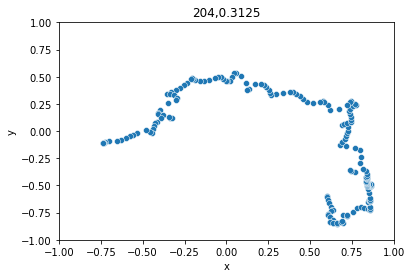

mnipes2_31_9_11-51-0-884-1057712645
wheels,sensor,joint,caster
5.0 0.0 4.0 0.0


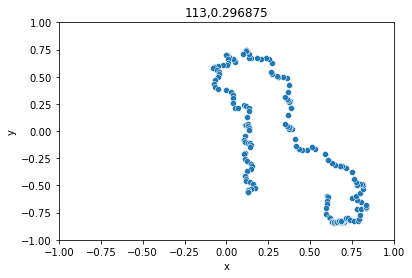

mnipes2_31_9_11-51-0-884-1057712645
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


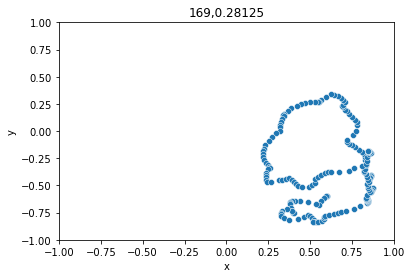

mnipes2_31_9_11-51-2-2284-3218377484
wheels,sensor,joint,caster
4.0 0.0 6.0 0.0


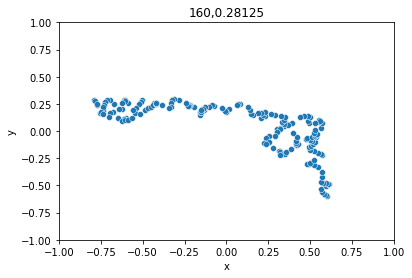

mnipes2_31_9_11-51-2-2284-3218377484
wheels,sensor,joint,caster
3.0 1.0 6.0 0.0


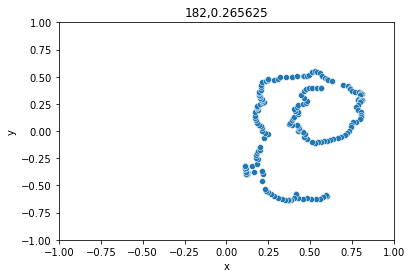

mnipes2_31_9_11-51-2-2284-3218377484
wheels,sensor,joint,caster
4.0 0.0 4.0 0.0


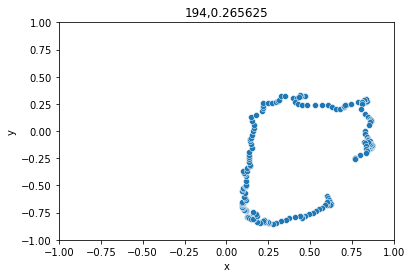

mnipes2_31_9_11-51-2-2284-3218377484
wheels,sensor,joint,caster
3.0 0.0 8.0 0.0


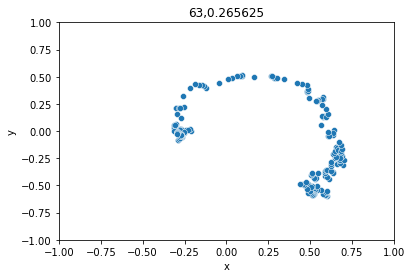

mnipes2_31_9_11-51-2-2284-3218377484
wheels,sensor,joint,caster
2.0 1.0 8.0 0.0


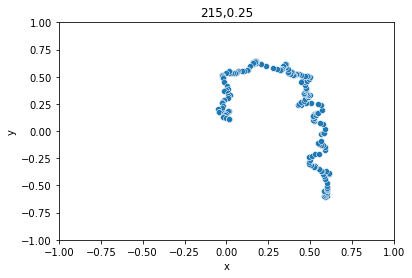

mnipes2_31_9_11-51-2-2281-3786437956
wheels,sensor,joint,caster
2.0 0.0 4.0 3.0


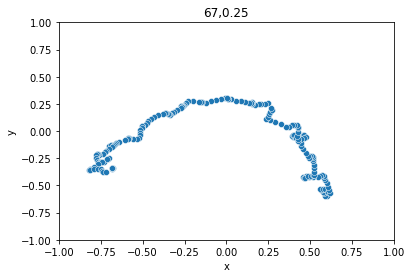

mnipes2_31_9_11-51-2-2281-3786437956
wheels,sensor,joint,caster
2.0 0.0 4.0 3.0


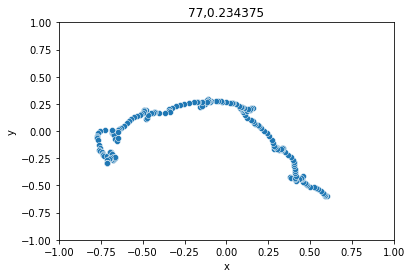

mnipes2_31_9_11-51-2-2281-3786437956
wheels,sensor,joint,caster
2.0 0.0 4.0 3.0


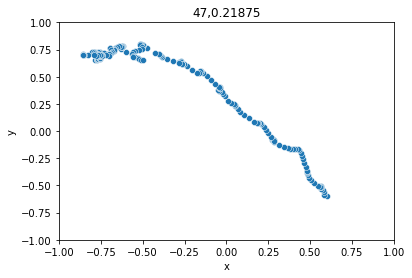

mnipes2_31_9_11-51-2-2281-3786437956
wheels,sensor,joint,caster
3.0 0.0 2.0 3.0


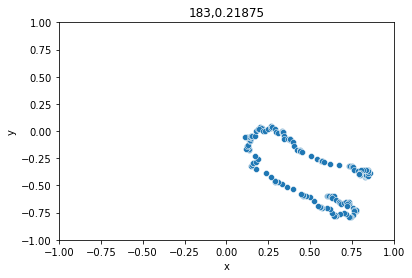

mnipes2_31_9_11-51-2-2281-3786437956
wheels,sensor,joint,caster
3.0 0.0 2.0 3.0


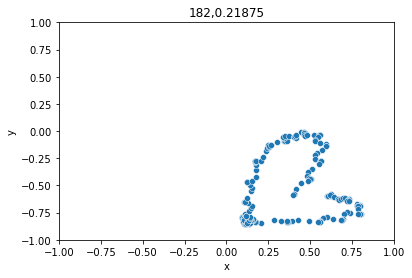

In [26]:
for folder, inds in best_inds.items():
    for fit in inds:
        print(folder)
   #     print(beh_descriptors[folder][int(fit[0])])
        print("wheels,sensor,joint,caster")
        print(morph_descriptors[folder][int(fit[0])][4]*16,morph_descriptors[folder][int(fit[0])][5]*16,morph_descriptors[folder][int(fit[0])][6]*16,morph_descriptors[folder][int(fit[0])][7]*16)
        
        #lines = []
       # for d in descriptors[folder][int(fit[0])]:
        #    lines.append([int(d[0]/8),int(d[0])%8,d[1]])
        #print(lines)
        #data_desc = pd.DataFrame(data=lines,columns=["y","x","dist"])
        #data_desc = data_desc.pivot("y","x","dist")
        if(not os.path.exists(exp_folder + "/" + folder + "/traj_" + str(int(fit[0])) + "_0")):
            continue
        traj = load_trajectory(exp_folder + "/" + folder + "/traj_" + str(int(fit[0])) + "_0")
        data = pd.DataFrame(data=traj,columns=["time_step","x","y","z"])
        
        ax = sns.scatterplot(data=data,x="x",y="y")
        ax.set_ylim([-1,1])
        ax.set_xlim([-1,1])
        ax.set_title(str(int(fit[0])) + "," + str(fit[1]))
        plt.show()
        
        #ax = sns.heatmap(data_desc)
        #ax.set_xlim([0,7])
        #ax.set_ylim([0,7])
        
        #plt.show()
        